# Deep Convolutional GANs

In this notebook, you'll build a GAN using convolutional layers in the generator and discriminator. This is called a Deep Convolutional GAN, or DCGAN for short. The DCGAN architecture was first explored last year and has seen impressive results in generating new images, you can read the [original paper here](https://arxiv.org/pdf/1511.06434.pdf).

You'll be training DCGAN on the [Street View House Numbers](http://ufldl.stanford.edu/housenumbers/) (SVHN) dataset. These are color images of house numbers collected from Google street view. SVHN images are in color and much more variable than MNIST. 

![SVHN Examples](assets/SVHN_examples.png)

So, we'll need a deeper and more powerful network. This is accomplished through using convolutional layers in the discriminator and generator. It's also necessary to use batch normalization to get the convolutional networks to train. The only real changes compared to what [you saw previously](https://github.com/udacity/deep-learning/tree/master/gan_mnist) are in the generator and discriminator, otherwise the rest of the implementation is the same.

In [1]:
%matplotlib inline

import pickle as pkl

import matplotlib.pyplot as plt
import numpy as np
from scipy.io import loadmat
import tensorflow as tf

In [2]:
!mkdir data

mkdir: cannot create directory ‘data’: File exists


## Getting the data

Here you can download the SVHN dataset. Run the cell above and it'll download to your machine.

In [3]:
from urllib.request import urlretrieve
from os.path import isfile, isdir
from tqdm import tqdm

data_dir = 'data/'

if not isdir(data_dir):
    raise Exception("Data directory doesn't exist!")

class DLProgress(tqdm):
    last_block = 0

    def hook(self, block_num=1, block_size=1, total_size=None):
        self.total = total_size
        self.update((block_num - self.last_block) * block_size)
        self.last_block = block_num

if not isfile(data_dir + "train_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Training Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/train_32x32.mat',
            data_dir + 'train_32x32.mat',
            pbar.hook)

if not isfile(data_dir + "test_32x32.mat"):
    with DLProgress(unit='B', unit_scale=True, miniters=1, desc='SVHN Testing Set') as pbar:
        urlretrieve(
            'http://ufldl.stanford.edu/housenumbers/test_32x32.mat',
            data_dir + 'test_32x32.mat',
            pbar.hook)

SVHN Training Set: 182MB [00:40, 4.45MB/s]                              
SVHN Testing Set: 64.3MB [00:16, 3.83MB/s]                            


These SVHN files are `.mat` files typically used with Matlab. However, we can load them in with `scipy.io.loadmat` which we imported above.

In [4]:
trainset = loadmat(data_dir + 'train_32x32.mat')
testset = loadmat(data_dir + 'test_32x32.mat')

Here I'm showing a small sample of the images. Each of these is 32x32 with 3 color channels (RGB). These are the real images we'll pass to the discriminator and what the generator will eventually fake.

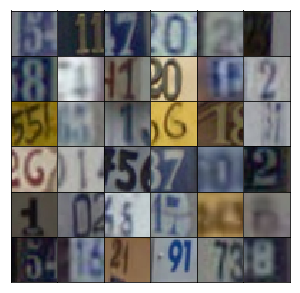

In [5]:
idx = np.random.randint(0, trainset['X'].shape[3], size=36)
fig, axes = plt.subplots(6, 6, sharex=True, sharey=True, figsize=(5,5),)
for ii, ax in zip(idx, axes.flatten()):
    ax.imshow(trainset['X'][:,:,:,ii], aspect='equal')
    ax.xaxis.set_visible(False)
    ax.yaxis.set_visible(False)
plt.subplots_adjust(wspace=0, hspace=0)

Here we need to do a bit of preprocessing and getting the images into a form where we can pass batches to the network. First off, we need to rescale the images to a range of -1 to 1, since the output of our generator is also in that range. We also have a set of test and validation images which could be used if we're trying to identify the numbers in the images.

In [6]:
def scale(x, feature_range=(-1, 1)):
    # scale to (0, 1)
    x = ((x - x.min())/(255 - x.min()))
    
    # scale to feature_range
    min, max = feature_range
    x = x * (max - min) + min
    return x

In [7]:
class Dataset:
    def __init__(self, train, test, val_frac=0.5, shuffle=False, scale_func=None):
        split_idx = int(len(test['y'])*(1 - val_frac))
        self.test_x, self.valid_x = test['X'][:,:,:,:split_idx], test['X'][:,:,:,split_idx:]
        self.test_y, self.valid_y = test['y'][:split_idx], test['y'][split_idx:]
        self.train_x, self.train_y = train['X'], train['y']
        
        self.train_x = np.rollaxis(self.train_x, 3)
        self.valid_x = np.rollaxis(self.valid_x, 3)
        self.test_x = np.rollaxis(self.test_x, 3)
        
        if scale_func is None:
            self.scaler = scale
        else:
            self.scaler = scale_func
        self.shuffle = shuffle
        
    def batches(self, batch_size):
        if self.shuffle:
            idx = np.arange(len(dataset.train_x))
            np.random.shuffle(idx)
            self.train_x = self.train_x[idx]
            self.train_y = self.train_y[idx]
        
        n_batches = len(self.train_y)//batch_size
        for ii in range(0, len(self.train_y), batch_size):
            x = self.train_x[ii:ii+batch_size]
            y = self.train_y[ii:ii+batch_size]
            
            yield self.scaler(x), y

## Network Inputs

Here, just creating some placeholders like normal.

In [8]:
def model_inputs(real_dim, z_dim):
    inputs_real = tf.placeholder(tf.float32, (None, *real_dim), name='input_real')
    inputs_z = tf.placeholder(tf.float32, (None, z_dim), name='input_z')
    
    return inputs_real, inputs_z

## Generator

Here you'll build the generator network. The input will be our noise vector `z` as before. Also as before, the output will be a $tanh$ output, but this time with size 32x32 which is the size of our SVHN images.

What's new here is we'll use convolutional layers to create our new images. The first layer is a fully connected layer which is reshaped into a deep and narrow layer, something like 4x4x1024 as in the original DCGAN paper. Then we use batch normalization and a leaky ReLU activation. Next is a transposed convolution where typically you'd halve the depth and double the width and height of the previous layer. Again, we use batch normalization and leaky ReLU. For each of these layers, the general scheme is convolution > batch norm > leaky ReLU.

You keep stacking layers up like this until you get the final transposed convolution layer with shape 32x32x3. Below is the archicture used in the original DCGAN paper:

![DCGAN Generator](assets/dcgan.png)

Note that the final layer here is 64x64x3, while for our SVHN dataset, we only want it to be 32x32x3. 

>**Exercise:** Build the transposed convolutional network for the generator in the function below. Be sure to use leaky ReLUs on all the layers except for the last tanh layer, as well as batch normalization on all the transposed convolutional layers except the last one.

In [9]:
def generator(z, output_dim, reuse=False, alpha=0.2, training=True):
    with tf.variable_scope('generator', reuse=reuse):
        # First fully connected layer
        x1 = tf.layers.dense(z, 4* 4 * 512)
        x1 = tf.reshape(x1, (-1, 4, 4, 512))
        x1 = tf.layers.batch_normalization(x1, training=training)
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d_transpose(x1, 256, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=training)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d_transpose(x2, 128, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=training)
        x3 = tf.maximum(alpha * x3, x3)
        
        # Output layer, 32x32x3
        logits = tf.layers.conv2d_transpose(x3, output_dim, 5, strides=2, padding='same')
        
        out = tf.tanh(logits)
        
        return out

## Discriminator

Here you'll build the discriminator. This is basically just a convolutional classifier like you've built before. The input to the discriminator are 32x32x3 tensors/images. You'll want a few convolutional layers, then a fully connected layer for the output. As before, we want a sigmoid output, and you'll need to return the logits as well. For the depths of the convolutional layers I suggest starting with 16, 32, 64 filters in the first layer, then double the depth as you add layers. Note that in the DCGAN paper, they did all the downsampling using only strided convolutional layers with no maxpool layers.

You'll also want to use batch normalization with `tf.layers.batch_normalization` on each layer except the first convolutional and output layers. Again, each layer should look something like convolution > batch norm > leaky ReLU.

Note: in this project, your batch normalization layers will always use batch statistics. (That is, always set `training` to `True`.) That's because we are only interested in using the discriminator to help train the generator. However, if you wanted to use the discriminator for inference later, then you would need to set the `training` parameter appropriately.

>**Exercise:** Build the convolutional network for the discriminator. The input is a 32x32x3 images, the output is a sigmoid plus the logits. Again, use Leaky ReLU activations and batch normalization on all the layers except the first.

In [10]:
def discriminator(x, reuse=False, alpha=0.2):
    with tf.variable_scope('discriminator', reuse=reuse):
        # Input layer is 32x32x3
        x1 = tf.layers.conv2d(x, 64, 5, strides=2, padding='same')
        x1 = tf.maximum(alpha * x1, x1)
        
        x2 = tf.layers.conv2d(x1, 128, 5, strides=2, padding='same')
        x2 = tf.layers.batch_normalization(x2, training=True)
        x2 = tf.maximum(alpha * x2, x2)
        
        x3 = tf.layers.conv2d(x2, 256, 5, strides=2, padding='same')
        x3 = tf.layers.batch_normalization(x3, training=True)
        x3 = tf.maximum(alpha * x3, x3)
        
        flat = tf.reshape(x3, (-1, 4 * 4 * 256))
        logits = tf.layers.dense(flat, 1)
        out = tf.sigmoid(logits)
        
        return out, logits

## Model Loss

Calculating the loss like before, nothing new here.

In [11]:
def model_loss(input_real, input_z, output_dim, alpha=0.2):
    """
    Get the loss for the discriminator and generator
    :param input_real: Images from the real dataset
    :param input_z: Z input
    :param out_channel_dim: The number of channels in the output image
    :return: A tuple of (discriminator loss, generator loss)
    """
    g_model = generator(input_z, output_dim, alpha=alpha)
    d_model_real, d_logits_real = discriminator(input_real, alpha=alpha)
    d_model_fake, d_logits_fake = discriminator(g_model, reuse=True, alpha=alpha)

    d_loss_real = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_real, labels=tf.ones_like(d_model_real)))
    d_loss_fake = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.zeros_like(d_model_fake)))
    g_loss = tf.reduce_mean(
        tf.nn.sigmoid_cross_entropy_with_logits(logits=d_logits_fake, labels=tf.ones_like(d_model_fake)))

    d_loss = d_loss_real + d_loss_fake

    return d_loss, g_loss

## Optimizers

Not much new here, but notice how the train operations are wrapped in a `with tf.control_dependencies` block so the batch normalization layers can update their population statistics.

In [12]:
def model_opt(d_loss, g_loss, learning_rate, beta1):
    """
    Get optimization operations
    :param d_loss: Discriminator loss Tensor
    :param g_loss: Generator loss Tensor
    :param learning_rate: Learning Rate Placeholder
    :param beta1: The exponential decay rate for the 1st moment in the optimizer
    :return: A tuple of (discriminator training operation, generator training operation)
    """
    # Get weights and bias to update
    t_vars = tf.trainable_variables()
    d_vars = [var for var in t_vars if var.name.startswith('discriminator')]
    g_vars = [var for var in t_vars if var.name.startswith('generator')]

    # Optimize
    with tf.control_dependencies(tf.get_collection(tf.GraphKeys.UPDATE_OPS)):
        d_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(d_loss, var_list=d_vars)
        g_train_opt = tf.train.AdamOptimizer(learning_rate, beta1=beta1).minimize(g_loss, var_list=g_vars)

    return d_train_opt, g_train_opt

## Building the model

Here we can use the functions we defined about to build the model as a class. This will make it easier to move the network around in our code since the nodes and operations in the graph are packaged in one object.

In [13]:
class GAN:
    def __init__(self, real_size, z_size, learning_rate, alpha=0.2, beta1=0.5):
        tf.reset_default_graph()
        
        self.input_real, self.input_z = model_inputs(real_size, z_size)
        
        self.d_loss, self.g_loss = model_loss(self.input_real, self.input_z,
                                              real_size[2], alpha=alpha)
        
        self.d_opt, self.g_opt = model_opt(self.d_loss, self.g_loss, learning_rate, beta1)

Here is a function for displaying generated images.

In [14]:
def view_samples(epoch, samples, nrows, ncols, figsize=(5,5)):
    fig, axes = plt.subplots(figsize=figsize, nrows=nrows, ncols=ncols, 
                             sharey=True, sharex=True)
    for ax, img in zip(axes.flatten(), samples[epoch]):
        ax.axis('off')
        img = ((img - img.min())*255 / (img.max() - img.min())).astype(np.uint8)
        ax.set_adjustable('box-forced')
        im = ax.imshow(img, aspect='equal')
   
    plt.subplots_adjust(wspace=0, hspace=0)
    return fig, axes

And another function we can use to train our network. Notice when we call `generator` to create the samples to display, we set `training` to `False`. That's so the batch normalization layers will use the population statistics rather than the batch statistics. Also notice that we set the `net.input_real` placeholder when we run the generator's optimizer. The generator doesn't actually use it, but we'd get an error without it because of the `tf.control_dependencies` block we created in `model_opt`. 

In [15]:
def train(net, dataset, epochs, batch_size, print_every=10, show_every=100, figsize=(5,5)):
    saver = tf.train.Saver()
    sample_z = np.random.uniform(-1, 1, size=(72, z_size))

    samples, losses = [], []
    steps = 0

    with tf.Session() as sess:
        sess.run(tf.global_variables_initializer())
        for e in range(epochs):
            for x, y in dataset.batches(batch_size):
                steps += 1

                # Sample random noise for G
                batch_z = np.random.uniform(-1, 1, size=(batch_size, z_size))

                # Run optimizers
                _ = sess.run(net.d_opt, feed_dict={net.input_real: x, net.input_z: batch_z})
                _ = sess.run(net.g_opt, feed_dict={net.input_z: batch_z, net.input_real: x})

                if steps % print_every == 0:
                    # At the end of each epoch, get the losses and print them out
                    train_loss_d = net.d_loss.eval({net.input_z: batch_z, net.input_real: x})
                    train_loss_g = net.g_loss.eval({net.input_z: batch_z})

                    print("Epoch {}/{}...".format(e+1, epochs),
                          "Discriminator Loss: {:.4f}...".format(train_loss_d),
                          "Generator Loss: {:.4f}".format(train_loss_g))
                    # Save losses to view after training
                    losses.append((train_loss_d, train_loss_g))

                if steps % show_every == 0:
                    gen_samples = sess.run(
                                   generator(net.input_z, 3, reuse=True, training=False),
                                   feed_dict={net.input_z: sample_z})
                    samples.append(gen_samples)
                    _ = view_samples(-1, samples, 6, 12, figsize=figsize)
                    plt.show()

        saver.save(sess, './checkpoints/generator.ckpt')

    with open('samples.pkl', 'wb') as f:
        pkl.dump(samples, f)
    
    return losses, samples

## Hyperparameters

GANs are very sensitive to hyperparameters. A lot of experimentation goes into finding the best hyperparameters such that the generator and discriminator don't overpower each other. Try out your own hyperparameters or read [the DCGAN paper](https://arxiv.org/pdf/1511.06434.pdf) to see what worked for them.

>**Exercise:** Find hyperparameters to train this GAN. The values found in the DCGAN paper work well, or you can experiment on your own. In general, you want the discriminator loss to be around 0.3, this means it is correctly classifying images as fake or real about 50% of the time.

In [18]:
real_size = (32,32,3)
z_size = 100
learning_rate = 0.0002
batch_size = 128
epochs = 25
alpha = 0.1
beta1 = 0.5

# Create the network
net = GAN(real_size, z_size, learning_rate, alpha=alpha, beta1=beta1)

Epoch 1/25... Discriminator Loss: 1.0563... Generator Loss: 0.8003
Epoch 1/25... Discriminator Loss: 0.5813... Generator Loss: 1.0882
Epoch 1/25... Discriminator Loss: 0.1401... Generator Loss: 2.5692
Epoch 1/25... Discriminator Loss: 0.1341... Generator Loss: 2.9295
Epoch 1/25... Discriminator Loss: 0.1417... Generator Loss: 2.8891
Epoch 1/25... Discriminator Loss: 0.0826... Generator Loss: 3.4706
Epoch 1/25... Discriminator Loss: 0.1083... Generator Loss: 2.8308
Epoch 1/25... Discriminator Loss: 0.1992... Generator Loss: 4.6221
Epoch 1/25... Discriminator Loss: 0.0943... Generator Loss: 3.7294
Epoch 1/25... Discriminator Loss: 0.1961... Generator Loss: 2.3791


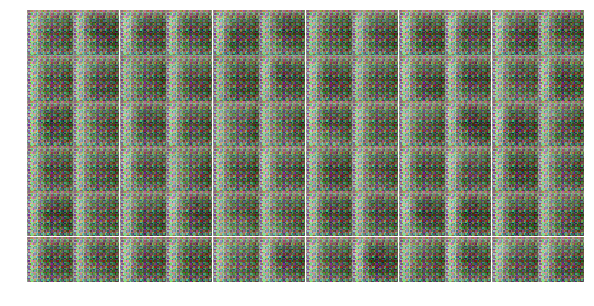

Epoch 1/25... Discriminator Loss: 0.1299... Generator Loss: 3.2275
Epoch 1/25... Discriminator Loss: 0.0932... Generator Loss: 3.3927
Epoch 1/25... Discriminator Loss: 1.5401... Generator Loss: 1.1375
Epoch 1/25... Discriminator Loss: 0.8070... Generator Loss: 1.1686
Epoch 1/25... Discriminator Loss: 1.0578... Generator Loss: 0.7955
Epoch 1/25... Discriminator Loss: 0.7397... Generator Loss: 1.1545
Epoch 1/25... Discriminator Loss: 0.5998... Generator Loss: 1.3889
Epoch 1/25... Discriminator Loss: 1.0393... Generator Loss: 2.9387
Epoch 1/25... Discriminator Loss: 0.3711... Generator Loss: 2.0130
Epoch 1/25... Discriminator Loss: 0.3141... Generator Loss: 2.0184


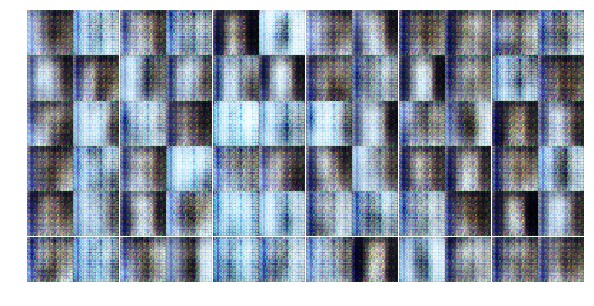

Epoch 1/25... Discriminator Loss: 0.3448... Generator Loss: 2.0327
Epoch 1/25... Discriminator Loss: 0.4747... Generator Loss: 2.2104
Epoch 1/25... Discriminator Loss: 0.4372... Generator Loss: 1.7208
Epoch 1/25... Discriminator Loss: 0.2583... Generator Loss: 1.8888
Epoch 1/25... Discriminator Loss: 0.2746... Generator Loss: 3.7781
Epoch 1/25... Discriminator Loss: 0.5984... Generator Loss: 3.3171
Epoch 1/25... Discriminator Loss: 0.5764... Generator Loss: 1.6413
Epoch 1/25... Discriminator Loss: 0.4144... Generator Loss: 2.5244
Epoch 1/25... Discriminator Loss: 0.4971... Generator Loss: 1.9356
Epoch 1/25... Discriminator Loss: 0.5949... Generator Loss: 3.0343


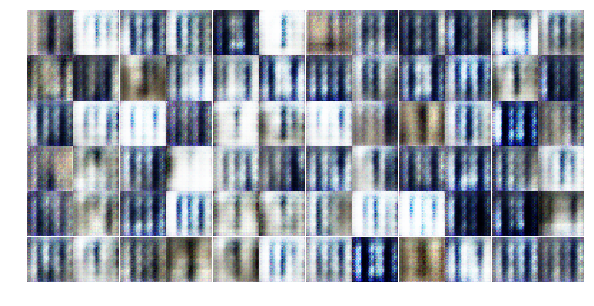

Epoch 1/25... Discriminator Loss: 0.4536... Generator Loss: 1.9423
Epoch 1/25... Discriminator Loss: 0.8293... Generator Loss: 1.1968
Epoch 1/25... Discriminator Loss: 1.0047... Generator Loss: 2.1875
Epoch 1/25... Discriminator Loss: 0.6667... Generator Loss: 1.9996
Epoch 1/25... Discriminator Loss: 0.3736... Generator Loss: 2.0993
Epoch 1/25... Discriminator Loss: 0.6257... Generator Loss: 1.2364
Epoch 1/25... Discriminator Loss: 0.4045... Generator Loss: 1.9071
Epoch 1/25... Discriminator Loss: 0.7109... Generator Loss: 2.3027
Epoch 1/25... Discriminator Loss: 0.3183... Generator Loss: 2.7514
Epoch 1/25... Discriminator Loss: 0.4310... Generator Loss: 1.9777


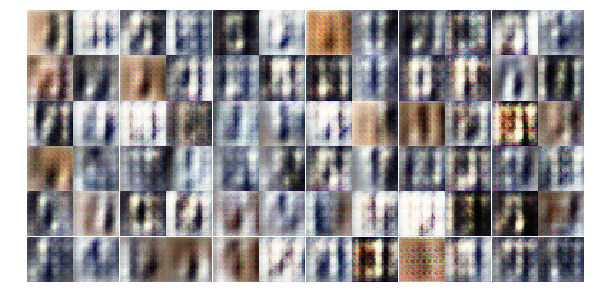

Epoch 1/25... Discriminator Loss: 0.4858... Generator Loss: 2.3916
Epoch 1/25... Discriminator Loss: 0.4542... Generator Loss: 2.3476
Epoch 1/25... Discriminator Loss: 0.5379... Generator Loss: 1.6274
Epoch 1/25... Discriminator Loss: 0.8824... Generator Loss: 0.8651
Epoch 1/25... Discriminator Loss: 0.5983... Generator Loss: 1.3403
Epoch 1/25... Discriminator Loss: 0.5669... Generator Loss: 1.4094
Epoch 1/25... Discriminator Loss: 0.8527... Generator Loss: 0.8887
Epoch 1/25... Discriminator Loss: 0.3805... Generator Loss: 2.3188
Epoch 1/25... Discriminator Loss: 0.5590... Generator Loss: 1.2178
Epoch 1/25... Discriminator Loss: 0.5820... Generator Loss: 1.6962


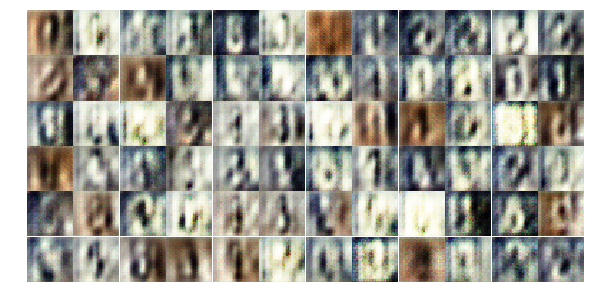

Epoch 1/25... Discriminator Loss: 0.6256... Generator Loss: 2.8289
Epoch 1/25... Discriminator Loss: 0.8451... Generator Loss: 1.3369
Epoch 1/25... Discriminator Loss: 0.8903... Generator Loss: 0.9411
Epoch 1/25... Discriminator Loss: 0.5922... Generator Loss: 1.7055
Epoch 1/25... Discriminator Loss: 0.7328... Generator Loss: 1.7186
Epoch 1/25... Discriminator Loss: 0.4444... Generator Loss: 2.0410
Epoch 1/25... Discriminator Loss: 0.3827... Generator Loss: 2.2948
Epoch 2/25... Discriminator Loss: 0.8463... Generator Loss: 1.9871
Epoch 2/25... Discriminator Loss: 0.9727... Generator Loss: 1.2769
Epoch 2/25... Discriminator Loss: 0.6730... Generator Loss: 1.7088


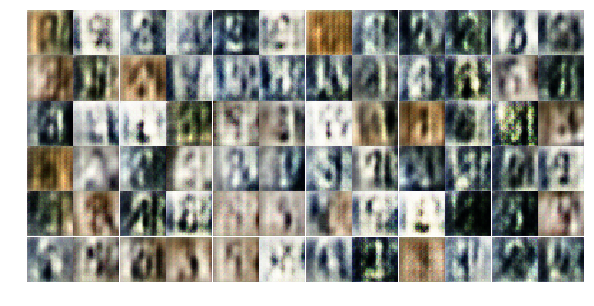

Epoch 2/25... Discriminator Loss: 1.1961... Generator Loss: 0.7854
Epoch 2/25... Discriminator Loss: 0.7634... Generator Loss: 1.4641
Epoch 2/25... Discriminator Loss: 0.3894... Generator Loss: 2.4526
Epoch 2/25... Discriminator Loss: 0.8492... Generator Loss: 1.4014
Epoch 2/25... Discriminator Loss: 0.6830... Generator Loss: 1.4762
Epoch 2/25... Discriminator Loss: 0.8382... Generator Loss: 1.1777
Epoch 2/25... Discriminator Loss: 0.7424... Generator Loss: 1.2099
Epoch 2/25... Discriminator Loss: 0.5518... Generator Loss: 1.4996
Epoch 2/25... Discriminator Loss: 0.7026... Generator Loss: 1.3542
Epoch 2/25... Discriminator Loss: 1.3289... Generator Loss: 0.5920


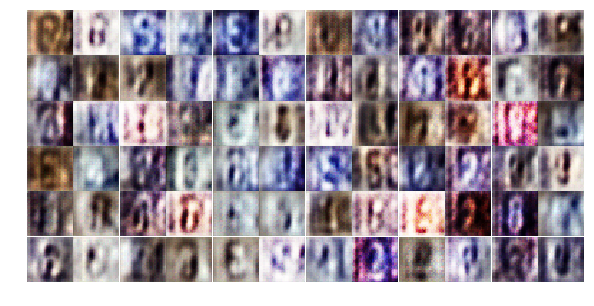

Epoch 2/25... Discriminator Loss: 0.9678... Generator Loss: 1.6012
Epoch 2/25... Discriminator Loss: 1.0460... Generator Loss: 1.1946
Epoch 2/25... Discriminator Loss: 0.8192... Generator Loss: 1.1364
Epoch 2/25... Discriminator Loss: 0.5195... Generator Loss: 1.8606
Epoch 2/25... Discriminator Loss: 1.0575... Generator Loss: 0.9766
Epoch 2/25... Discriminator Loss: 0.9951... Generator Loss: 0.8751
Epoch 2/25... Discriminator Loss: 1.3547... Generator Loss: 0.6119
Epoch 2/25... Discriminator Loss: 0.8028... Generator Loss: 1.0339
Epoch 2/25... Discriminator Loss: 0.8748... Generator Loss: 1.1646
Epoch 2/25... Discriminator Loss: 1.1421... Generator Loss: 0.6199


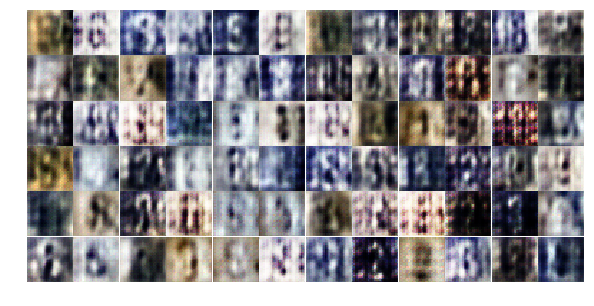

Epoch 2/25... Discriminator Loss: 0.9555... Generator Loss: 1.0454
Epoch 2/25... Discriminator Loss: 0.7990... Generator Loss: 1.3204
Epoch 2/25... Discriminator Loss: 0.4713... Generator Loss: 2.1409
Epoch 2/25... Discriminator Loss: 0.7747... Generator Loss: 3.0180
Epoch 2/25... Discriminator Loss: 1.3855... Generator Loss: 0.6386
Epoch 2/25... Discriminator Loss: 1.2455... Generator Loss: 1.8644
Epoch 2/25... Discriminator Loss: 1.2140... Generator Loss: 0.6339
Epoch 2/25... Discriminator Loss: 0.5857... Generator Loss: 1.3715
Epoch 2/25... Discriminator Loss: 1.0351... Generator Loss: 1.3647
Epoch 2/25... Discriminator Loss: 0.7703... Generator Loss: 1.2407


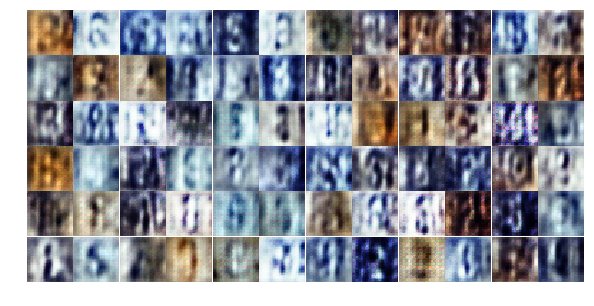

Epoch 2/25... Discriminator Loss: 0.8256... Generator Loss: 1.7641
Epoch 2/25... Discriminator Loss: 0.8679... Generator Loss: 1.3684
Epoch 2/25... Discriminator Loss: 1.1620... Generator Loss: 1.0410
Epoch 2/25... Discriminator Loss: 1.0143... Generator Loss: 0.9543
Epoch 2/25... Discriminator Loss: 0.7164... Generator Loss: 1.7265
Epoch 2/25... Discriminator Loss: 0.6330... Generator Loss: 1.7593
Epoch 2/25... Discriminator Loss: 1.1780... Generator Loss: 0.9053
Epoch 2/25... Discriminator Loss: 1.0261... Generator Loss: 2.0202
Epoch 2/25... Discriminator Loss: 0.7785... Generator Loss: 1.0162
Epoch 2/25... Discriminator Loss: 0.7323... Generator Loss: 1.1301


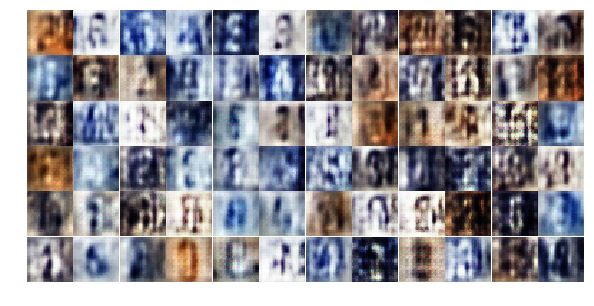

Epoch 2/25... Discriminator Loss: 0.5534... Generator Loss: 2.0205
Epoch 2/25... Discriminator Loss: 0.9567... Generator Loss: 1.4562
Epoch 2/25... Discriminator Loss: 0.6876... Generator Loss: 1.3041
Epoch 2/25... Discriminator Loss: 0.5265... Generator Loss: 2.1121
Epoch 2/25... Discriminator Loss: 1.2840... Generator Loss: 3.1011
Epoch 2/25... Discriminator Loss: 0.6067... Generator Loss: 1.2105
Epoch 2/25... Discriminator Loss: 0.6013... Generator Loss: 1.3597
Epoch 2/25... Discriminator Loss: 0.7572... Generator Loss: 1.4325
Epoch 2/25... Discriminator Loss: 1.0138... Generator Loss: 1.4868
Epoch 2/25... Discriminator Loss: 0.6386... Generator Loss: 1.8616


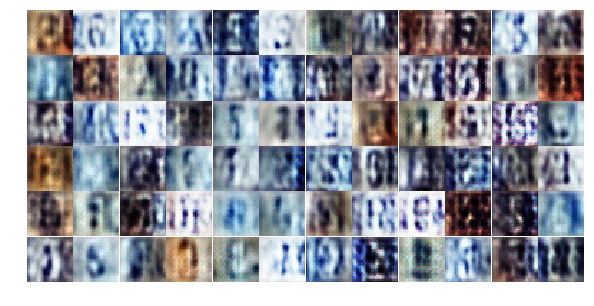

Epoch 2/25... Discriminator Loss: 0.4341... Generator Loss: 2.6910
Epoch 2/25... Discriminator Loss: 0.7392... Generator Loss: 1.3079
Epoch 2/25... Discriminator Loss: 0.5388... Generator Loss: 1.9197
Epoch 2/25... Discriminator Loss: 0.9715... Generator Loss: 0.7330
Epoch 3/25... Discriminator Loss: 0.7241... Generator Loss: 2.2070
Epoch 3/25... Discriminator Loss: 0.6202... Generator Loss: 1.5169
Epoch 3/25... Discriminator Loss: 0.7757... Generator Loss: 3.0075
Epoch 3/25... Discriminator Loss: 0.8620... Generator Loss: 0.8449
Epoch 3/25... Discriminator Loss: 0.6504... Generator Loss: 0.9831
Epoch 3/25... Discriminator Loss: 0.7981... Generator Loss: 0.9377


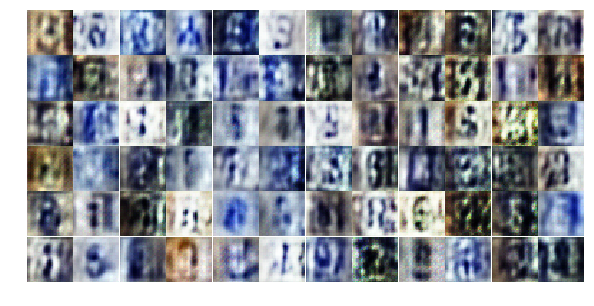

Epoch 3/25... Discriminator Loss: 0.3784... Generator Loss: 1.7134
Epoch 3/25... Discriminator Loss: 0.7833... Generator Loss: 2.3879
Epoch 3/25... Discriminator Loss: 1.0348... Generator Loss: 0.6256
Epoch 3/25... Discriminator Loss: 0.1835... Generator Loss: 2.3369
Epoch 3/25... Discriminator Loss: 1.7610... Generator Loss: 0.2943
Epoch 3/25... Discriminator Loss: 0.7567... Generator Loss: 0.9730
Epoch 3/25... Discriminator Loss: 0.7818... Generator Loss: 1.0734
Epoch 3/25... Discriminator Loss: 0.5312... Generator Loss: 1.2014
Epoch 3/25... Discriminator Loss: 0.6564... Generator Loss: 2.0620
Epoch 3/25... Discriminator Loss: 0.5412... Generator Loss: 2.0070


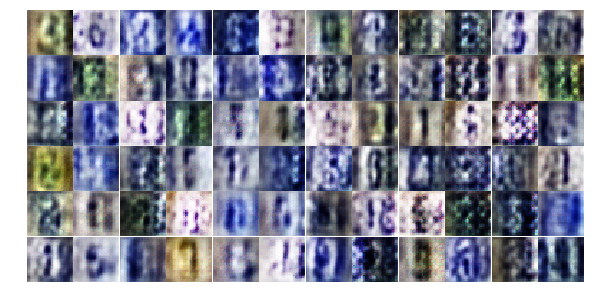

Epoch 3/25... Discriminator Loss: 0.5277... Generator Loss: 1.7877
Epoch 3/25... Discriminator Loss: 0.2097... Generator Loss: 2.5017
Epoch 3/25... Discriminator Loss: 0.4644... Generator Loss: 3.4574
Epoch 3/25... Discriminator Loss: 0.6055... Generator Loss: 1.3099
Epoch 3/25... Discriminator Loss: 0.5828... Generator Loss: 1.2749
Epoch 3/25... Discriminator Loss: 0.2908... Generator Loss: 2.4841
Epoch 3/25... Discriminator Loss: 1.4974... Generator Loss: 0.3386
Epoch 3/25... Discriminator Loss: 0.5596... Generator Loss: 1.9410
Epoch 3/25... Discriminator Loss: 0.3187... Generator Loss: 2.0270
Epoch 3/25... Discriminator Loss: 0.4848... Generator Loss: 1.5738


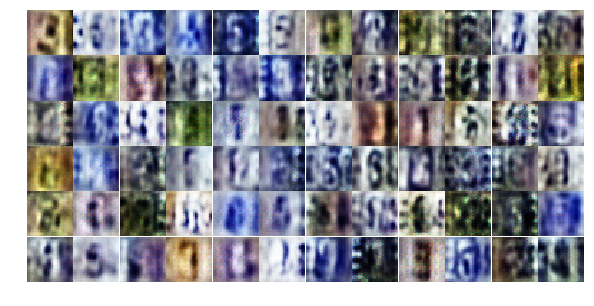

Epoch 3/25... Discriminator Loss: 0.7368... Generator Loss: 1.5004
Epoch 3/25... Discriminator Loss: 0.6609... Generator Loss: 1.0909
Epoch 3/25... Discriminator Loss: 0.6596... Generator Loss: 1.3080
Epoch 3/25... Discriminator Loss: 0.7770... Generator Loss: 1.1983
Epoch 3/25... Discriminator Loss: 0.4042... Generator Loss: 2.1601
Epoch 3/25... Discriminator Loss: 1.8789... Generator Loss: 0.2989
Epoch 3/25... Discriminator Loss: 0.9739... Generator Loss: 0.8300
Epoch 3/25... Discriminator Loss: 0.5145... Generator Loss: 2.2197
Epoch 3/25... Discriminator Loss: 0.3630... Generator Loss: 2.2261
Epoch 3/25... Discriminator Loss: 0.6087... Generator Loss: 1.4279


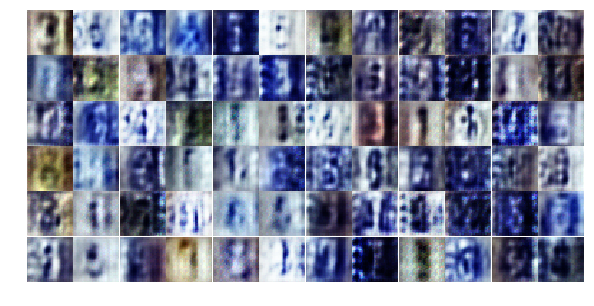

Epoch 3/25... Discriminator Loss: 1.5063... Generator Loss: 3.4171
Epoch 3/25... Discriminator Loss: 0.3431... Generator Loss: 1.8427
Epoch 3/25... Discriminator Loss: 0.3792... Generator Loss: 2.4495
Epoch 3/25... Discriminator Loss: 0.3249... Generator Loss: 2.0104
Epoch 3/25... Discriminator Loss: 0.7693... Generator Loss: 1.9156
Epoch 3/25... Discriminator Loss: 0.3883... Generator Loss: 2.1192
Epoch 3/25... Discriminator Loss: 0.8590... Generator Loss: 1.0121
Epoch 3/25... Discriminator Loss: 1.1767... Generator Loss: 2.1146
Epoch 3/25... Discriminator Loss: 0.8880... Generator Loss: 2.4088
Epoch 3/25... Discriminator Loss: 0.7707... Generator Loss: 1.2816


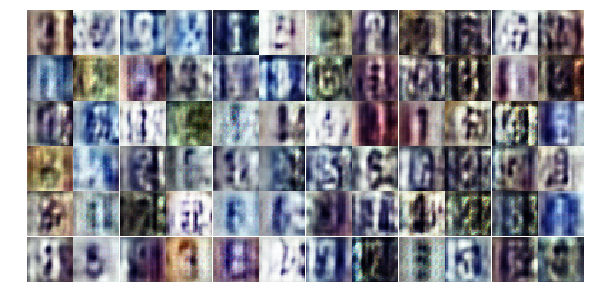

Epoch 3/25... Discriminator Loss: 0.9785... Generator Loss: 0.7745
Epoch 3/25... Discriminator Loss: 0.6868... Generator Loss: 1.2116
Epoch 3/25... Discriminator Loss: 0.8582... Generator Loss: 0.8084
Epoch 3/25... Discriminator Loss: 0.6583... Generator Loss: 1.2278
Epoch 3/25... Discriminator Loss: 0.8873... Generator Loss: 0.8019
Epoch 3/25... Discriminator Loss: 0.7023... Generator Loss: 2.2692
Epoch 3/25... Discriminator Loss: 0.3941... Generator Loss: 2.6581
Epoch 3/25... Discriminator Loss: 0.3098... Generator Loss: 2.7239
Epoch 3/25... Discriminator Loss: 0.4493... Generator Loss: 1.9759
Epoch 3/25... Discriminator Loss: 0.3209... Generator Loss: 2.3157


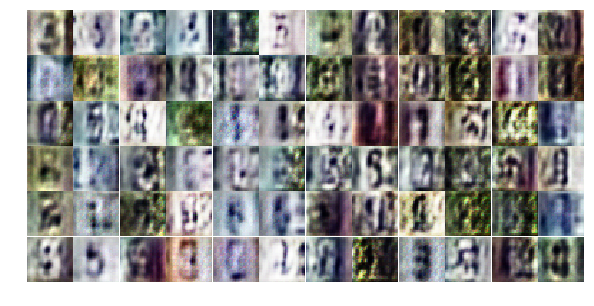

Epoch 3/25... Discriminator Loss: 0.6855... Generator Loss: 1.1324
Epoch 4/25... Discriminator Loss: 0.5931... Generator Loss: 1.7420
Epoch 4/25... Discriminator Loss: 1.3912... Generator Loss: 2.3292
Epoch 4/25... Discriminator Loss: 0.7153... Generator Loss: 1.4348
Epoch 4/25... Discriminator Loss: 0.5930... Generator Loss: 1.4407
Epoch 4/25... Discriminator Loss: 0.5363... Generator Loss: 2.0902
Epoch 4/25... Discriminator Loss: 0.5773... Generator Loss: 1.4888
Epoch 4/25... Discriminator Loss: 0.3647... Generator Loss: 1.7281
Epoch 4/25... Discriminator Loss: 0.5822... Generator Loss: 1.2974
Epoch 4/25... Discriminator Loss: 1.0396... Generator Loss: 0.7242


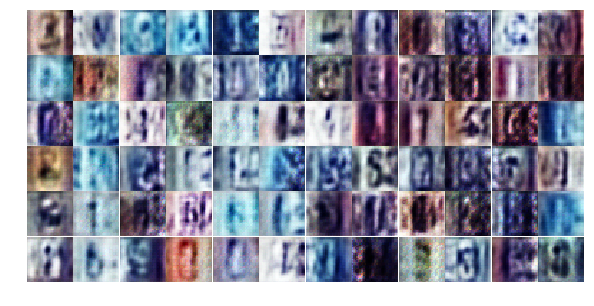

Epoch 4/25... Discriminator Loss: 0.4787... Generator Loss: 2.5155
Epoch 4/25... Discriminator Loss: 0.7553... Generator Loss: 1.1464
Epoch 4/25... Discriminator Loss: 0.8199... Generator Loss: 1.4538
Epoch 4/25... Discriminator Loss: 0.3466... Generator Loss: 2.2742
Epoch 4/25... Discriminator Loss: 0.3978... Generator Loss: 2.1509
Epoch 4/25... Discriminator Loss: 0.8663... Generator Loss: 2.9408
Epoch 4/25... Discriminator Loss: 0.6093... Generator Loss: 3.0748
Epoch 4/25... Discriminator Loss: 1.4482... Generator Loss: 0.3829
Epoch 4/25... Discriminator Loss: 1.5335... Generator Loss: 0.4032
Epoch 4/25... Discriminator Loss: 0.9810... Generator Loss: 2.4333


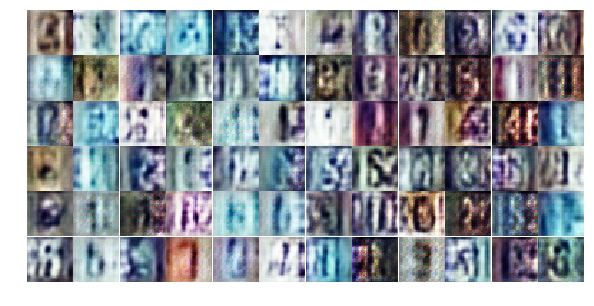

Epoch 4/25... Discriminator Loss: 0.7207... Generator Loss: 1.0617
Epoch 4/25... Discriminator Loss: 0.5514... Generator Loss: 2.7169
Epoch 4/25... Discriminator Loss: 0.5372... Generator Loss: 1.3377
Epoch 4/25... Discriminator Loss: 0.9531... Generator Loss: 0.6843
Epoch 4/25... Discriminator Loss: 0.4450... Generator Loss: 1.6729
Epoch 4/25... Discriminator Loss: 0.4947... Generator Loss: 1.4902
Epoch 4/25... Discriminator Loss: 0.8638... Generator Loss: 0.8757
Epoch 4/25... Discriminator Loss: 1.2312... Generator Loss: 0.5251
Epoch 4/25... Discriminator Loss: 0.3034... Generator Loss: 2.1463
Epoch 4/25... Discriminator Loss: 0.5933... Generator Loss: 1.1306


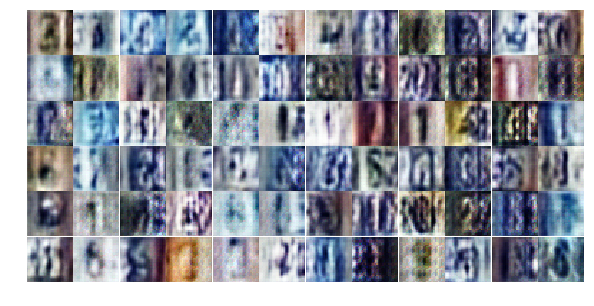

Epoch 4/25... Discriminator Loss: 0.5522... Generator Loss: 2.1165
Epoch 4/25... Discriminator Loss: 0.5140... Generator Loss: 2.3654
Epoch 4/25... Discriminator Loss: 0.5421... Generator Loss: 1.6182
Epoch 4/25... Discriminator Loss: 0.4652... Generator Loss: 1.8877
Epoch 4/25... Discriminator Loss: 0.5934... Generator Loss: 3.0993
Epoch 4/25... Discriminator Loss: 0.6342... Generator Loss: 1.4207
Epoch 4/25... Discriminator Loss: 0.3570... Generator Loss: 2.0801
Epoch 4/25... Discriminator Loss: 0.4285... Generator Loss: 1.4360
Epoch 4/25... Discriminator Loss: 0.3742... Generator Loss: 1.5548
Epoch 4/25... Discriminator Loss: 0.4388... Generator Loss: 1.6883


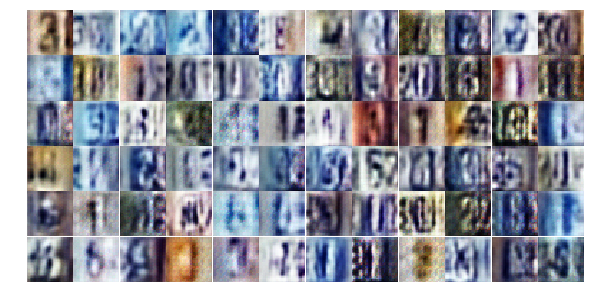

Epoch 4/25... Discriminator Loss: 0.7805... Generator Loss: 0.8223
Epoch 4/25... Discriminator Loss: 0.8077... Generator Loss: 0.9540
Epoch 4/25... Discriminator Loss: 1.2388... Generator Loss: 2.8165
Epoch 4/25... Discriminator Loss: 0.5091... Generator Loss: 1.8300
Epoch 4/25... Discriminator Loss: 0.3690... Generator Loss: 3.3008
Epoch 4/25... Discriminator Loss: 0.4420... Generator Loss: 1.7946
Epoch 4/25... Discriminator Loss: 0.4431... Generator Loss: 2.3203
Epoch 4/25... Discriminator Loss: 1.1970... Generator Loss: 0.6010
Epoch 4/25... Discriminator Loss: 0.6954... Generator Loss: 2.6727
Epoch 4/25... Discriminator Loss: 0.8778... Generator Loss: 1.2035


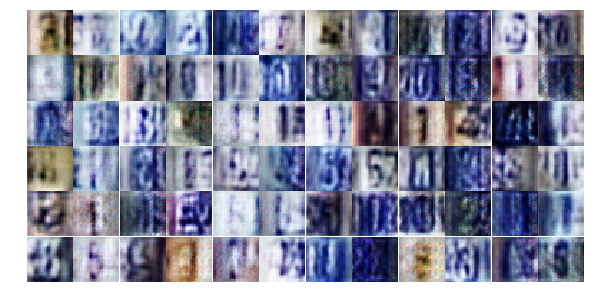

Epoch 4/25... Discriminator Loss: 0.6827... Generator Loss: 1.0255
Epoch 4/25... Discriminator Loss: 0.4819... Generator Loss: 1.4946
Epoch 4/25... Discriminator Loss: 0.4532... Generator Loss: 1.5318
Epoch 4/25... Discriminator Loss: 0.8204... Generator Loss: 0.9600
Epoch 4/25... Discriminator Loss: 0.5782... Generator Loss: 1.2525
Epoch 4/25... Discriminator Loss: 0.7647... Generator Loss: 1.0527
Epoch 4/25... Discriminator Loss: 0.3864... Generator Loss: 2.0332
Epoch 4/25... Discriminator Loss: 0.7697... Generator Loss: 0.8663
Epoch 4/25... Discriminator Loss: 0.5300... Generator Loss: 1.7510
Epoch 5/25... Discriminator Loss: 0.5094... Generator Loss: 1.5210


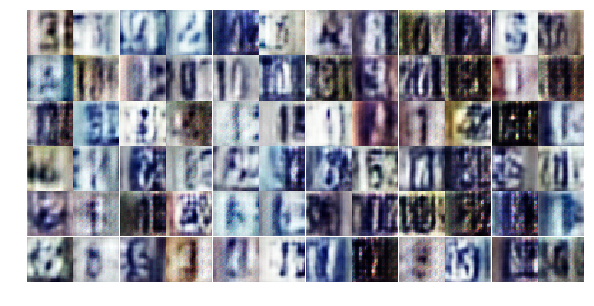

Epoch 5/25... Discriminator Loss: 0.5897... Generator Loss: 2.8524
Epoch 5/25... Discriminator Loss: 1.7263... Generator Loss: 0.3026
Epoch 5/25... Discriminator Loss: 0.6278... Generator Loss: 1.6895
Epoch 5/25... Discriminator Loss: 0.4380... Generator Loss: 1.5108
Epoch 5/25... Discriminator Loss: 0.4310... Generator Loss: 1.8124
Epoch 5/25... Discriminator Loss: 0.9581... Generator Loss: 0.6584
Epoch 5/25... Discriminator Loss: 0.7075... Generator Loss: 0.9779
Epoch 5/25... Discriminator Loss: 0.3665... Generator Loss: 1.9014
Epoch 5/25... Discriminator Loss: 0.5194... Generator Loss: 1.5569
Epoch 5/25... Discriminator Loss: 1.1667... Generator Loss: 0.5488


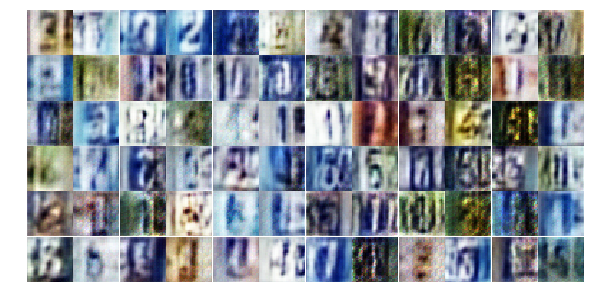

Epoch 5/25... Discriminator Loss: 1.9189... Generator Loss: 3.4150
Epoch 5/25... Discriminator Loss: 0.6776... Generator Loss: 1.0974
Epoch 5/25... Discriminator Loss: 0.8082... Generator Loss: 0.9258
Epoch 5/25... Discriminator Loss: 0.7556... Generator Loss: 0.9430
Epoch 5/25... Discriminator Loss: 0.5764... Generator Loss: 1.1594
Epoch 5/25... Discriminator Loss: 0.4948... Generator Loss: 1.6763
Epoch 5/25... Discriminator Loss: 0.5114... Generator Loss: 1.4243
Epoch 5/25... Discriminator Loss: 0.8084... Generator Loss: 0.9904
Epoch 5/25... Discriminator Loss: 0.5403... Generator Loss: 1.3837
Epoch 5/25... Discriminator Loss: 0.5210... Generator Loss: 1.3020


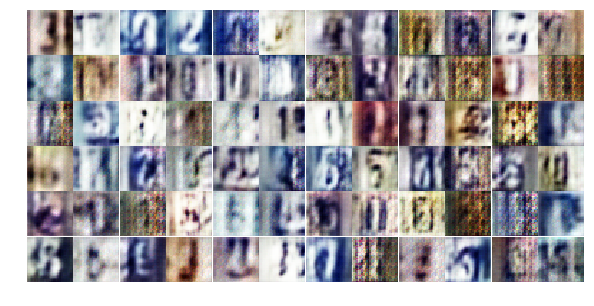

Epoch 5/25... Discriminator Loss: 0.2595... Generator Loss: 2.4596
Epoch 5/25... Discriminator Loss: 1.3038... Generator Loss: 0.5990
Epoch 5/25... Discriminator Loss: 0.6269... Generator Loss: 1.4220
Epoch 5/25... Discriminator Loss: 0.9533... Generator Loss: 0.7651
Epoch 5/25... Discriminator Loss: 1.0114... Generator Loss: 0.6386
Epoch 5/25... Discriminator Loss: 0.7050... Generator Loss: 0.9594
Epoch 5/25... Discriminator Loss: 1.3134... Generator Loss: 0.4153
Epoch 5/25... Discriminator Loss: 0.7262... Generator Loss: 1.1976
Epoch 5/25... Discriminator Loss: 0.7536... Generator Loss: 0.9805
Epoch 5/25... Discriminator Loss: 0.4344... Generator Loss: 1.7641


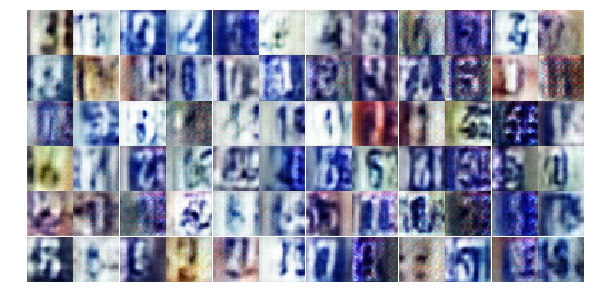

Epoch 5/25... Discriminator Loss: 0.7152... Generator Loss: 1.8344
Epoch 5/25... Discriminator Loss: 0.5853... Generator Loss: 1.2807
Epoch 5/25... Discriminator Loss: 0.5775... Generator Loss: 1.8496
Epoch 5/25... Discriminator Loss: 0.5019... Generator Loss: 1.2221
Epoch 5/25... Discriminator Loss: 0.9509... Generator Loss: 0.7192
Epoch 5/25... Discriminator Loss: 0.9139... Generator Loss: 2.4474
Epoch 5/25... Discriminator Loss: 1.1295... Generator Loss: 0.5728
Epoch 5/25... Discriminator Loss: 0.6650... Generator Loss: 1.1065
Epoch 5/25... Discriminator Loss: 0.4318... Generator Loss: 1.4720
Epoch 5/25... Discriminator Loss: 1.1377... Generator Loss: 0.5342


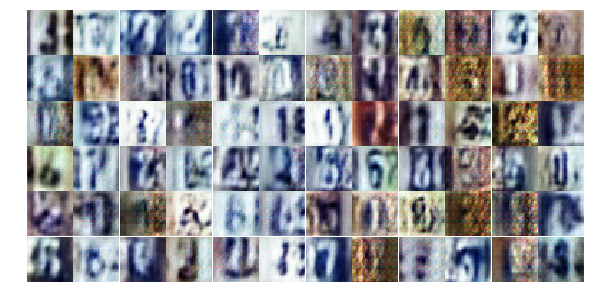

Epoch 5/25... Discriminator Loss: 0.9088... Generator Loss: 0.7925
Epoch 5/25... Discriminator Loss: 1.5070... Generator Loss: 0.3602
Epoch 5/25... Discriminator Loss: 2.0927... Generator Loss: 3.8143
Epoch 5/25... Discriminator Loss: 0.7560... Generator Loss: 2.1246
Epoch 5/25... Discriminator Loss: 0.9464... Generator Loss: 0.8737
Epoch 5/25... Discriminator Loss: 0.9725... Generator Loss: 0.6473
Epoch 5/25... Discriminator Loss: 1.1948... Generator Loss: 0.5168
Epoch 5/25... Discriminator Loss: 0.7433... Generator Loss: 1.4386
Epoch 5/25... Discriminator Loss: 1.1139... Generator Loss: 0.6077
Epoch 5/25... Discriminator Loss: 0.8760... Generator Loss: 3.0720


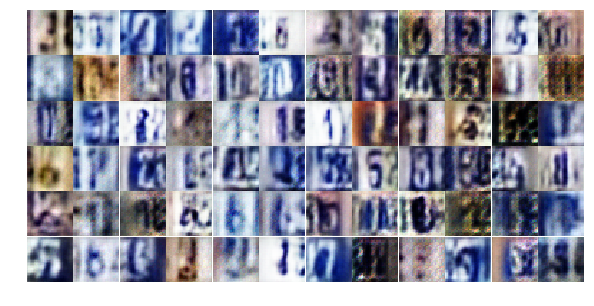

Epoch 5/25... Discriminator Loss: 0.6122... Generator Loss: 1.0818
Epoch 5/25... Discriminator Loss: 0.5301... Generator Loss: 1.2703
Epoch 5/25... Discriminator Loss: 1.0445... Generator Loss: 0.6329
Epoch 5/25... Discriminator Loss: 1.0578... Generator Loss: 0.5511
Epoch 5/25... Discriminator Loss: 0.5599... Generator Loss: 1.2302
Epoch 5/25... Discriminator Loss: 0.9002... Generator Loss: 1.3316
Epoch 6/25... Discriminator Loss: 0.7601... Generator Loss: 2.0940
Epoch 6/25... Discriminator Loss: 0.5974... Generator Loss: 1.2008
Epoch 6/25... Discriminator Loss: 0.8581... Generator Loss: 2.2555
Epoch 6/25... Discriminator Loss: 1.0465... Generator Loss: 0.5571


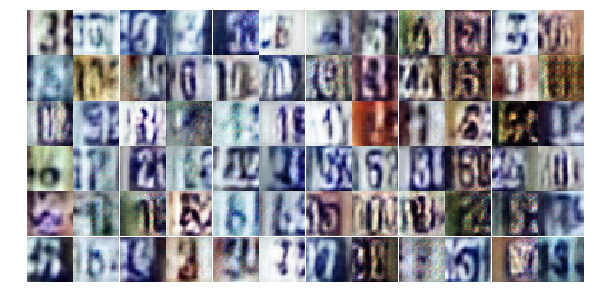

Epoch 6/25... Discriminator Loss: 0.5817... Generator Loss: 1.1976
Epoch 6/25... Discriminator Loss: 0.5631... Generator Loss: 1.6264
Epoch 6/25... Discriminator Loss: 0.6861... Generator Loss: 1.6082
Epoch 6/25... Discriminator Loss: 0.8238... Generator Loss: 1.0140
Epoch 6/25... Discriminator Loss: 0.4589... Generator Loss: 1.3552
Epoch 6/25... Discriminator Loss: 0.5214... Generator Loss: 1.6196
Epoch 6/25... Discriminator Loss: 0.6433... Generator Loss: 1.6555
Epoch 6/25... Discriminator Loss: 0.8493... Generator Loss: 2.0897
Epoch 6/25... Discriminator Loss: 0.9345... Generator Loss: 0.7853
Epoch 6/25... Discriminator Loss: 0.5938... Generator Loss: 1.9780


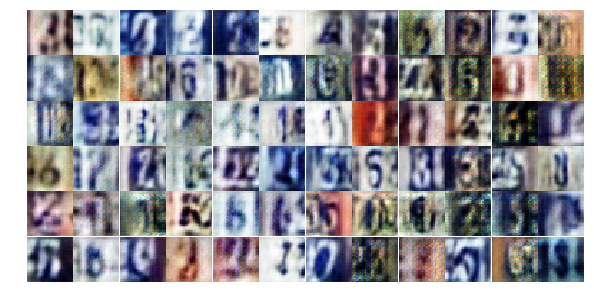

Epoch 6/25... Discriminator Loss: 0.8848... Generator Loss: 0.7579
Epoch 6/25... Discriminator Loss: 0.4418... Generator Loss: 1.9920
Epoch 6/25... Discriminator Loss: 0.7726... Generator Loss: 1.0683
Epoch 6/25... Discriminator Loss: 0.4627... Generator Loss: 1.4595
Epoch 6/25... Discriminator Loss: 0.7916... Generator Loss: 2.3764
Epoch 6/25... Discriminator Loss: 0.5679... Generator Loss: 1.2891
Epoch 6/25... Discriminator Loss: 0.6866... Generator Loss: 1.0747
Epoch 6/25... Discriminator Loss: 0.5006... Generator Loss: 1.2824
Epoch 6/25... Discriminator Loss: 0.6631... Generator Loss: 1.7750
Epoch 6/25... Discriminator Loss: 0.7864... Generator Loss: 1.2989


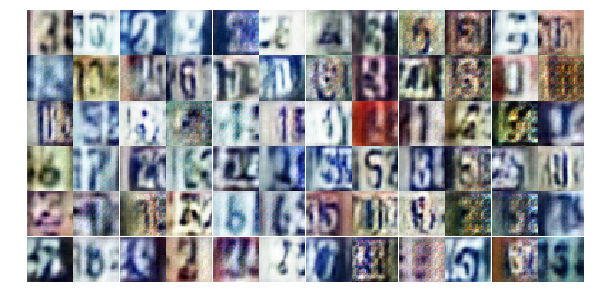

Epoch 6/25... Discriminator Loss: 0.9066... Generator Loss: 0.6937
Epoch 6/25... Discriminator Loss: 0.6427... Generator Loss: 1.1392
Epoch 6/25... Discriminator Loss: 0.8129... Generator Loss: 0.9577
Epoch 6/25... Discriminator Loss: 0.6506... Generator Loss: 1.2764
Epoch 6/25... Discriminator Loss: 0.6721... Generator Loss: 2.1453
Epoch 6/25... Discriminator Loss: 0.6569... Generator Loss: 1.1628
Epoch 6/25... Discriminator Loss: 0.5502... Generator Loss: 1.2123
Epoch 6/25... Discriminator Loss: 0.4385... Generator Loss: 1.4211
Epoch 6/25... Discriminator Loss: 0.2524... Generator Loss: 2.1469
Epoch 6/25... Discriminator Loss: 0.3938... Generator Loss: 1.9992


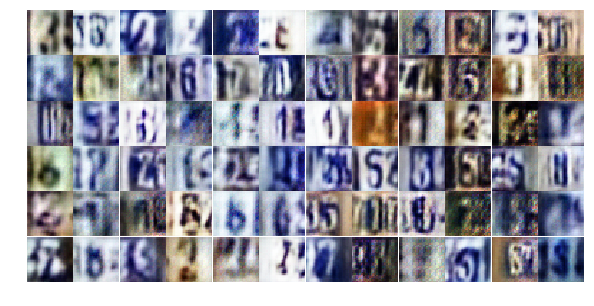

Epoch 6/25... Discriminator Loss: 1.2888... Generator Loss: 0.4059
Epoch 6/25... Discriminator Loss: 1.9203... Generator Loss: 3.6824
Epoch 6/25... Discriminator Loss: 0.7870... Generator Loss: 1.0396
Epoch 6/25... Discriminator Loss: 0.8015... Generator Loss: 0.8306
Epoch 6/25... Discriminator Loss: 0.8462... Generator Loss: 0.8305
Epoch 6/25... Discriminator Loss: 0.5988... Generator Loss: 1.1893
Epoch 6/25... Discriminator Loss: 0.6207... Generator Loss: 1.2569
Epoch 6/25... Discriminator Loss: 0.5375... Generator Loss: 1.4736
Epoch 6/25... Discriminator Loss: 1.0231... Generator Loss: 0.6135
Epoch 6/25... Discriminator Loss: 0.8155... Generator Loss: 0.8344


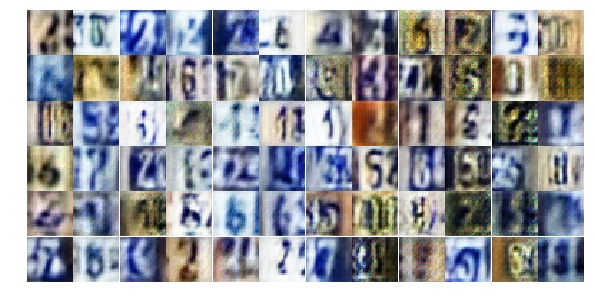

Epoch 6/25... Discriminator Loss: 0.8976... Generator Loss: 1.3874
Epoch 6/25... Discriminator Loss: 0.9142... Generator Loss: 1.6830
Epoch 6/25... Discriminator Loss: 0.8941... Generator Loss: 0.7741
Epoch 6/25... Discriminator Loss: 0.3877... Generator Loss: 1.7775
Epoch 6/25... Discriminator Loss: 0.6976... Generator Loss: 1.0172
Epoch 6/25... Discriminator Loss: 0.6148... Generator Loss: 1.0672
Epoch 6/25... Discriminator Loss: 1.1023... Generator Loss: 0.5943
Epoch 6/25... Discriminator Loss: 0.8935... Generator Loss: 0.8733
Epoch 6/25... Discriminator Loss: 0.4848... Generator Loss: 1.4014
Epoch 6/25... Discriminator Loss: 1.6290... Generator Loss: 0.3250


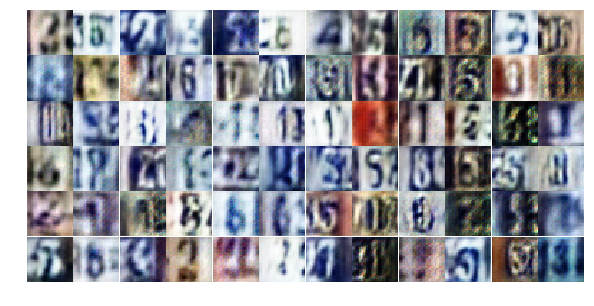

Epoch 6/25... Discriminator Loss: 0.7354... Generator Loss: 1.0522
Epoch 6/25... Discriminator Loss: 0.6728... Generator Loss: 1.0452
Epoch 6/25... Discriminator Loss: 0.7236... Generator Loss: 1.2625
Epoch 7/25... Discriminator Loss: 0.4847... Generator Loss: 1.6520
Epoch 7/25... Discriminator Loss: 0.4618... Generator Loss: 1.4960
Epoch 7/25... Discriminator Loss: 0.5562... Generator Loss: 1.2176
Epoch 7/25... Discriminator Loss: 1.0483... Generator Loss: 0.6507
Epoch 7/25... Discriminator Loss: 0.4951... Generator Loss: 1.3683
Epoch 7/25... Discriminator Loss: 0.5757... Generator Loss: 1.1100
Epoch 7/25... Discriminator Loss: 0.6254... Generator Loss: 1.0699


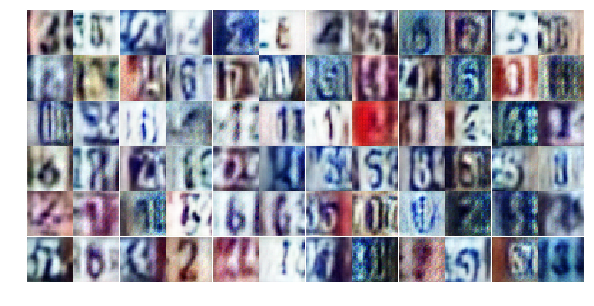

Epoch 7/25... Discriminator Loss: 0.7298... Generator Loss: 0.9678
Epoch 7/25... Discriminator Loss: 1.1200... Generator Loss: 0.5404
Epoch 7/25... Discriminator Loss: 1.3400... Generator Loss: 0.4247
Epoch 7/25... Discriminator Loss: 0.6428... Generator Loss: 1.2591
Epoch 7/25... Discriminator Loss: 0.6508... Generator Loss: 1.0800
Epoch 7/25... Discriminator Loss: 0.3626... Generator Loss: 1.9366
Epoch 7/25... Discriminator Loss: 0.6315... Generator Loss: 1.8521
Epoch 7/25... Discriminator Loss: 1.4683... Generator Loss: 3.1982
Epoch 7/25... Discriminator Loss: 0.5333... Generator Loss: 1.7619
Epoch 7/25... Discriminator Loss: 0.5908... Generator Loss: 1.1808


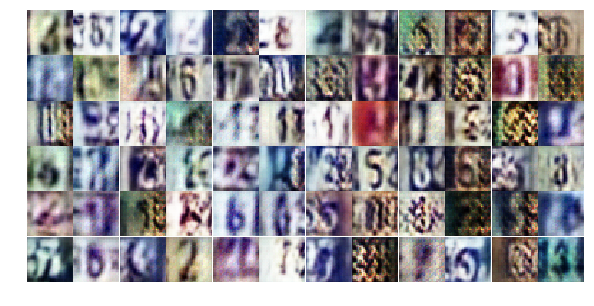

Epoch 7/25... Discriminator Loss: 0.4857... Generator Loss: 1.6922
Epoch 7/25... Discriminator Loss: 0.4856... Generator Loss: 1.8677
Epoch 7/25... Discriminator Loss: 0.8669... Generator Loss: 0.8578
Epoch 7/25... Discriminator Loss: 0.7148... Generator Loss: 1.1122
Epoch 7/25... Discriminator Loss: 0.4188... Generator Loss: 1.6920
Epoch 7/25... Discriminator Loss: 0.6013... Generator Loss: 1.8156
Epoch 7/25... Discriminator Loss: 0.5008... Generator Loss: 1.6440
Epoch 7/25... Discriminator Loss: 1.0227... Generator Loss: 0.5902
Epoch 7/25... Discriminator Loss: 0.2772... Generator Loss: 2.2032
Epoch 7/25... Discriminator Loss: 0.5075... Generator Loss: 1.8316


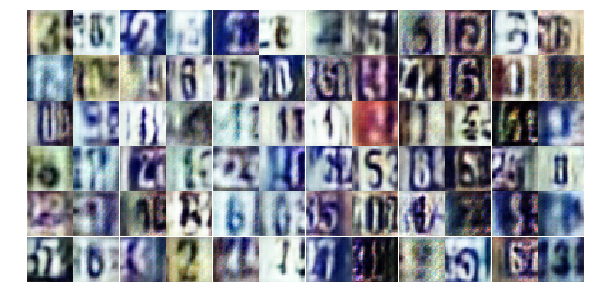

Epoch 7/25... Discriminator Loss: 0.8105... Generator Loss: 0.7880
Epoch 7/25... Discriminator Loss: 1.4466... Generator Loss: 0.5180
Epoch 7/25... Discriminator Loss: 0.5525... Generator Loss: 1.3716
Epoch 7/25... Discriminator Loss: 0.7804... Generator Loss: 0.9306
Epoch 7/25... Discriminator Loss: 0.8990... Generator Loss: 0.7662
Epoch 7/25... Discriminator Loss: 1.0545... Generator Loss: 0.6213
Epoch 7/25... Discriminator Loss: 0.6044... Generator Loss: 1.2495
Epoch 7/25... Discriminator Loss: 0.8407... Generator Loss: 0.8227
Epoch 7/25... Discriminator Loss: 1.0417... Generator Loss: 0.6596
Epoch 7/25... Discriminator Loss: 0.6643... Generator Loss: 2.4265


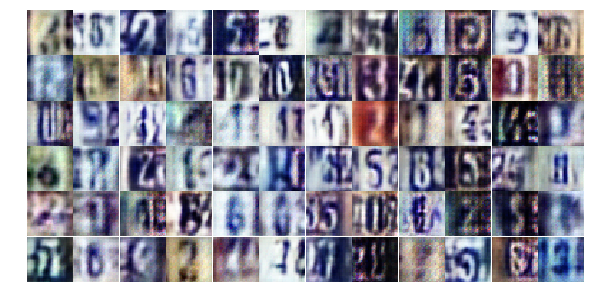

Epoch 7/25... Discriminator Loss: 0.9714... Generator Loss: 0.7328
Epoch 7/25... Discriminator Loss: 0.7091... Generator Loss: 1.0985
Epoch 7/25... Discriminator Loss: 0.4452... Generator Loss: 1.6099
Epoch 7/25... Discriminator Loss: 0.4830... Generator Loss: 1.6047
Epoch 7/25... Discriminator Loss: 0.9311... Generator Loss: 0.8036
Epoch 7/25... Discriminator Loss: 0.4600... Generator Loss: 1.4953
Epoch 7/25... Discriminator Loss: 0.3516... Generator Loss: 2.1223
Epoch 7/25... Discriminator Loss: 1.5495... Generator Loss: 0.3595
Epoch 7/25... Discriminator Loss: 0.4819... Generator Loss: 1.4011
Epoch 7/25... Discriminator Loss: 0.7349... Generator Loss: 1.1440


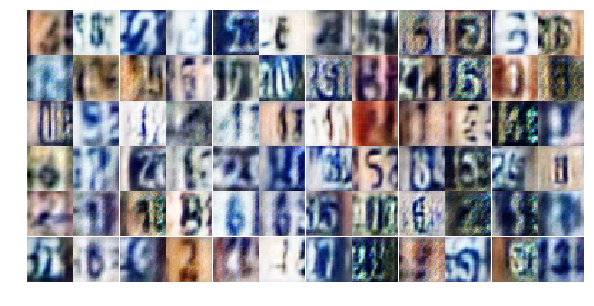

Epoch 7/25... Discriminator Loss: 0.3574... Generator Loss: 1.9945
Epoch 7/25... Discriminator Loss: 0.8684... Generator Loss: 0.7722
Epoch 7/25... Discriminator Loss: 0.9790... Generator Loss: 0.7596
Epoch 7/25... Discriminator Loss: 0.5978... Generator Loss: 1.5604
Epoch 7/25... Discriminator Loss: 0.5328... Generator Loss: 1.4173
Epoch 7/25... Discriminator Loss: 1.2882... Generator Loss: 0.5298
Epoch 7/25... Discriminator Loss: 1.4726... Generator Loss: 0.3666
Epoch 7/25... Discriminator Loss: 0.6480... Generator Loss: 1.1326
Epoch 7/25... Discriminator Loss: 0.8520... Generator Loss: 0.8388
Epoch 7/25... Discriminator Loss: 0.7228... Generator Loss: 0.9287


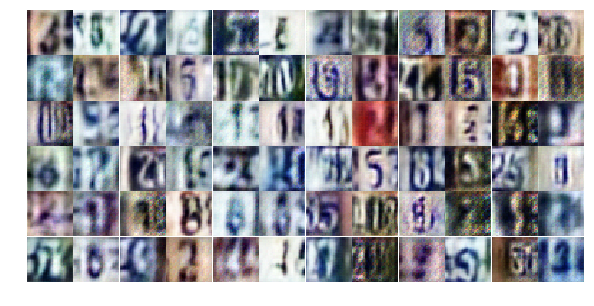

Epoch 7/25... Discriminator Loss: 0.5391... Generator Loss: 1.5342
Epoch 8/25... Discriminator Loss: 0.7564... Generator Loss: 0.8801
Epoch 8/25... Discriminator Loss: 0.7801... Generator Loss: 0.8691
Epoch 8/25... Discriminator Loss: 0.5986... Generator Loss: 1.1407
Epoch 8/25... Discriminator Loss: 0.5769... Generator Loss: 1.2378
Epoch 8/25... Discriminator Loss: 1.0376... Generator Loss: 0.6494
Epoch 8/25... Discriminator Loss: 0.7288... Generator Loss: 0.9905
Epoch 8/25... Discriminator Loss: 0.5152... Generator Loss: 1.8880
Epoch 8/25... Discriminator Loss: 0.9882... Generator Loss: 0.7484
Epoch 8/25... Discriminator Loss: 0.7060... Generator Loss: 1.0992


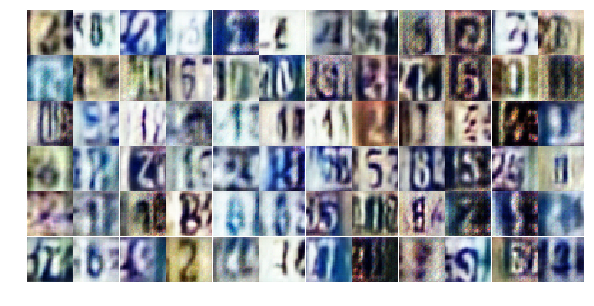

Epoch 8/25... Discriminator Loss: 0.5322... Generator Loss: 1.6215
Epoch 8/25... Discriminator Loss: 0.5289... Generator Loss: 1.1601
Epoch 8/25... Discriminator Loss: 0.6370... Generator Loss: 1.7527
Epoch 8/25... Discriminator Loss: 0.4317... Generator Loss: 1.6457
Epoch 8/25... Discriminator Loss: 0.6850... Generator Loss: 1.0886
Epoch 8/25... Discriminator Loss: 0.8587... Generator Loss: 2.7554
Epoch 8/25... Discriminator Loss: 0.7126... Generator Loss: 1.1057
Epoch 8/25... Discriminator Loss: 0.9465... Generator Loss: 0.8065
Epoch 8/25... Discriminator Loss: 0.7045... Generator Loss: 1.0279
Epoch 8/25... Discriminator Loss: 1.1228... Generator Loss: 0.5554


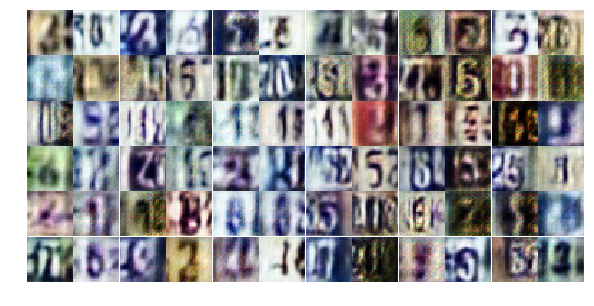

Epoch 8/25... Discriminator Loss: 0.5879... Generator Loss: 1.1052
Epoch 8/25... Discriminator Loss: 0.5663... Generator Loss: 1.1608
Epoch 8/25... Discriminator Loss: 0.8061... Generator Loss: 0.9124
Epoch 8/25... Discriminator Loss: 0.8568... Generator Loss: 2.6101
Epoch 8/25... Discriminator Loss: 0.7718... Generator Loss: 0.9071
Epoch 8/25... Discriminator Loss: 0.8619... Generator Loss: 0.7976
Epoch 8/25... Discriminator Loss: 0.5604... Generator Loss: 1.2529
Epoch 8/25... Discriminator Loss: 0.5031... Generator Loss: 1.4278
Epoch 8/25... Discriminator Loss: 0.6955... Generator Loss: 1.8657
Epoch 8/25... Discriminator Loss: 0.7247... Generator Loss: 0.9540


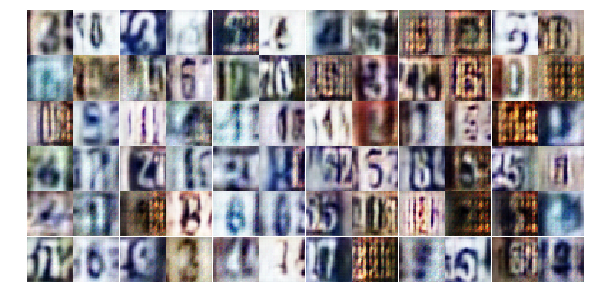

Epoch 8/25... Discriminator Loss: 0.5708... Generator Loss: 1.4216
Epoch 8/25... Discriminator Loss: 0.7607... Generator Loss: 0.9131
Epoch 8/25... Discriminator Loss: 0.4609... Generator Loss: 1.5102
Epoch 8/25... Discriminator Loss: 0.9127... Generator Loss: 0.6556
Epoch 8/25... Discriminator Loss: 1.2159... Generator Loss: 0.5335
Epoch 8/25... Discriminator Loss: 0.6163... Generator Loss: 1.0066
Epoch 8/25... Discriminator Loss: 0.9818... Generator Loss: 0.6753
Epoch 8/25... Discriminator Loss: 0.7385... Generator Loss: 1.0070
Epoch 8/25... Discriminator Loss: 0.6716... Generator Loss: 1.0422
Epoch 8/25... Discriminator Loss: 0.5269... Generator Loss: 1.2953


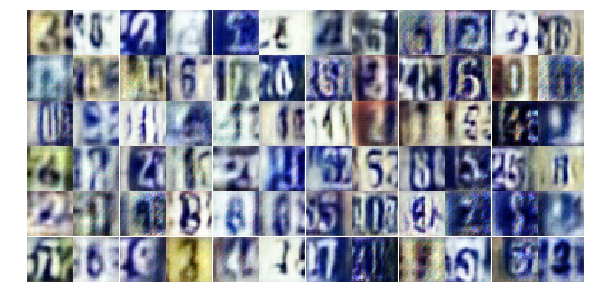

Epoch 8/25... Discriminator Loss: 0.4979... Generator Loss: 1.1595
Epoch 8/25... Discriminator Loss: 1.1035... Generator Loss: 0.6365
Epoch 8/25... Discriminator Loss: 0.5475... Generator Loss: 1.3179
Epoch 8/25... Discriminator Loss: 0.4523... Generator Loss: 1.5710
Epoch 8/25... Discriminator Loss: 0.6233... Generator Loss: 1.1820
Epoch 8/25... Discriminator Loss: 1.1607... Generator Loss: 0.5510
Epoch 8/25... Discriminator Loss: 0.8276... Generator Loss: 0.7835
Epoch 8/25... Discriminator Loss: 0.5833... Generator Loss: 1.3456
Epoch 8/25... Discriminator Loss: 0.6883... Generator Loss: 1.0423
Epoch 8/25... Discriminator Loss: 0.8066... Generator Loss: 0.8537


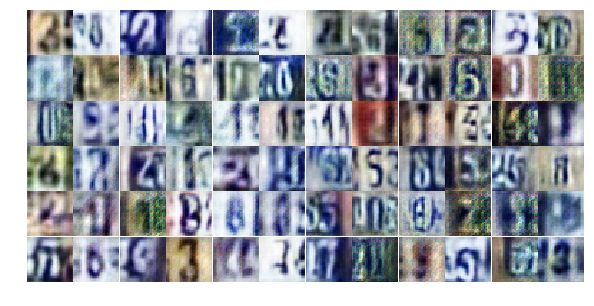

Epoch 8/25... Discriminator Loss: 0.4998... Generator Loss: 1.2738
Epoch 8/25... Discriminator Loss: 0.3536... Generator Loss: 1.8127
Epoch 8/25... Discriminator Loss: 2.0879... Generator Loss: 4.9424
Epoch 8/25... Discriminator Loss: 0.8244... Generator Loss: 1.5421
Epoch 8/25... Discriminator Loss: 0.3813... Generator Loss: 2.0273
Epoch 8/25... Discriminator Loss: 1.0101... Generator Loss: 0.6563
Epoch 8/25... Discriminator Loss: 0.7421... Generator Loss: 0.8414
Epoch 8/25... Discriminator Loss: 0.8767... Generator Loss: 2.7453
Epoch 9/25... Discriminator Loss: 1.0211... Generator Loss: 0.6542
Epoch 9/25... Discriminator Loss: 0.8147... Generator Loss: 0.7733


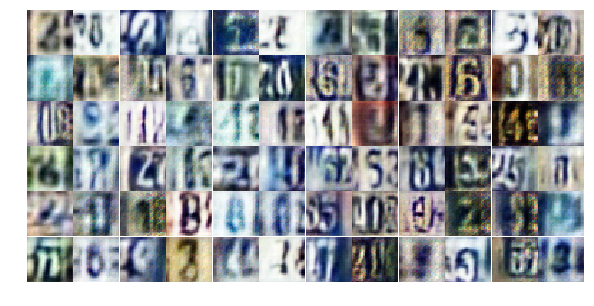

Epoch 9/25... Discriminator Loss: 0.4780... Generator Loss: 1.5005
Epoch 9/25... Discriminator Loss: 0.6012... Generator Loss: 2.3474
Epoch 9/25... Discriminator Loss: 0.9319... Generator Loss: 0.6720
Epoch 9/25... Discriminator Loss: 0.4358... Generator Loss: 1.7124
Epoch 9/25... Discriminator Loss: 1.0487... Generator Loss: 0.6268
Epoch 9/25... Discriminator Loss: 0.8923... Generator Loss: 3.9361
Epoch 9/25... Discriminator Loss: 0.6588... Generator Loss: 1.2929
Epoch 9/25... Discriminator Loss: 0.5581... Generator Loss: 1.1422
Epoch 9/25... Discriminator Loss: 0.7544... Generator Loss: 0.9315
Epoch 9/25... Discriminator Loss: 0.5930... Generator Loss: 1.7729


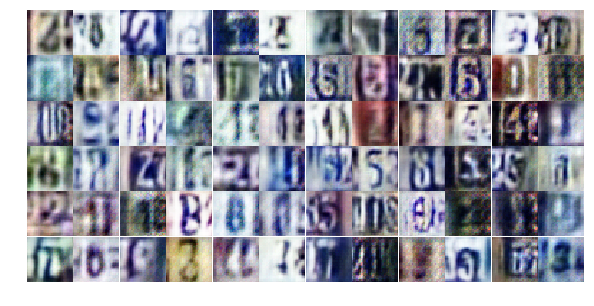

Epoch 9/25... Discriminator Loss: 0.7403... Generator Loss: 0.8660
Epoch 9/25... Discriminator Loss: 1.2686... Generator Loss: 0.4857
Epoch 9/25... Discriminator Loss: 0.6961... Generator Loss: 1.1648
Epoch 9/25... Discriminator Loss: 0.7534... Generator Loss: 0.9816
Epoch 9/25... Discriminator Loss: 0.4602... Generator Loss: 1.5162
Epoch 9/25... Discriminator Loss: 0.7586... Generator Loss: 1.0630
Epoch 9/25... Discriminator Loss: 0.9195... Generator Loss: 0.7586
Epoch 9/25... Discriminator Loss: 0.5068... Generator Loss: 1.2081
Epoch 9/25... Discriminator Loss: 0.9040... Generator Loss: 0.7055
Epoch 9/25... Discriminator Loss: 0.7102... Generator Loss: 1.4850


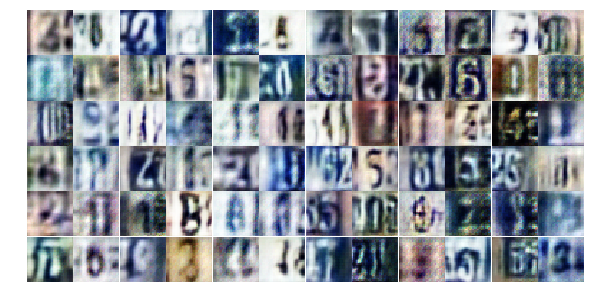

Epoch 9/25... Discriminator Loss: 0.7162... Generator Loss: 1.0707
Epoch 9/25... Discriminator Loss: 0.6141... Generator Loss: 1.4954
Epoch 9/25... Discriminator Loss: 0.7129... Generator Loss: 0.9730
Epoch 9/25... Discriminator Loss: 0.4034... Generator Loss: 1.8905
Epoch 9/25... Discriminator Loss: 0.5863... Generator Loss: 1.8491
Epoch 9/25... Discriminator Loss: 0.5143... Generator Loss: 1.6950
Epoch 9/25... Discriminator Loss: 1.3005... Generator Loss: 0.4489
Epoch 9/25... Discriminator Loss: 0.5584... Generator Loss: 1.8738
Epoch 9/25... Discriminator Loss: 0.5409... Generator Loss: 1.3154
Epoch 9/25... Discriminator Loss: 0.5525... Generator Loss: 1.2530


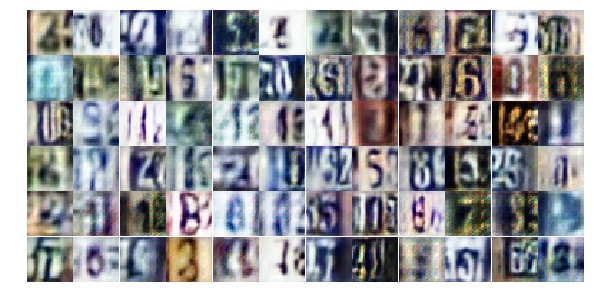

Epoch 9/25... Discriminator Loss: 0.5934... Generator Loss: 1.1551
Epoch 9/25... Discriminator Loss: 0.4588... Generator Loss: 1.4979
Epoch 9/25... Discriminator Loss: 0.8752... Generator Loss: 0.7963
Epoch 9/25... Discriminator Loss: 0.5821... Generator Loss: 1.3986
Epoch 9/25... Discriminator Loss: 0.5279... Generator Loss: 1.3663
Epoch 9/25... Discriminator Loss: 0.4826... Generator Loss: 1.6091
Epoch 9/25... Discriminator Loss: 0.8995... Generator Loss: 2.6429
Epoch 9/25... Discriminator Loss: 0.8442... Generator Loss: 1.0910
Epoch 9/25... Discriminator Loss: 1.1993... Generator Loss: 0.5009
Epoch 9/25... Discriminator Loss: 0.6555... Generator Loss: 1.0995


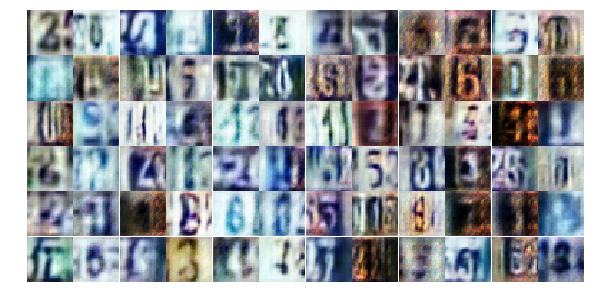

Epoch 9/25... Discriminator Loss: 0.4510... Generator Loss: 1.4323
Epoch 9/25... Discriminator Loss: 0.7879... Generator Loss: 1.7678
Epoch 9/25... Discriminator Loss: 0.3564... Generator Loss: 1.8820
Epoch 9/25... Discriminator Loss: 0.5334... Generator Loss: 1.4183
Epoch 9/25... Discriminator Loss: 0.6927... Generator Loss: 3.3779
Epoch 9/25... Discriminator Loss: 0.5902... Generator Loss: 1.3397
Epoch 9/25... Discriminator Loss: 0.9125... Generator Loss: 0.7561
Epoch 9/25... Discriminator Loss: 0.6030... Generator Loss: 1.1381
Epoch 9/25... Discriminator Loss: 0.5811... Generator Loss: 1.9694
Epoch 9/25... Discriminator Loss: 0.6173... Generator Loss: 1.9112


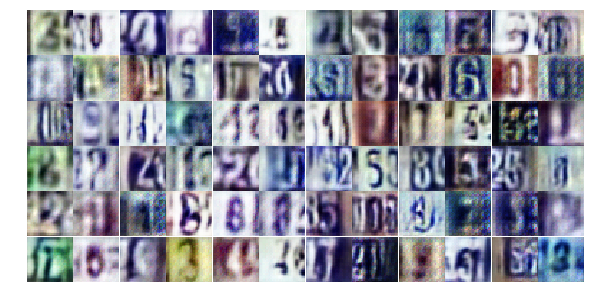

Epoch 9/25... Discriminator Loss: 0.6621... Generator Loss: 1.1608
Epoch 9/25... Discriminator Loss: 0.9930... Generator Loss: 2.5105
Epoch 9/25... Discriminator Loss: 0.7875... Generator Loss: 0.8575
Epoch 9/25... Discriminator Loss: 1.6238... Generator Loss: 0.2964
Epoch 9/25... Discriminator Loss: 0.5054... Generator Loss: 1.7857
Epoch 10/25... Discriminator Loss: 0.5379... Generator Loss: 1.1632
Epoch 10/25... Discriminator Loss: 0.5897... Generator Loss: 1.2588
Epoch 10/25... Discriminator Loss: 0.9710... Generator Loss: 0.6934
Epoch 10/25... Discriminator Loss: 0.8021... Generator Loss: 0.9013
Epoch 10/25... Discriminator Loss: 1.2796... Generator Loss: 0.4806


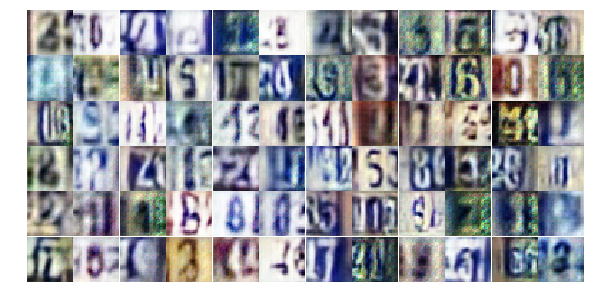

Epoch 10/25... Discriminator Loss: 1.1732... Generator Loss: 0.5191
Epoch 10/25... Discriminator Loss: 0.4776... Generator Loss: 1.4418
Epoch 10/25... Discriminator Loss: 0.6058... Generator Loss: 1.1121
Epoch 10/25... Discriminator Loss: 0.6200... Generator Loss: 1.4090
Epoch 10/25... Discriminator Loss: 0.5850... Generator Loss: 1.3414
Epoch 10/25... Discriminator Loss: 0.9357... Generator Loss: 0.6379
Epoch 10/25... Discriminator Loss: 0.5228... Generator Loss: 1.2248
Epoch 10/25... Discriminator Loss: 1.1057... Generator Loss: 0.5678
Epoch 10/25... Discriminator Loss: 1.2397... Generator Loss: 0.4883
Epoch 10/25... Discriminator Loss: 0.7707... Generator Loss: 0.9630


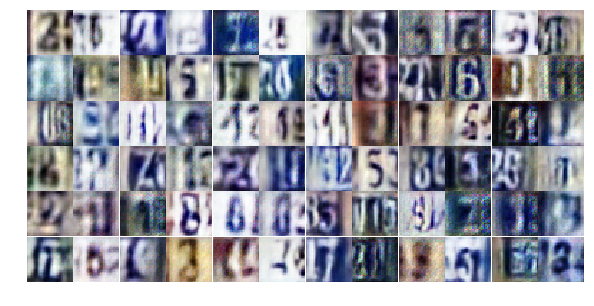

Epoch 10/25... Discriminator Loss: 0.4999... Generator Loss: 1.8165
Epoch 10/25... Discriminator Loss: 1.0381... Generator Loss: 0.6282
Epoch 10/25... Discriminator Loss: 0.6494... Generator Loss: 1.0588
Epoch 10/25... Discriminator Loss: 0.8726... Generator Loss: 0.7598
Epoch 10/25... Discriminator Loss: 0.5805... Generator Loss: 1.8319
Epoch 10/25... Discriminator Loss: 0.4019... Generator Loss: 1.4726
Epoch 10/25... Discriminator Loss: 0.7479... Generator Loss: 0.8481
Epoch 10/25... Discriminator Loss: 0.5226... Generator Loss: 1.2260
Epoch 10/25... Discriminator Loss: 1.0614... Generator Loss: 1.2401
Epoch 10/25... Discriminator Loss: 0.4304... Generator Loss: 1.6814


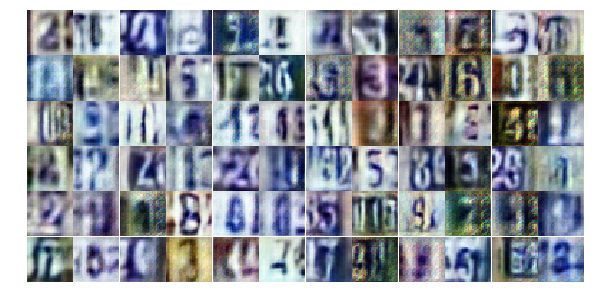

Epoch 10/25... Discriminator Loss: 1.2139... Generator Loss: 0.5092
Epoch 10/25... Discriminator Loss: 0.6113... Generator Loss: 1.2764
Epoch 10/25... Discriminator Loss: 0.4467... Generator Loss: 1.6278
Epoch 10/25... Discriminator Loss: 0.3793... Generator Loss: 1.8663
Epoch 10/25... Discriminator Loss: 1.7076... Generator Loss: 0.2417
Epoch 10/25... Discriminator Loss: 0.7151... Generator Loss: 0.9476
Epoch 10/25... Discriminator Loss: 0.2856... Generator Loss: 2.2164
Epoch 10/25... Discriminator Loss: 0.7149... Generator Loss: 1.0092
Epoch 10/25... Discriminator Loss: 0.4871... Generator Loss: 1.2827
Epoch 10/25... Discriminator Loss: 1.3903... Generator Loss: 0.7190


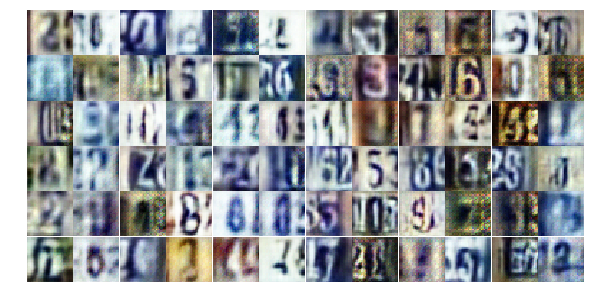

Epoch 10/25... Discriminator Loss: 0.6886... Generator Loss: 1.2574
Epoch 10/25... Discriminator Loss: 0.5477... Generator Loss: 1.3081
Epoch 10/25... Discriminator Loss: 0.3894... Generator Loss: 1.9065
Epoch 10/25... Discriminator Loss: 0.6567... Generator Loss: 1.2043
Epoch 10/25... Discriminator Loss: 1.3998... Generator Loss: 0.4415
Epoch 10/25... Discriminator Loss: 0.6909... Generator Loss: 1.7442
Epoch 10/25... Discriminator Loss: 0.6366... Generator Loss: 1.3102
Epoch 10/25... Discriminator Loss: 0.7030... Generator Loss: 0.9722
Epoch 10/25... Discriminator Loss: 1.3148... Generator Loss: 4.8438
Epoch 10/25... Discriminator Loss: 0.7276... Generator Loss: 0.9921


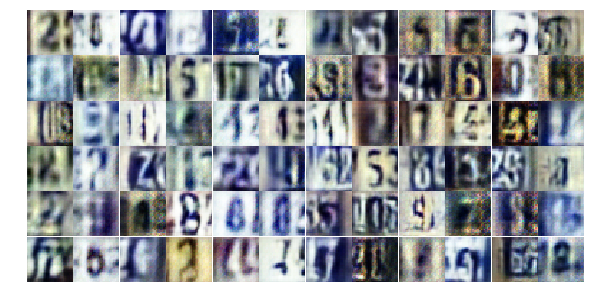

Epoch 10/25... Discriminator Loss: 0.9497... Generator Loss: 0.7225
Epoch 10/25... Discriminator Loss: 0.6496... Generator Loss: 1.0794
Epoch 10/25... Discriminator Loss: 0.9072... Generator Loss: 0.6996
Epoch 10/25... Discriminator Loss: 0.5777... Generator Loss: 1.2091
Epoch 10/25... Discriminator Loss: 0.5840... Generator Loss: 1.8757
Epoch 10/25... Discriminator Loss: 0.5645... Generator Loss: 1.1735
Epoch 10/25... Discriminator Loss: 0.5195... Generator Loss: 1.5511
Epoch 10/25... Discriminator Loss: 0.5057... Generator Loss: 1.3619
Epoch 10/25... Discriminator Loss: 0.8642... Generator Loss: 1.0920
Epoch 10/25... Discriminator Loss: 0.4684... Generator Loss: 1.8032


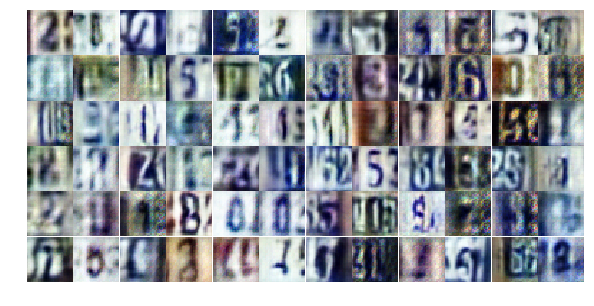

Epoch 10/25... Discriminator Loss: 0.8233... Generator Loss: 0.8350
Epoch 10/25... Discriminator Loss: 0.6773... Generator Loss: 0.9618
Epoch 10/25... Discriminator Loss: 0.8670... Generator Loss: 0.7395
Epoch 11/25... Discriminator Loss: 0.8402... Generator Loss: 0.8203
Epoch 11/25... Discriminator Loss: 0.5316... Generator Loss: 1.1860
Epoch 11/25... Discriminator Loss: 1.0475... Generator Loss: 0.5815
Epoch 11/25... Discriminator Loss: 0.9648... Generator Loss: 0.6787
Epoch 11/25... Discriminator Loss: 0.4306... Generator Loss: 1.9433
Epoch 11/25... Discriminator Loss: 1.8711... Generator Loss: 0.2282
Epoch 11/25... Discriminator Loss: 0.3562... Generator Loss: 1.9720


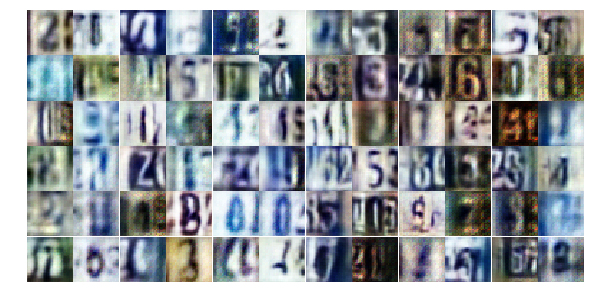

Epoch 11/25... Discriminator Loss: 0.3756... Generator Loss: 1.6232
Epoch 11/25... Discriminator Loss: 0.7755... Generator Loss: 0.8038
Epoch 11/25... Discriminator Loss: 0.5183... Generator Loss: 1.2346
Epoch 11/25... Discriminator Loss: 0.5636... Generator Loss: 1.1561
Epoch 11/25... Discriminator Loss: 1.1715... Generator Loss: 3.3546
Epoch 11/25... Discriminator Loss: 0.7363... Generator Loss: 0.8916
Epoch 11/25... Discriminator Loss: 0.7937... Generator Loss: 0.9209
Epoch 11/25... Discriminator Loss: 0.3718... Generator Loss: 1.9304
Epoch 11/25... Discriminator Loss: 0.8420... Generator Loss: 0.7636
Epoch 11/25... Discriminator Loss: 1.2527... Generator Loss: 0.4652


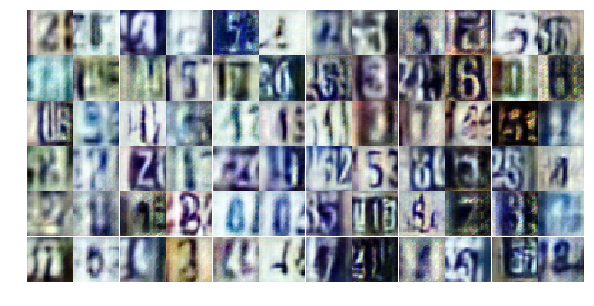

Epoch 11/25... Discriminator Loss: 0.8631... Generator Loss: 1.0447
Epoch 11/25... Discriminator Loss: 0.3953... Generator Loss: 1.8882
Epoch 11/25... Discriminator Loss: 0.6743... Generator Loss: 1.0018
Epoch 11/25... Discriminator Loss: 0.8581... Generator Loss: 0.7677
Epoch 11/25... Discriminator Loss: 1.1312... Generator Loss: 0.5729
Epoch 11/25... Discriminator Loss: 0.6996... Generator Loss: 1.1583
Epoch 11/25... Discriminator Loss: 0.6203... Generator Loss: 1.6284
Epoch 11/25... Discriminator Loss: 0.7654... Generator Loss: 1.0606
Epoch 11/25... Discriminator Loss: 0.3958... Generator Loss: 1.7056
Epoch 11/25... Discriminator Loss: 0.9797... Generator Loss: 0.6768


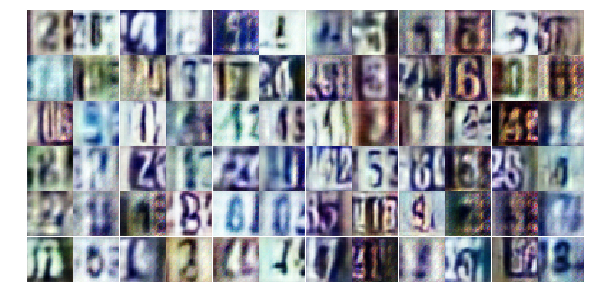

Epoch 11/25... Discriminator Loss: 1.1134... Generator Loss: 0.5690
Epoch 11/25... Discriminator Loss: 0.6571... Generator Loss: 1.0255
Epoch 11/25... Discriminator Loss: 0.9371... Generator Loss: 0.7230
Epoch 11/25... Discriminator Loss: 0.4520... Generator Loss: 1.3484
Epoch 11/25... Discriminator Loss: 0.6589... Generator Loss: 1.0497
Epoch 11/25... Discriminator Loss: 1.0298... Generator Loss: 0.6307
Epoch 11/25... Discriminator Loss: 0.8720... Generator Loss: 1.1139
Epoch 11/25... Discriminator Loss: 1.5035... Generator Loss: 0.3474
Epoch 11/25... Discriminator Loss: 0.5668... Generator Loss: 1.1325
Epoch 11/25... Discriminator Loss: 1.1297... Generator Loss: 0.5779


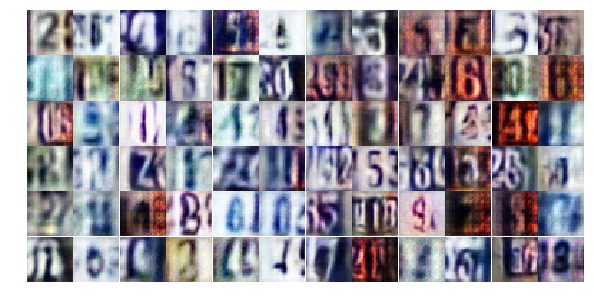

Epoch 11/25... Discriminator Loss: 0.6193... Generator Loss: 1.0089
Epoch 11/25... Discriminator Loss: 0.5400... Generator Loss: 1.1716
Epoch 11/25... Discriminator Loss: 0.6879... Generator Loss: 1.0309
Epoch 11/25... Discriminator Loss: 0.5491... Generator Loss: 1.8074
Epoch 11/25... Discriminator Loss: 1.1070... Generator Loss: 0.5612
Epoch 11/25... Discriminator Loss: 0.5469... Generator Loss: 1.1992
Epoch 11/25... Discriminator Loss: 0.3195... Generator Loss: 2.1100
Epoch 11/25... Discriminator Loss: 2.0443... Generator Loss: 4.0469
Epoch 11/25... Discriminator Loss: 2.2938... Generator Loss: 0.2146
Epoch 11/25... Discriminator Loss: 0.6856... Generator Loss: 1.1377


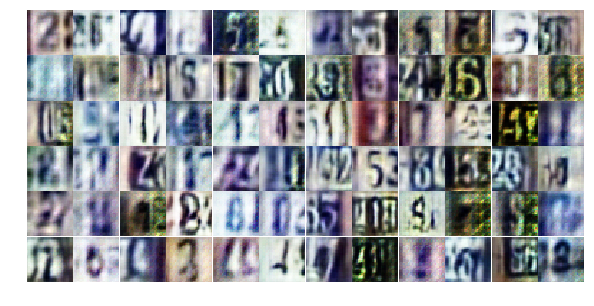

Epoch 11/25... Discriminator Loss: 0.9403... Generator Loss: 0.7719
Epoch 11/25... Discriminator Loss: 0.3374... Generator Loss: 2.0948
Epoch 11/25... Discriminator Loss: 0.7234... Generator Loss: 0.9983
Epoch 11/25... Discriminator Loss: 0.8863... Generator Loss: 0.7849
Epoch 11/25... Discriminator Loss: 0.8604... Generator Loss: 0.8064
Epoch 11/25... Discriminator Loss: 1.0020... Generator Loss: 0.6750
Epoch 11/25... Discriminator Loss: 0.5694... Generator Loss: 1.2786
Epoch 11/25... Discriminator Loss: 0.4680... Generator Loss: 1.6637
Epoch 11/25... Discriminator Loss: 0.7948... Generator Loss: 1.1626
Epoch 11/25... Discriminator Loss: 0.7412... Generator Loss: 0.9718


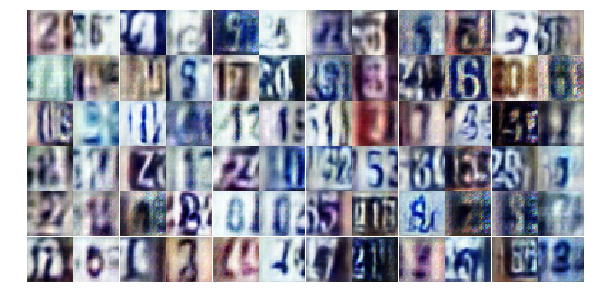

Epoch 12/25... Discriminator Loss: 0.8434... Generator Loss: 2.5611
Epoch 12/25... Discriminator Loss: 0.8316... Generator Loss: 1.0482
Epoch 12/25... Discriminator Loss: 0.8653... Generator Loss: 0.7870
Epoch 12/25... Discriminator Loss: 0.9141... Generator Loss: 0.7701
Epoch 12/25... Discriminator Loss: 0.4098... Generator Loss: 1.6095
Epoch 12/25... Discriminator Loss: 0.6565... Generator Loss: 1.1806
Epoch 12/25... Discriminator Loss: 0.6134... Generator Loss: 1.1173
Epoch 12/25... Discriminator Loss: 0.6308... Generator Loss: 1.3986
Epoch 12/25... Discriminator Loss: 0.5925... Generator Loss: 1.3105
Epoch 12/25... Discriminator Loss: 1.2294... Generator Loss: 0.5288


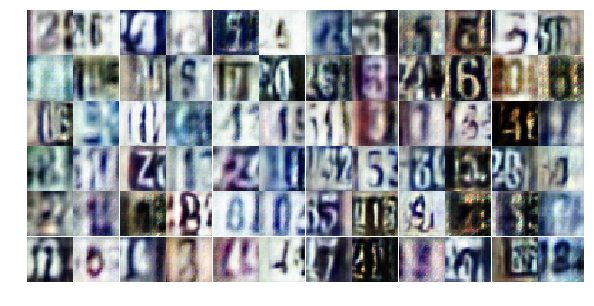

Epoch 12/25... Discriminator Loss: 0.4965... Generator Loss: 1.4174
Epoch 12/25... Discriminator Loss: 0.7233... Generator Loss: 0.9440
Epoch 12/25... Discriminator Loss: 0.6992... Generator Loss: 1.1113
Epoch 12/25... Discriminator Loss: 1.6633... Generator Loss: 4.0637
Epoch 12/25... Discriminator Loss: 0.5314... Generator Loss: 1.7025
Epoch 12/25... Discriminator Loss: 1.1352... Generator Loss: 0.5648
Epoch 12/25... Discriminator Loss: 1.7310... Generator Loss: 0.2628
Epoch 12/25... Discriminator Loss: 0.4442... Generator Loss: 1.5985
Epoch 12/25... Discriminator Loss: 0.4564... Generator Loss: 1.4032
Epoch 12/25... Discriminator Loss: 0.6385... Generator Loss: 1.2065


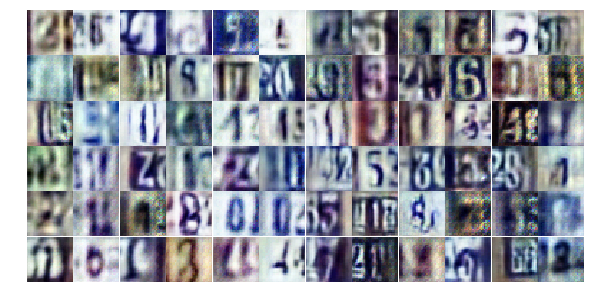

Epoch 12/25... Discriminator Loss: 0.6226... Generator Loss: 1.0724
Epoch 12/25... Discriminator Loss: 0.4282... Generator Loss: 2.4981
Epoch 12/25... Discriminator Loss: 0.8423... Generator Loss: 0.8358
Epoch 12/25... Discriminator Loss: 0.3164... Generator Loss: 1.9523
Epoch 12/25... Discriminator Loss: 0.3342... Generator Loss: 1.7787
Epoch 12/25... Discriminator Loss: 0.4553... Generator Loss: 1.3958
Epoch 12/25... Discriminator Loss: 0.4527... Generator Loss: 1.4277
Epoch 12/25... Discriminator Loss: 0.3562... Generator Loss: 1.7040
Epoch 12/25... Discriminator Loss: 0.6883... Generator Loss: 1.0422
Epoch 12/25... Discriminator Loss: 0.5978... Generator Loss: 1.4828


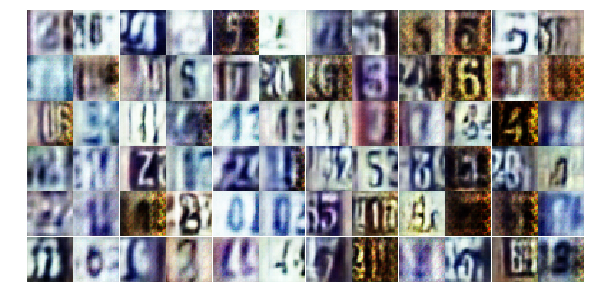

Epoch 12/25... Discriminator Loss: 0.6605... Generator Loss: 1.1194
Epoch 12/25... Discriminator Loss: 0.8821... Generator Loss: 0.9514
Epoch 12/25... Discriminator Loss: 0.8242... Generator Loss: 0.7720
Epoch 12/25... Discriminator Loss: 1.6588... Generator Loss: 0.2725
Epoch 12/25... Discriminator Loss: 0.4116... Generator Loss: 2.0645
Epoch 12/25... Discriminator Loss: 0.6657... Generator Loss: 1.1681
Epoch 12/25... Discriminator Loss: 1.0362... Generator Loss: 0.6683
Epoch 12/25... Discriminator Loss: 0.8742... Generator Loss: 0.8734
Epoch 12/25... Discriminator Loss: 0.6308... Generator Loss: 1.1753
Epoch 12/25... Discriminator Loss: 0.2966... Generator Loss: 1.7348


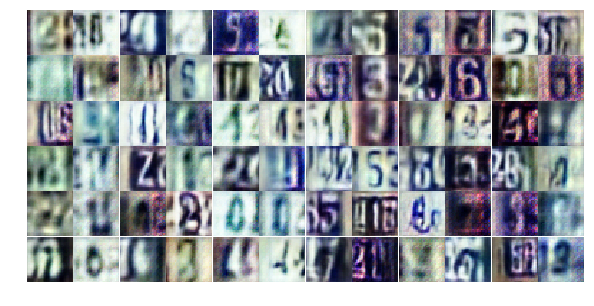

Epoch 12/25... Discriminator Loss: 0.5738... Generator Loss: 1.1164
Epoch 12/25... Discriminator Loss: 0.4884... Generator Loss: 1.2854
Epoch 12/25... Discriminator Loss: 0.3682... Generator Loss: 1.6299
Epoch 12/25... Discriminator Loss: 0.7020... Generator Loss: 1.0072
Epoch 12/25... Discriminator Loss: 1.6303... Generator Loss: 0.3390
Epoch 12/25... Discriminator Loss: 0.8271... Generator Loss: 0.8652
Epoch 12/25... Discriminator Loss: 0.6986... Generator Loss: 1.3020
Epoch 12/25... Discriminator Loss: 0.7437... Generator Loss: 0.9500
Epoch 12/25... Discriminator Loss: 0.4282... Generator Loss: 1.5021
Epoch 12/25... Discriminator Loss: 0.6920... Generator Loss: 0.9457


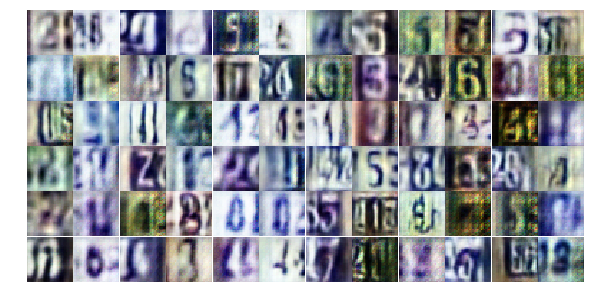

Epoch 12/25... Discriminator Loss: 1.7741... Generator Loss: 0.2798
Epoch 12/25... Discriminator Loss: 0.9543... Generator Loss: 0.7281
Epoch 12/25... Discriminator Loss: 0.5181... Generator Loss: 1.2095
Epoch 12/25... Discriminator Loss: 0.5750... Generator Loss: 1.5998
Epoch 12/25... Discriminator Loss: 0.4566... Generator Loss: 1.3042
Epoch 12/25... Discriminator Loss: 0.8436... Generator Loss: 2.1825
Epoch 12/25... Discriminator Loss: 0.9244... Generator Loss: 0.8256
Epoch 13/25... Discriminator Loss: 0.3006... Generator Loss: 2.1437
Epoch 13/25... Discriminator Loss: 0.4586... Generator Loss: 1.5897
Epoch 13/25... Discriminator Loss: 1.3560... Generator Loss: 0.4292


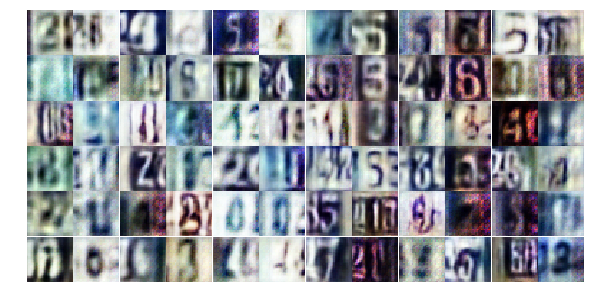

Epoch 13/25... Discriminator Loss: 0.7024... Generator Loss: 1.0460
Epoch 13/25... Discriminator Loss: 0.6772... Generator Loss: 0.9993
Epoch 13/25... Discriminator Loss: 0.9776... Generator Loss: 0.8753
Epoch 13/25... Discriminator Loss: 1.0159... Generator Loss: 0.6546
Epoch 13/25... Discriminator Loss: 0.8136... Generator Loss: 0.8395
Epoch 13/25... Discriminator Loss: 0.6297... Generator Loss: 1.4514
Epoch 13/25... Discriminator Loss: 0.2720... Generator Loss: 1.9391
Epoch 13/25... Discriminator Loss: 0.5796... Generator Loss: 1.0929
Epoch 13/25... Discriminator Loss: 0.7197... Generator Loss: 0.9258
Epoch 13/25... Discriminator Loss: 0.4465... Generator Loss: 1.7008


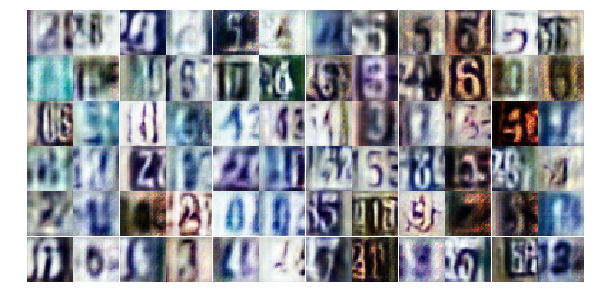

Epoch 13/25... Discriminator Loss: 0.7586... Generator Loss: 0.9591
Epoch 13/25... Discriminator Loss: 0.4736... Generator Loss: 1.4911
Epoch 13/25... Discriminator Loss: 1.4265... Generator Loss: 0.4122
Epoch 13/25... Discriminator Loss: 0.7742... Generator Loss: 1.0336
Epoch 13/25... Discriminator Loss: 0.7605... Generator Loss: 1.0006
Epoch 13/25... Discriminator Loss: 0.9576... Generator Loss: 0.7370
Epoch 13/25... Discriminator Loss: 0.8108... Generator Loss: 0.9226
Epoch 13/25... Discriminator Loss: 1.5938... Generator Loss: 0.3302
Epoch 13/25... Discriminator Loss: 0.7392... Generator Loss: 0.8570
Epoch 13/25... Discriminator Loss: 0.9432... Generator Loss: 0.6573


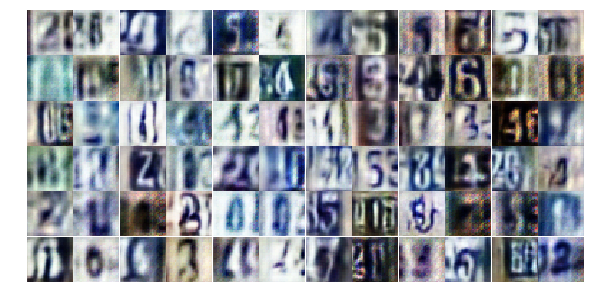

Epoch 13/25... Discriminator Loss: 0.7103... Generator Loss: 0.9957
Epoch 13/25... Discriminator Loss: 0.4598... Generator Loss: 1.8325
Epoch 13/25... Discriminator Loss: 0.6232... Generator Loss: 1.3806
Epoch 13/25... Discriminator Loss: 0.6623... Generator Loss: 1.0458
Epoch 13/25... Discriminator Loss: 0.7081... Generator Loss: 0.9188
Epoch 13/25... Discriminator Loss: 0.5287... Generator Loss: 1.3729
Epoch 13/25... Discriminator Loss: 0.7087... Generator Loss: 3.8558
Epoch 13/25... Discriminator Loss: 0.5180... Generator Loss: 1.5511
Epoch 13/25... Discriminator Loss: 0.6585... Generator Loss: 1.0331
Epoch 13/25... Discriminator Loss: 0.5452... Generator Loss: 1.3155


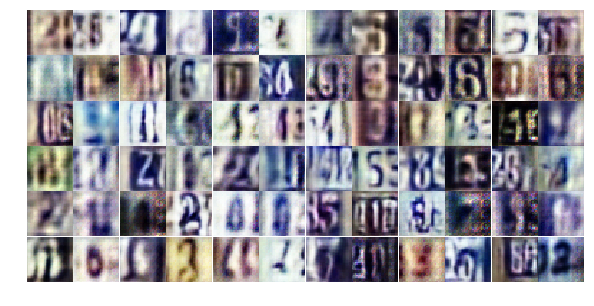

Epoch 13/25... Discriminator Loss: 0.9689... Generator Loss: 0.6874
Epoch 13/25... Discriminator Loss: 0.8560... Generator Loss: 1.3505
Epoch 13/25... Discriminator Loss: 1.7836... Generator Loss: 0.2937
Epoch 13/25... Discriminator Loss: 1.2235... Generator Loss: 0.5864
Epoch 13/25... Discriminator Loss: 0.5854... Generator Loss: 1.2533
Epoch 13/25... Discriminator Loss: 0.5930... Generator Loss: 1.1214
Epoch 13/25... Discriminator Loss: 0.4683... Generator Loss: 1.3341
Epoch 13/25... Discriminator Loss: 1.0514... Generator Loss: 0.6720
Epoch 13/25... Discriminator Loss: 0.5107... Generator Loss: 1.9249
Epoch 13/25... Discriminator Loss: 0.8137... Generator Loss: 0.7885


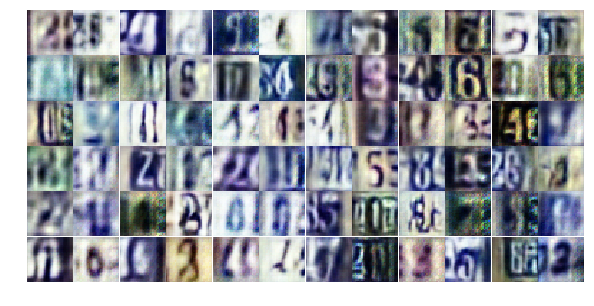

Epoch 13/25... Discriminator Loss: 0.6375... Generator Loss: 1.1133
Epoch 13/25... Discriminator Loss: 0.7843... Generator Loss: 2.2357
Epoch 13/25... Discriminator Loss: 0.9652... Generator Loss: 0.6969
Epoch 13/25... Discriminator Loss: 0.7796... Generator Loss: 0.8087
Epoch 13/25... Discriminator Loss: 0.9662... Generator Loss: 0.7229
Epoch 13/25... Discriminator Loss: 0.5529... Generator Loss: 1.4296
Epoch 13/25... Discriminator Loss: 0.6358... Generator Loss: 1.1012
Epoch 13/25... Discriminator Loss: 0.5078... Generator Loss: 1.3888
Epoch 13/25... Discriminator Loss: 0.8535... Generator Loss: 0.7359
Epoch 13/25... Discriminator Loss: 0.5416... Generator Loss: 1.2979


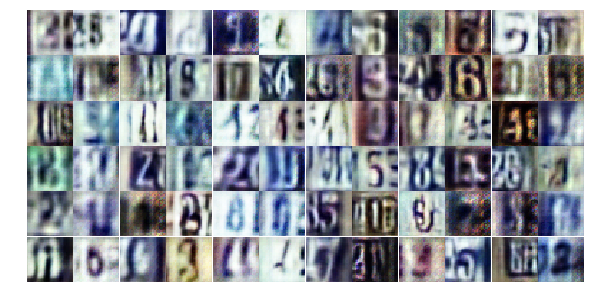

Epoch 13/25... Discriminator Loss: 0.4011... Generator Loss: 1.4667
Epoch 13/25... Discriminator Loss: 1.7080... Generator Loss: 0.3311
Epoch 13/25... Discriminator Loss: 0.6279... Generator Loss: 1.0844
Epoch 13/25... Discriminator Loss: 0.8010... Generator Loss: 0.8377
Epoch 14/25... Discriminator Loss: 1.0894... Generator Loss: 0.5467
Epoch 14/25... Discriminator Loss: 0.5623... Generator Loss: 1.3694
Epoch 14/25... Discriminator Loss: 0.9908... Generator Loss: 0.7083
Epoch 14/25... Discriminator Loss: 0.5756... Generator Loss: 1.4884
Epoch 14/25... Discriminator Loss: 0.5862... Generator Loss: 1.1739
Epoch 14/25... Discriminator Loss: 0.7839... Generator Loss: 0.8750


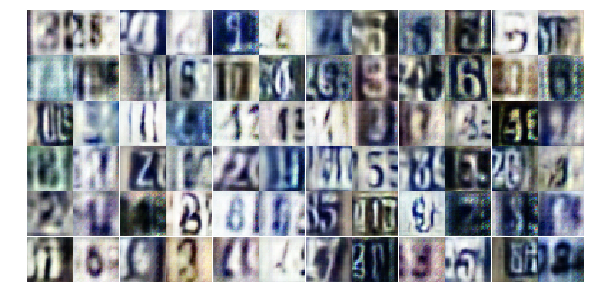

Epoch 14/25... Discriminator Loss: 1.3824... Generator Loss: 3.7002
Epoch 14/25... Discriminator Loss: 0.7797... Generator Loss: 0.9534
Epoch 14/25... Discriminator Loss: 0.5408... Generator Loss: 1.2617
Epoch 14/25... Discriminator Loss: 0.5754... Generator Loss: 1.1935
Epoch 14/25... Discriminator Loss: 0.9399... Generator Loss: 0.7378
Epoch 14/25... Discriminator Loss: 0.5404... Generator Loss: 1.0776
Epoch 14/25... Discriminator Loss: 0.3476... Generator Loss: 1.8107
Epoch 14/25... Discriminator Loss: 1.8237... Generator Loss: 0.2554
Epoch 14/25... Discriminator Loss: 0.8011... Generator Loss: 1.0334
Epoch 14/25... Discriminator Loss: 1.9625... Generator Loss: 0.2423


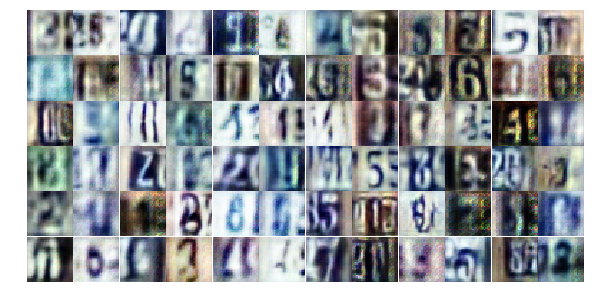

Epoch 14/25... Discriminator Loss: 0.6016... Generator Loss: 1.2937
Epoch 14/25... Discriminator Loss: 0.4478... Generator Loss: 2.2215
Epoch 14/25... Discriminator Loss: 1.2751... Generator Loss: 0.5117
Epoch 14/25... Discriminator Loss: 0.6510... Generator Loss: 1.0787
Epoch 14/25... Discriminator Loss: 0.8596... Generator Loss: 0.9236
Epoch 14/25... Discriminator Loss: 0.7831... Generator Loss: 1.0102
Epoch 14/25... Discriminator Loss: 0.6688... Generator Loss: 1.0279
Epoch 14/25... Discriminator Loss: 1.0863... Generator Loss: 0.5790
Epoch 14/25... Discriminator Loss: 0.4028... Generator Loss: 1.7127
Epoch 14/25... Discriminator Loss: 0.8022... Generator Loss: 0.8364


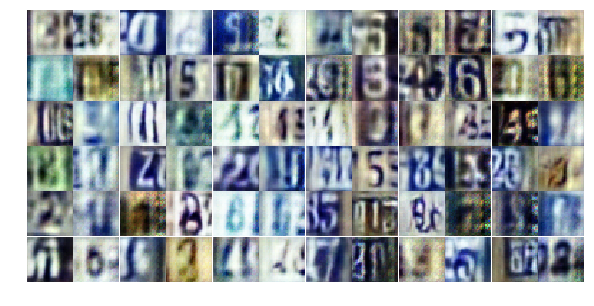

Epoch 14/25... Discriminator Loss: 1.9868... Generator Loss: 0.2613
Epoch 14/25... Discriminator Loss: 0.6321... Generator Loss: 0.9728
Epoch 14/25... Discriminator Loss: 0.5686... Generator Loss: 1.4913
Epoch 14/25... Discriminator Loss: 0.4067... Generator Loss: 1.5119
Epoch 14/25... Discriminator Loss: 0.7796... Generator Loss: 0.8975
Epoch 14/25... Discriminator Loss: 0.7189... Generator Loss: 0.9969
Epoch 14/25... Discriminator Loss: 0.8886... Generator Loss: 0.7440
Epoch 14/25... Discriminator Loss: 0.3882... Generator Loss: 1.5206
Epoch 14/25... Discriminator Loss: 0.3481... Generator Loss: 1.7422
Epoch 14/25... Discriminator Loss: 0.8141... Generator Loss: 1.6540


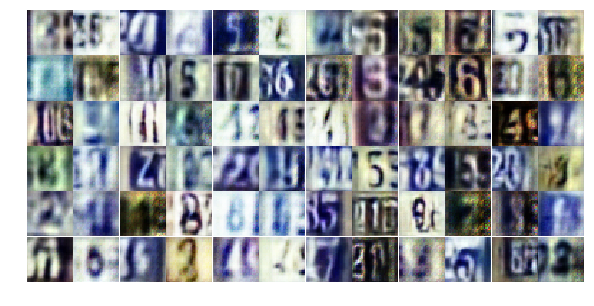

Epoch 14/25... Discriminator Loss: 1.4828... Generator Loss: 0.3792
Epoch 14/25... Discriminator Loss: 0.8099... Generator Loss: 0.9336
Epoch 14/25... Discriminator Loss: 1.3091... Generator Loss: 0.4334
Epoch 14/25... Discriminator Loss: 0.8373... Generator Loss: 0.9063
Epoch 14/25... Discriminator Loss: 0.6324... Generator Loss: 1.1885
Epoch 14/25... Discriminator Loss: 0.5848... Generator Loss: 1.0764
Epoch 14/25... Discriminator Loss: 0.6326... Generator Loss: 1.1601
Epoch 14/25... Discriminator Loss: 0.5718... Generator Loss: 1.2205
Epoch 14/25... Discriminator Loss: 0.9353... Generator Loss: 0.6956
Epoch 14/25... Discriminator Loss: 1.1958... Generator Loss: 0.5646


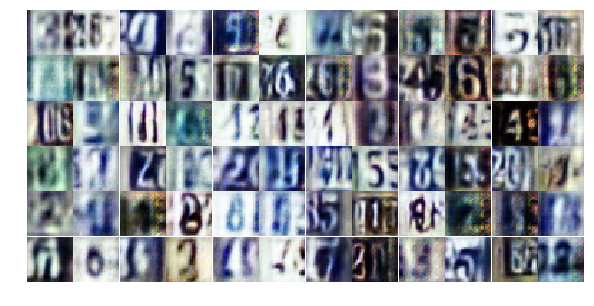

Epoch 14/25... Discriminator Loss: 1.0375... Generator Loss: 0.9620
Epoch 14/25... Discriminator Loss: 1.8285... Generator Loss: 0.2580
Epoch 14/25... Discriminator Loss: 0.5129... Generator Loss: 1.3183
Epoch 14/25... Discriminator Loss: 1.3808... Generator Loss: 0.4380
Epoch 14/25... Discriminator Loss: 0.4104... Generator Loss: 1.8819
Epoch 14/25... Discriminator Loss: 0.7359... Generator Loss: 1.2080
Epoch 14/25... Discriminator Loss: 0.7422... Generator Loss: 1.4910
Epoch 14/25... Discriminator Loss: 0.5201... Generator Loss: 1.2708
Epoch 14/25... Discriminator Loss: 0.7195... Generator Loss: 2.0051
Epoch 14/25... Discriminator Loss: 1.4019... Generator Loss: 0.3697


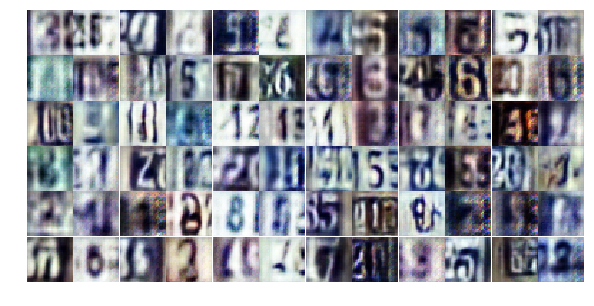

Epoch 14/25... Discriminator Loss: 0.6517... Generator Loss: 1.7833
Epoch 14/25... Discriminator Loss: 0.8977... Generator Loss: 0.7434
Epoch 15/25... Discriminator Loss: 0.5249... Generator Loss: 1.3953
Epoch 15/25... Discriminator Loss: 0.3368... Generator Loss: 2.0834
Epoch 15/25... Discriminator Loss: 0.5959... Generator Loss: 2.3204
Epoch 15/25... Discriminator Loss: 0.9395... Generator Loss: 0.6831
Epoch 15/25... Discriminator Loss: 0.5012... Generator Loss: 1.4686
Epoch 15/25... Discriminator Loss: 0.7473... Generator Loss: 0.9768
Epoch 15/25... Discriminator Loss: 1.8834... Generator Loss: 0.2366
Epoch 15/25... Discriminator Loss: 1.0359... Generator Loss: 0.7405


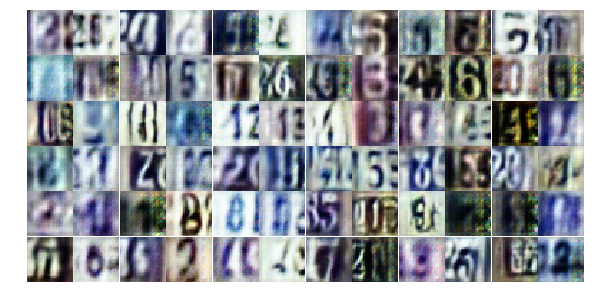

Epoch 15/25... Discriminator Loss: 0.7559... Generator Loss: 0.9455
Epoch 15/25... Discriminator Loss: 0.7457... Generator Loss: 1.8124
Epoch 15/25... Discriminator Loss: 0.8888... Generator Loss: 0.7841
Epoch 15/25... Discriminator Loss: 0.8295... Generator Loss: 0.8835
Epoch 15/25... Discriminator Loss: 0.8138... Generator Loss: 1.0913
Epoch 15/25... Discriminator Loss: 0.6626... Generator Loss: 1.0175
Epoch 15/25... Discriminator Loss: 0.7455... Generator Loss: 0.9349
Epoch 15/25... Discriminator Loss: 0.7127... Generator Loss: 0.9849
Epoch 15/25... Discriminator Loss: 0.3481... Generator Loss: 2.2727
Epoch 15/25... Discriminator Loss: 0.7411... Generator Loss: 1.0919


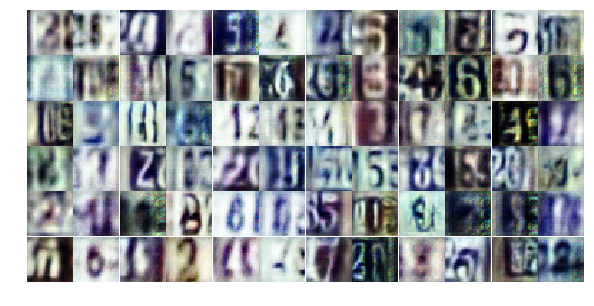

Epoch 15/25... Discriminator Loss: 1.1186... Generator Loss: 0.6345
Epoch 15/25... Discriminator Loss: 0.5113... Generator Loss: 1.3159
Epoch 15/25... Discriminator Loss: 0.5654... Generator Loss: 1.2203
Epoch 15/25... Discriminator Loss: 1.1524... Generator Loss: 0.5693
Epoch 15/25... Discriminator Loss: 1.2041... Generator Loss: 0.5466
Epoch 15/25... Discriminator Loss: 0.7211... Generator Loss: 1.1131
Epoch 15/25... Discriminator Loss: 1.2504... Generator Loss: 0.5563
Epoch 15/25... Discriminator Loss: 0.6536... Generator Loss: 1.0787
Epoch 15/25... Discriminator Loss: 0.6918... Generator Loss: 0.9751
Epoch 15/25... Discriminator Loss: 1.6458... Generator Loss: 0.3889


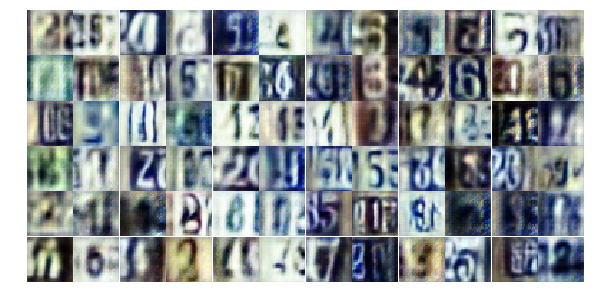

Epoch 15/25... Discriminator Loss: 0.7898... Generator Loss: 1.0542
Epoch 15/25... Discriminator Loss: 0.9626... Generator Loss: 0.8545
Epoch 15/25... Discriminator Loss: 0.4450... Generator Loss: 1.5972
Epoch 15/25... Discriminator Loss: 0.6982... Generator Loss: 1.1943
Epoch 15/25... Discriminator Loss: 0.4128... Generator Loss: 1.7321
Epoch 15/25... Discriminator Loss: 0.8742... Generator Loss: 1.5458
Epoch 15/25... Discriminator Loss: 0.4374... Generator Loss: 1.5430
Epoch 15/25... Discriminator Loss: 0.6414... Generator Loss: 2.0452
Epoch 15/25... Discriminator Loss: 0.4432... Generator Loss: 1.5349
Epoch 15/25... Discriminator Loss: 0.5613... Generator Loss: 1.2520


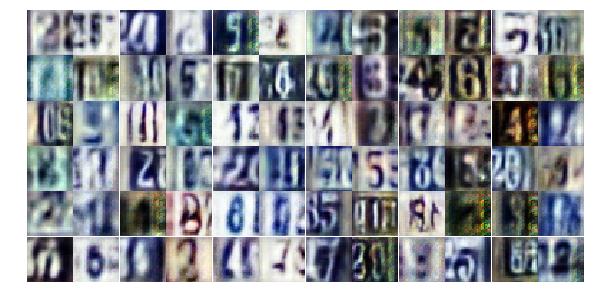

Epoch 15/25... Discriminator Loss: 0.4247... Generator Loss: 1.6594
Epoch 15/25... Discriminator Loss: 1.1454... Generator Loss: 0.6083
Epoch 15/25... Discriminator Loss: 1.1077... Generator Loss: 0.5518
Epoch 15/25... Discriminator Loss: 0.5881... Generator Loss: 1.0882
Epoch 15/25... Discriminator Loss: 0.6825... Generator Loss: 0.9084
Epoch 15/25... Discriminator Loss: 2.1388... Generator Loss: 0.1952
Epoch 15/25... Discriminator Loss: 0.3916... Generator Loss: 2.1042
Epoch 15/25... Discriminator Loss: 0.6604... Generator Loss: 1.5460
Epoch 15/25... Discriminator Loss: 0.7692... Generator Loss: 0.8338
Epoch 15/25... Discriminator Loss: 0.6769... Generator Loss: 1.1632


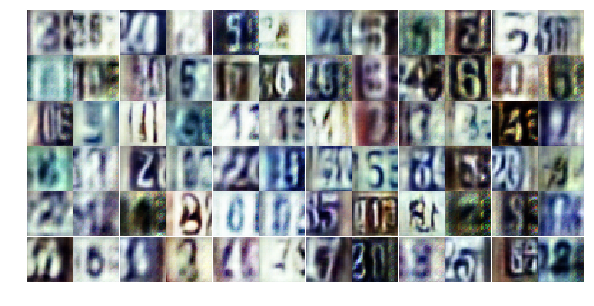

Epoch 15/25... Discriminator Loss: 1.0670... Generator Loss: 0.5676
Epoch 15/25... Discriminator Loss: 1.1821... Generator Loss: 0.5565
Epoch 15/25... Discriminator Loss: 0.6601... Generator Loss: 1.0076
Epoch 15/25... Discriminator Loss: 0.9521... Generator Loss: 1.4408
Epoch 15/25... Discriminator Loss: 0.5050... Generator Loss: 1.4344
Epoch 15/25... Discriminator Loss: 0.7977... Generator Loss: 0.7981
Epoch 15/25... Discriminator Loss: 1.3598... Generator Loss: 0.4515
Epoch 15/25... Discriminator Loss: 0.4367... Generator Loss: 2.2422
Epoch 15/25... Discriminator Loss: 1.1299... Generator Loss: 0.6622
Epoch 16/25... Discriminator Loss: 1.4200... Generator Loss: 0.4419


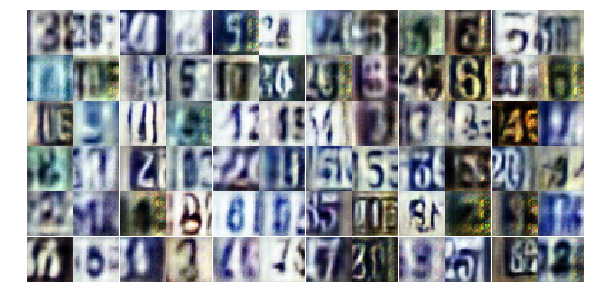

Epoch 16/25... Discriminator Loss: 0.6433... Generator Loss: 1.1681
Epoch 16/25... Discriminator Loss: 0.6992... Generator Loss: 1.5323
Epoch 16/25... Discriminator Loss: 0.8338... Generator Loss: 0.8853
Epoch 16/25... Discriminator Loss: 0.5626... Generator Loss: 1.4600
Epoch 16/25... Discriminator Loss: 0.6922... Generator Loss: 1.5337
Epoch 16/25... Discriminator Loss: 0.7517... Generator Loss: 0.9724
Epoch 16/25... Discriminator Loss: 2.4669... Generator Loss: 0.1262
Epoch 16/25... Discriminator Loss: 1.2928... Generator Loss: 0.5096
Epoch 16/25... Discriminator Loss: 0.7380... Generator Loss: 0.9333
Epoch 16/25... Discriminator Loss: 0.4840... Generator Loss: 1.5716


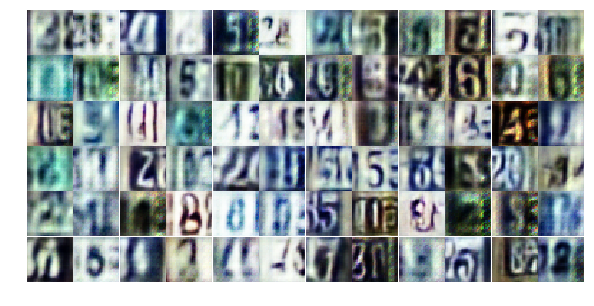

Epoch 16/25... Discriminator Loss: 1.0310... Generator Loss: 0.6942
Epoch 16/25... Discriminator Loss: 0.4393... Generator Loss: 1.6174
Epoch 16/25... Discriminator Loss: 0.6542... Generator Loss: 1.1029
Epoch 16/25... Discriminator Loss: 1.7096... Generator Loss: 0.3369
Epoch 16/25... Discriminator Loss: 0.4968... Generator Loss: 1.2973
Epoch 16/25... Discriminator Loss: 0.5867... Generator Loss: 1.1664
Epoch 16/25... Discriminator Loss: 1.3754... Generator Loss: 0.4185
Epoch 16/25... Discriminator Loss: 0.3223... Generator Loss: 1.6466
Epoch 16/25... Discriminator Loss: 0.4727... Generator Loss: 1.3052
Epoch 16/25... Discriminator Loss: 0.9321... Generator Loss: 0.6896


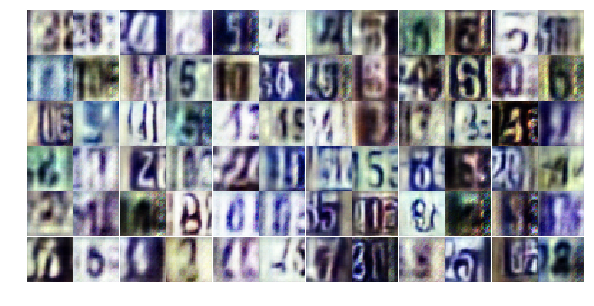

Epoch 16/25... Discriminator Loss: 0.6444... Generator Loss: 1.0233
Epoch 16/25... Discriminator Loss: 0.7334... Generator Loss: 2.3422
Epoch 16/25... Discriminator Loss: 1.2435... Generator Loss: 0.5906
Epoch 16/25... Discriminator Loss: 1.1339... Generator Loss: 0.5552
Epoch 16/25... Discriminator Loss: 0.8318... Generator Loss: 0.8785
Epoch 16/25... Discriminator Loss: 1.4228... Generator Loss: 0.3988
Epoch 16/25... Discriminator Loss: 0.9773... Generator Loss: 0.6851
Epoch 16/25... Discriminator Loss: 0.6000... Generator Loss: 1.1853
Epoch 16/25... Discriminator Loss: 0.8374... Generator Loss: 0.8830
Epoch 16/25... Discriminator Loss: 0.6854... Generator Loss: 1.0371


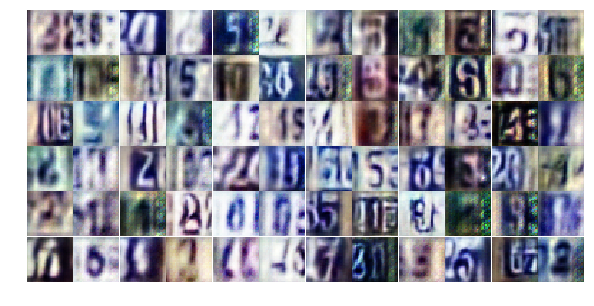

Epoch 16/25... Discriminator Loss: 0.6167... Generator Loss: 1.0341
Epoch 16/25... Discriminator Loss: 0.6201... Generator Loss: 1.1632
Epoch 16/25... Discriminator Loss: 0.7658... Generator Loss: 0.9020
Epoch 16/25... Discriminator Loss: 0.6066... Generator Loss: 1.5072
Epoch 16/25... Discriminator Loss: 0.9261... Generator Loss: 0.9222
Epoch 16/25... Discriminator Loss: 0.7295... Generator Loss: 1.3254
Epoch 16/25... Discriminator Loss: 0.9858... Generator Loss: 0.6692
Epoch 16/25... Discriminator Loss: 0.9034... Generator Loss: 0.7767
Epoch 16/25... Discriminator Loss: 0.7043... Generator Loss: 0.9559
Epoch 16/25... Discriminator Loss: 0.4924... Generator Loss: 1.3349


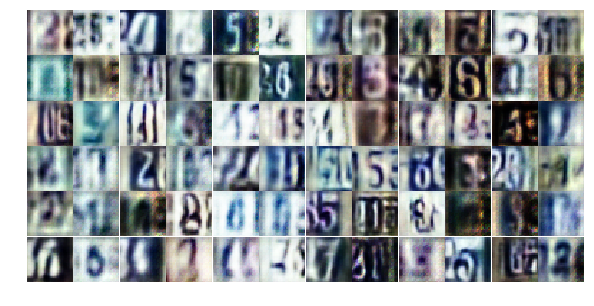

Epoch 16/25... Discriminator Loss: 0.5355... Generator Loss: 1.4722
Epoch 16/25... Discriminator Loss: 1.0251... Generator Loss: 1.3471
Epoch 16/25... Discriminator Loss: 1.1883... Generator Loss: 0.4632
Epoch 16/25... Discriminator Loss: 1.3696... Generator Loss: 2.6534
Epoch 16/25... Discriminator Loss: 0.7916... Generator Loss: 1.3286
Epoch 16/25... Discriminator Loss: 0.7892... Generator Loss: 1.1622
Epoch 16/25... Discriminator Loss: 0.5241... Generator Loss: 1.9354
Epoch 16/25... Discriminator Loss: 0.7941... Generator Loss: 0.8944
Epoch 16/25... Discriminator Loss: 0.7073... Generator Loss: 0.9914
Epoch 16/25... Discriminator Loss: 1.2291... Generator Loss: 0.4967


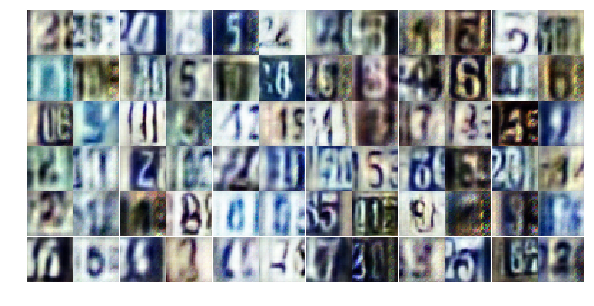

Epoch 16/25... Discriminator Loss: 0.9549... Generator Loss: 0.9164
Epoch 16/25... Discriminator Loss: 0.7489... Generator Loss: 0.8815
Epoch 16/25... Discriminator Loss: 1.0844... Generator Loss: 0.7050
Epoch 16/25... Discriminator Loss: 0.4666... Generator Loss: 1.3239
Epoch 16/25... Discriminator Loss: 0.5441... Generator Loss: 1.2825
Epoch 16/25... Discriminator Loss: 0.8621... Generator Loss: 0.8288
Epoch 17/25... Discriminator Loss: 0.8164... Generator Loss: 0.9021
Epoch 17/25... Discriminator Loss: 0.6530... Generator Loss: 1.5991
Epoch 17/25... Discriminator Loss: 0.7327... Generator Loss: 1.0415
Epoch 17/25... Discriminator Loss: 0.7001... Generator Loss: 1.0458


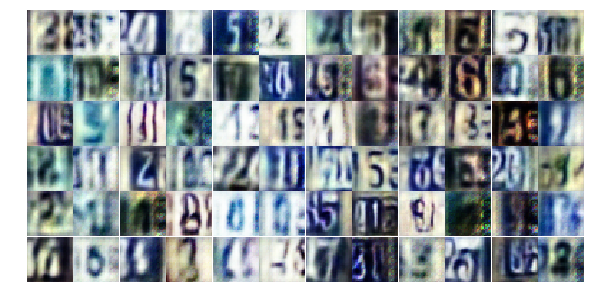

Epoch 17/25... Discriminator Loss: 0.5891... Generator Loss: 1.1951
Epoch 17/25... Discriminator Loss: 0.4358... Generator Loss: 1.5482
Epoch 17/25... Discriminator Loss: 0.6723... Generator Loss: 1.4301
Epoch 17/25... Discriminator Loss: 0.6905... Generator Loss: 1.0051
Epoch 17/25... Discriminator Loss: 1.4526... Generator Loss: 0.4657
Epoch 17/25... Discriminator Loss: 1.0570... Generator Loss: 0.5950
Epoch 17/25... Discriminator Loss: 0.4860... Generator Loss: 1.4858
Epoch 17/25... Discriminator Loss: 0.9819... Generator Loss: 0.6831
Epoch 17/25... Discriminator Loss: 0.3244... Generator Loss: 1.8680
Epoch 17/25... Discriminator Loss: 0.5898... Generator Loss: 1.9665


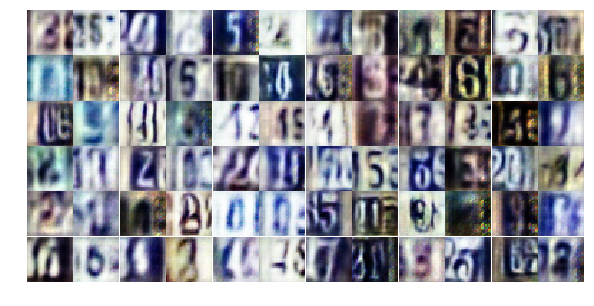

Epoch 17/25... Discriminator Loss: 0.9660... Generator Loss: 0.7278
Epoch 17/25... Discriminator Loss: 0.6492... Generator Loss: 1.1202
Epoch 17/25... Discriminator Loss: 0.7140... Generator Loss: 0.9120
Epoch 17/25... Discriminator Loss: 0.7429... Generator Loss: 1.0071
Epoch 17/25... Discriminator Loss: 1.0442... Generator Loss: 0.7298
Epoch 17/25... Discriminator Loss: 1.1567... Generator Loss: 0.5737
Epoch 17/25... Discriminator Loss: 0.6398... Generator Loss: 1.2276
Epoch 17/25... Discriminator Loss: 0.6178... Generator Loss: 1.1414
Epoch 17/25... Discriminator Loss: 0.8090... Generator Loss: 0.7866
Epoch 17/25... Discriminator Loss: 0.4986... Generator Loss: 1.3242


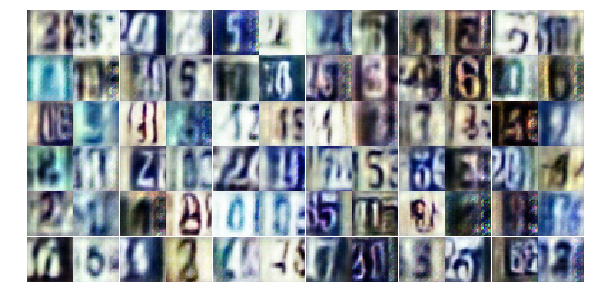

Epoch 17/25... Discriminator Loss: 1.9523... Generator Loss: 0.2217
Epoch 17/25... Discriminator Loss: 0.5785... Generator Loss: 1.2027
Epoch 17/25... Discriminator Loss: 0.3114... Generator Loss: 2.2487
Epoch 17/25... Discriminator Loss: 1.7110... Generator Loss: 0.3564
Epoch 17/25... Discriminator Loss: 1.3198... Generator Loss: 0.5357
Epoch 17/25... Discriminator Loss: 0.6039... Generator Loss: 1.2372
Epoch 17/25... Discriminator Loss: 0.5191... Generator Loss: 1.4310
Epoch 17/25... Discriminator Loss: 0.8249... Generator Loss: 0.8543
Epoch 17/25... Discriminator Loss: 1.1424... Generator Loss: 0.6218
Epoch 17/25... Discriminator Loss: 0.3003... Generator Loss: 2.1278


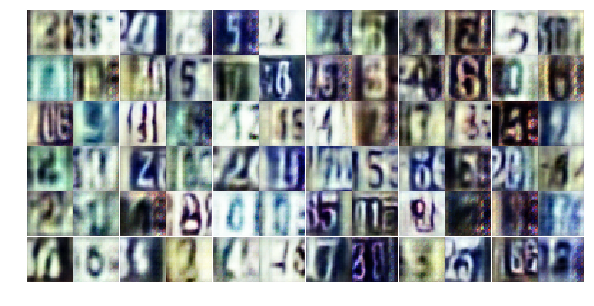

Epoch 17/25... Discriminator Loss: 0.5580... Generator Loss: 1.3674
Epoch 17/25... Discriminator Loss: 0.9359... Generator Loss: 0.7278
Epoch 17/25... Discriminator Loss: 0.6028... Generator Loss: 1.8118
Epoch 17/25... Discriminator Loss: 0.5731... Generator Loss: 1.8427
Epoch 17/25... Discriminator Loss: 0.5306... Generator Loss: 1.2739
Epoch 17/25... Discriminator Loss: 0.4502... Generator Loss: 2.2791
Epoch 17/25... Discriminator Loss: 1.1184... Generator Loss: 0.6126
Epoch 17/25... Discriminator Loss: 0.6313... Generator Loss: 1.1210
Epoch 17/25... Discriminator Loss: 0.3073... Generator Loss: 2.4011
Epoch 17/25... Discriminator Loss: 0.7019... Generator Loss: 0.9664


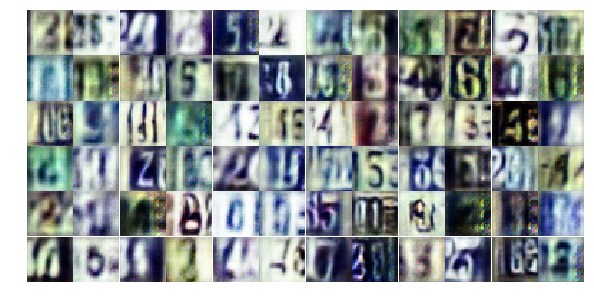

Epoch 17/25... Discriminator Loss: 1.2862... Generator Loss: 0.5670
Epoch 17/25... Discriminator Loss: 0.4211... Generator Loss: 1.6770
Epoch 17/25... Discriminator Loss: 1.0048... Generator Loss: 0.7085
Epoch 17/25... Discriminator Loss: 0.6695... Generator Loss: 1.0915
Epoch 17/25... Discriminator Loss: 1.0667... Generator Loss: 0.6577
Epoch 17/25... Discriminator Loss: 0.7241... Generator Loss: 1.2955
Epoch 17/25... Discriminator Loss: 1.1006... Generator Loss: 0.6070
Epoch 17/25... Discriminator Loss: 1.0591... Generator Loss: 0.6272
Epoch 17/25... Discriminator Loss: 1.5054... Generator Loss: 0.3967
Epoch 17/25... Discriminator Loss: 1.2563... Generator Loss: 0.5008


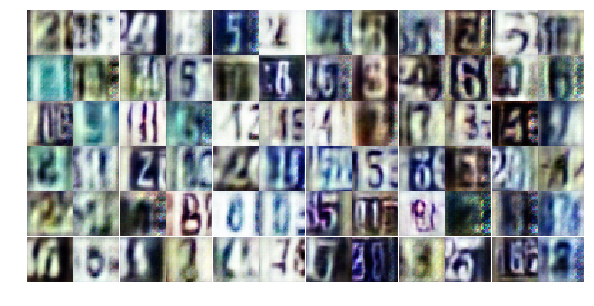

Epoch 17/25... Discriminator Loss: 0.7558... Generator Loss: 1.5249
Epoch 17/25... Discriminator Loss: 1.0766... Generator Loss: 0.6555
Epoch 17/25... Discriminator Loss: 0.6472... Generator Loss: 1.1369
Epoch 17/25... Discriminator Loss: 0.7394... Generator Loss: 1.0557
Epoch 18/25... Discriminator Loss: 1.1942... Generator Loss: 0.5676
Epoch 18/25... Discriminator Loss: 1.0856... Generator Loss: 0.6076
Epoch 18/25... Discriminator Loss: 0.6977... Generator Loss: 1.1511
Epoch 18/25... Discriminator Loss: 0.7560... Generator Loss: 0.8936
Epoch 18/25... Discriminator Loss: 0.9461... Generator Loss: 0.6465
Epoch 18/25... Discriminator Loss: 0.7187... Generator Loss: 1.1092


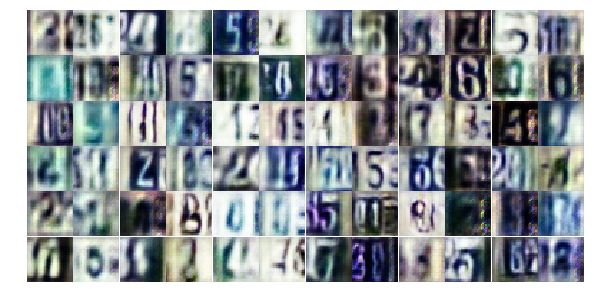

Epoch 18/25... Discriminator Loss: 0.3734... Generator Loss: 1.9132
Epoch 18/25... Discriminator Loss: 1.4836... Generator Loss: 0.4028
Epoch 18/25... Discriminator Loss: 0.7098... Generator Loss: 1.0020
Epoch 18/25... Discriminator Loss: 0.3396... Generator Loss: 1.9534
Epoch 18/25... Discriminator Loss: 0.7288... Generator Loss: 0.9501
Epoch 18/25... Discriminator Loss: 1.2639... Generator Loss: 0.6038
Epoch 18/25... Discriminator Loss: 0.6101... Generator Loss: 1.0569
Epoch 18/25... Discriminator Loss: 0.7758... Generator Loss: 0.9532
Epoch 18/25... Discriminator Loss: 0.6552... Generator Loss: 1.1642
Epoch 18/25... Discriminator Loss: 0.6429... Generator Loss: 1.0604


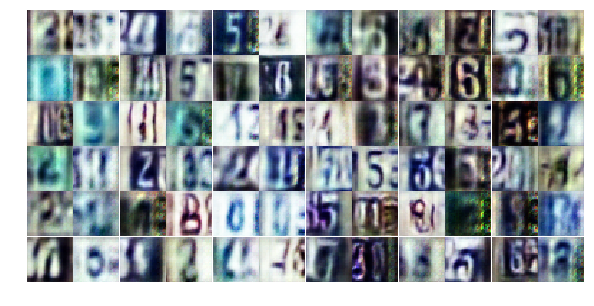

Epoch 18/25... Discriminator Loss: 0.8156... Generator Loss: 0.9876
Epoch 18/25... Discriminator Loss: 0.9481... Generator Loss: 0.7320
Epoch 18/25... Discriminator Loss: 1.0151... Generator Loss: 0.6831
Epoch 18/25... Discriminator Loss: 0.6722... Generator Loss: 1.1051
Epoch 18/25... Discriminator Loss: 1.2634... Generator Loss: 0.4595
Epoch 18/25... Discriminator Loss: 1.4737... Generator Loss: 0.4010
Epoch 18/25... Discriminator Loss: 0.5226... Generator Loss: 1.6466
Epoch 18/25... Discriminator Loss: 0.9794... Generator Loss: 0.6864
Epoch 18/25... Discriminator Loss: 1.1296... Generator Loss: 0.6210
Epoch 18/25... Discriminator Loss: 0.8195... Generator Loss: 0.9618


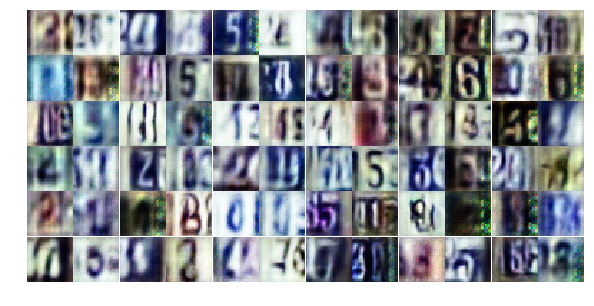

Epoch 18/25... Discriminator Loss: 0.4490... Generator Loss: 1.4906
Epoch 18/25... Discriminator Loss: 0.7457... Generator Loss: 1.4248
Epoch 18/25... Discriminator Loss: 0.6719... Generator Loss: 1.0917
Epoch 18/25... Discriminator Loss: 1.4279... Generator Loss: 0.4825
Epoch 18/25... Discriminator Loss: 1.1294... Generator Loss: 0.5635
Epoch 18/25... Discriminator Loss: 0.7204... Generator Loss: 0.9396
Epoch 18/25... Discriminator Loss: 0.6782... Generator Loss: 1.0799
Epoch 18/25... Discriminator Loss: 0.3757... Generator Loss: 1.8854
Epoch 18/25... Discriminator Loss: 0.4563... Generator Loss: 1.4505
Epoch 18/25... Discriminator Loss: 1.4758... Generator Loss: 0.3852


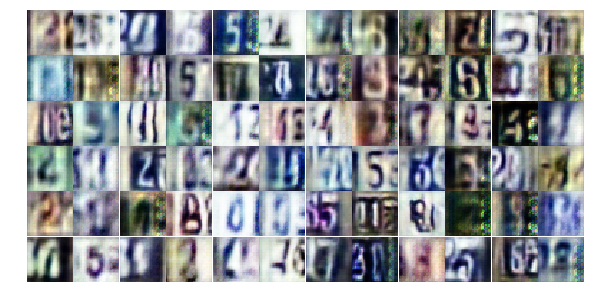

Epoch 18/25... Discriminator Loss: 0.5145... Generator Loss: 1.2701
Epoch 18/25... Discriminator Loss: 0.7882... Generator Loss: 0.9101
Epoch 18/25... Discriminator Loss: 0.6365... Generator Loss: 1.0660
Epoch 18/25... Discriminator Loss: 0.8273... Generator Loss: 0.9209
Epoch 18/25... Discriminator Loss: 1.4314... Generator Loss: 0.4277
Epoch 18/25... Discriminator Loss: 0.6334... Generator Loss: 1.1015
Epoch 18/25... Discriminator Loss: 1.2523... Generator Loss: 0.5277
Epoch 18/25... Discriminator Loss: 1.5581... Generator Loss: 2.4381
Epoch 18/25... Discriminator Loss: 0.5721... Generator Loss: 1.4876
Epoch 18/25... Discriminator Loss: 0.5742... Generator Loss: 1.3730


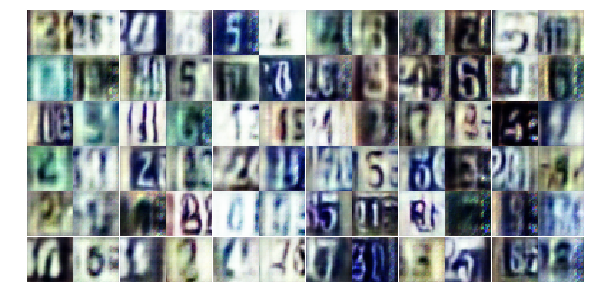

Epoch 18/25... Discriminator Loss: 0.6320... Generator Loss: 1.1226
Epoch 18/25... Discriminator Loss: 0.6726... Generator Loss: 1.2244
Epoch 18/25... Discriminator Loss: 1.0483... Generator Loss: 0.6815
Epoch 18/25... Discriminator Loss: 1.1672... Generator Loss: 0.5138
Epoch 18/25... Discriminator Loss: 1.3881... Generator Loss: 0.4486
Epoch 18/25... Discriminator Loss: 0.8153... Generator Loss: 2.8266
Epoch 18/25... Discriminator Loss: 0.6386... Generator Loss: 1.1570
Epoch 18/25... Discriminator Loss: 0.6150... Generator Loss: 1.0784
Epoch 18/25... Discriminator Loss: 0.8011... Generator Loss: 1.1756
Epoch 18/25... Discriminator Loss: 0.9978... Generator Loss: 0.6821


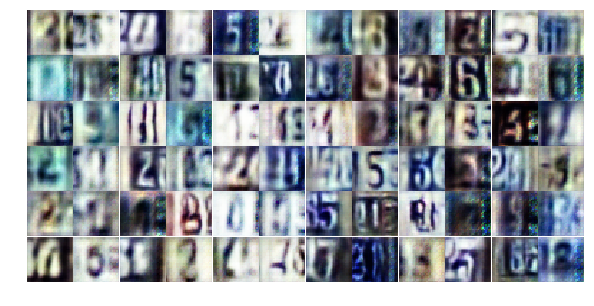

Epoch 18/25... Discriminator Loss: 0.7648... Generator Loss: 2.2775
Epoch 19/25... Discriminator Loss: 1.3614... Generator Loss: 0.4164
Epoch 19/25... Discriminator Loss: 1.1694... Generator Loss: 0.6495
Epoch 19/25... Discriminator Loss: 0.9027... Generator Loss: 0.9877
Epoch 19/25... Discriminator Loss: 0.4740... Generator Loss: 1.4252
Epoch 19/25... Discriminator Loss: 1.1628... Generator Loss: 0.5856
Epoch 19/25... Discriminator Loss: 0.4765... Generator Loss: 1.4289
Epoch 19/25... Discriminator Loss: 0.5106... Generator Loss: 2.2124
Epoch 19/25... Discriminator Loss: 1.4054... Generator Loss: 0.4109
Epoch 19/25... Discriminator Loss: 0.9044... Generator Loss: 0.7815


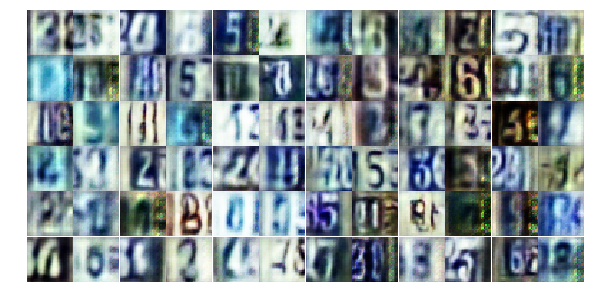

Epoch 19/25... Discriminator Loss: 0.7889... Generator Loss: 0.8463
Epoch 19/25... Discriminator Loss: 0.3492... Generator Loss: 1.6931
Epoch 19/25... Discriminator Loss: 0.9308... Generator Loss: 0.7655
Epoch 19/25... Discriminator Loss: 0.7177... Generator Loss: 0.9525
Epoch 19/25... Discriminator Loss: 0.7508... Generator Loss: 0.9500
Epoch 19/25... Discriminator Loss: 1.4629... Generator Loss: 3.5876
Epoch 19/25... Discriminator Loss: 1.6113... Generator Loss: 0.3495
Epoch 19/25... Discriminator Loss: 0.7315... Generator Loss: 1.0954
Epoch 19/25... Discriminator Loss: 0.8912... Generator Loss: 0.9526
Epoch 19/25... Discriminator Loss: 0.7323... Generator Loss: 0.9703


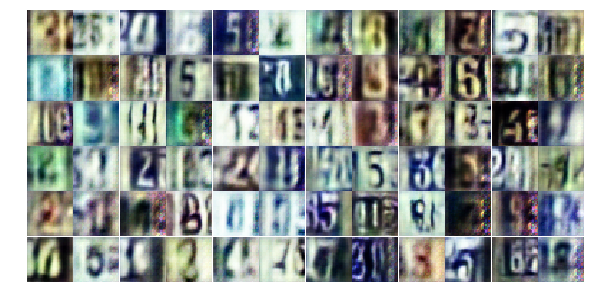

Epoch 19/25... Discriminator Loss: 1.3638... Generator Loss: 0.5019
Epoch 19/25... Discriminator Loss: 1.0329... Generator Loss: 0.6587
Epoch 19/25... Discriminator Loss: 1.8870... Generator Loss: 0.2675
Epoch 19/25... Discriminator Loss: 0.7534... Generator Loss: 1.0495
Epoch 19/25... Discriminator Loss: 8.3109... Generator Loss: 8.3044
Epoch 19/25... Discriminator Loss: 2.2850... Generator Loss: 1.4584
Epoch 19/25... Discriminator Loss: 1.5642... Generator Loss: 1.9371
Epoch 19/25... Discriminator Loss: 0.9835... Generator Loss: 0.7321
Epoch 19/25... Discriminator Loss: 0.6106... Generator Loss: 1.1802
Epoch 19/25... Discriminator Loss: 1.6133... Generator Loss: 0.4575


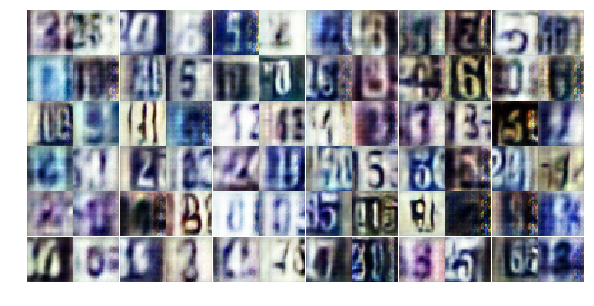

Epoch 19/25... Discriminator Loss: 0.6699... Generator Loss: 1.1682
Epoch 19/25... Discriminator Loss: 0.9055... Generator Loss: 0.8036
Epoch 19/25... Discriminator Loss: 1.2521... Generator Loss: 0.4694
Epoch 19/25... Discriminator Loss: 0.6044... Generator Loss: 1.1594
Epoch 19/25... Discriminator Loss: 0.7252... Generator Loss: 0.9780
Epoch 19/25... Discriminator Loss: 1.1238... Generator Loss: 0.5383
Epoch 19/25... Discriminator Loss: 0.7153... Generator Loss: 1.2352
Epoch 19/25... Discriminator Loss: 0.4127... Generator Loss: 1.7417
Epoch 19/25... Discriminator Loss: 0.8544... Generator Loss: 0.8222
Epoch 19/25... Discriminator Loss: 0.7125... Generator Loss: 0.9729


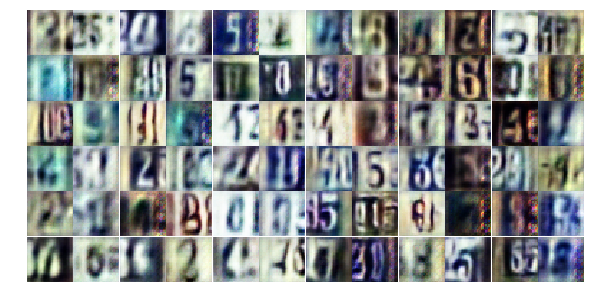

Epoch 19/25... Discriminator Loss: 0.5008... Generator Loss: 1.2328
Epoch 19/25... Discriminator Loss: 0.9116... Generator Loss: 0.7414
Epoch 19/25... Discriminator Loss: 1.0328... Generator Loss: 0.6177
Epoch 19/25... Discriminator Loss: 0.5025... Generator Loss: 1.4044
Epoch 19/25... Discriminator Loss: 0.7034... Generator Loss: 1.0648
Epoch 19/25... Discriminator Loss: 0.6191... Generator Loss: 1.0319
Epoch 19/25... Discriminator Loss: 0.6423... Generator Loss: 1.2381
Epoch 19/25... Discriminator Loss: 0.3942... Generator Loss: 1.5847
Epoch 19/25... Discriminator Loss: 0.4108... Generator Loss: 2.1435
Epoch 19/25... Discriminator Loss: 1.0579... Generator Loss: 0.6562


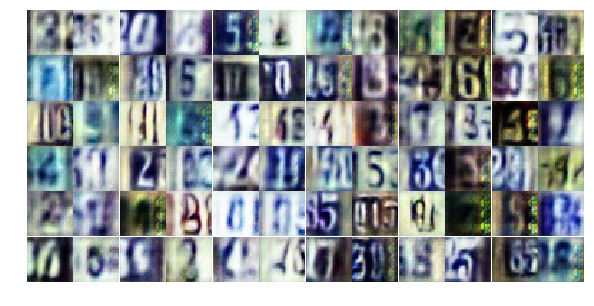

Epoch 19/25... Discriminator Loss: 0.6103... Generator Loss: 1.1440
Epoch 19/25... Discriminator Loss: 0.7610... Generator Loss: 0.9501
Epoch 19/25... Discriminator Loss: 0.4980... Generator Loss: 2.7277
Epoch 19/25... Discriminator Loss: 0.7278... Generator Loss: 1.0962
Epoch 19/25... Discriminator Loss: 0.6029... Generator Loss: 1.4563
Epoch 19/25... Discriminator Loss: 0.7393... Generator Loss: 1.0075
Epoch 19/25... Discriminator Loss: 1.4116... Generator Loss: 0.4653
Epoch 19/25... Discriminator Loss: 0.5270... Generator Loss: 1.4801
Epoch 20/25... Discriminator Loss: 0.6523... Generator Loss: 1.0758
Epoch 20/25... Discriminator Loss: 0.8183... Generator Loss: 0.8534


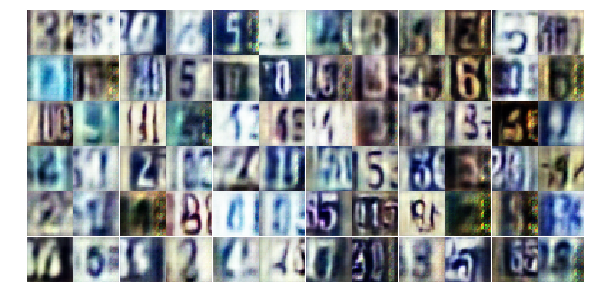

Epoch 20/25... Discriminator Loss: 0.5647... Generator Loss: 1.2656
Epoch 20/25... Discriminator Loss: 0.9166... Generator Loss: 0.8674
Epoch 20/25... Discriminator Loss: 1.4509... Generator Loss: 0.4271
Epoch 20/25... Discriminator Loss: 0.9220... Generator Loss: 0.7241
Epoch 20/25... Discriminator Loss: 0.5858... Generator Loss: 1.1940
Epoch 20/25... Discriminator Loss: 0.7104... Generator Loss: 0.9900
Epoch 20/25... Discriminator Loss: 0.8366... Generator Loss: 0.8057
Epoch 20/25... Discriminator Loss: 0.7662... Generator Loss: 1.1890
Epoch 20/25... Discriminator Loss: 0.6773... Generator Loss: 1.0923
Epoch 20/25... Discriminator Loss: 0.7226... Generator Loss: 0.8906


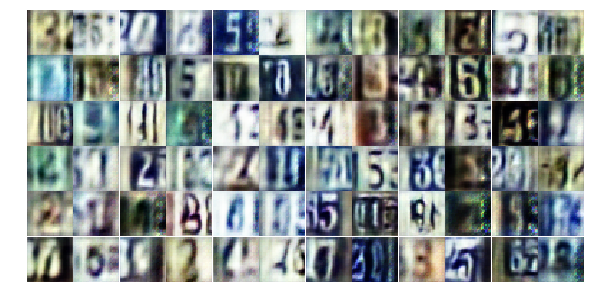

Epoch 20/25... Discriminator Loss: 1.6400... Generator Loss: 0.4268
Epoch 20/25... Discriminator Loss: 1.0715... Generator Loss: 0.6748
Epoch 20/25... Discriminator Loss: 0.8166... Generator Loss: 0.9035
Epoch 20/25... Discriminator Loss: 1.0181... Generator Loss: 0.6836
Epoch 20/25... Discriminator Loss: 1.9564... Generator Loss: 0.6398
Epoch 20/25... Discriminator Loss: 0.8609... Generator Loss: 0.7734
Epoch 20/25... Discriminator Loss: 1.1301... Generator Loss: 0.5639
Epoch 20/25... Discriminator Loss: 0.6462... Generator Loss: 1.2848
Epoch 20/25... Discriminator Loss: 0.6674... Generator Loss: 1.1253
Epoch 20/25... Discriminator Loss: 1.5346... Generator Loss: 0.4204


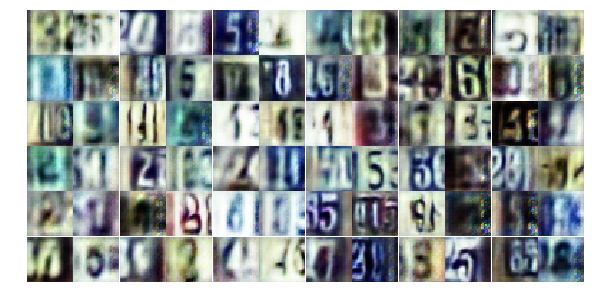

Epoch 20/25... Discriminator Loss: 0.4687... Generator Loss: 1.4445
Epoch 20/25... Discriminator Loss: 0.4794... Generator Loss: 1.4023
Epoch 20/25... Discriminator Loss: 0.4141... Generator Loss: 3.1228
Epoch 20/25... Discriminator Loss: 1.6852... Generator Loss: 0.3437
Epoch 20/25... Discriminator Loss: 1.0492... Generator Loss: 0.7259
Epoch 20/25... Discriminator Loss: 0.6093... Generator Loss: 1.0849
Epoch 20/25... Discriminator Loss: 0.6551... Generator Loss: 2.0736
Epoch 20/25... Discriminator Loss: 1.9821... Generator Loss: 0.2886
Epoch 20/25... Discriminator Loss: 1.0226... Generator Loss: 0.9251
Epoch 20/25... Discriminator Loss: 0.5600... Generator Loss: 1.1999


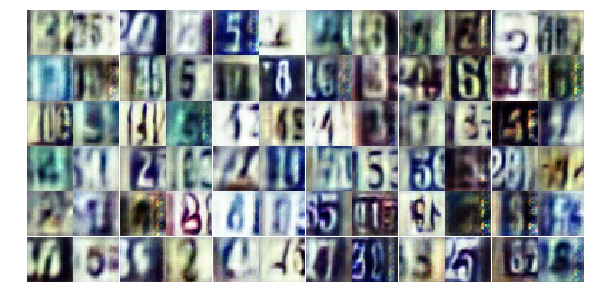

Epoch 20/25... Discriminator Loss: 0.7129... Generator Loss: 1.2334
Epoch 20/25... Discriminator Loss: 0.4748... Generator Loss: 1.3512
Epoch 20/25... Discriminator Loss: 1.2314... Generator Loss: 0.5576
Epoch 20/25... Discriminator Loss: 0.6919... Generator Loss: 1.0362
Epoch 20/25... Discriminator Loss: 1.2848... Generator Loss: 0.5204
Epoch 20/25... Discriminator Loss: 0.4726... Generator Loss: 1.5504
Epoch 20/25... Discriminator Loss: 0.9500... Generator Loss: 0.7179
Epoch 20/25... Discriminator Loss: 0.6792... Generator Loss: 1.1367
Epoch 20/25... Discriminator Loss: 1.1214... Generator Loss: 0.6013
Epoch 20/25... Discriminator Loss: 1.6980... Generator Loss: 0.3017


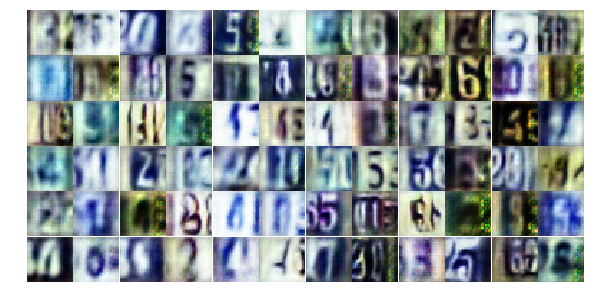

Epoch 20/25... Discriminator Loss: 1.7095... Generator Loss: 0.3018
Epoch 20/25... Discriminator Loss: 1.1545... Generator Loss: 0.6217
Epoch 20/25... Discriminator Loss: 0.5214... Generator Loss: 2.1602
Epoch 20/25... Discriminator Loss: 1.6991... Generator Loss: 0.3444
Epoch 20/25... Discriminator Loss: 0.7732... Generator Loss: 1.0997
Epoch 20/25... Discriminator Loss: 1.0401... Generator Loss: 0.6273
Epoch 20/25... Discriminator Loss: 1.1517... Generator Loss: 0.5283
Epoch 20/25... Discriminator Loss: 0.6066... Generator Loss: 1.0603
Epoch 20/25... Discriminator Loss: 0.6522... Generator Loss: 1.0626
Epoch 20/25... Discriminator Loss: 0.6477... Generator Loss: 1.0643


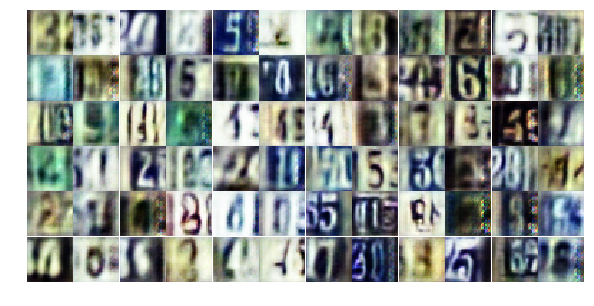

Epoch 20/25... Discriminator Loss: 0.5054... Generator Loss: 1.9220
Epoch 20/25... Discriminator Loss: 0.6667... Generator Loss: 1.9293
Epoch 20/25... Discriminator Loss: 0.4822... Generator Loss: 2.3066
Epoch 20/25... Discriminator Loss: 0.9531... Generator Loss: 0.7600
Epoch 20/25... Discriminator Loss: 0.8611... Generator Loss: 0.8091
Epoch 20/25... Discriminator Loss: 0.5303... Generator Loss: 1.3410
Epoch 21/25... Discriminator Loss: 0.8375... Generator Loss: 0.8660
Epoch 21/25... Discriminator Loss: 1.4534... Generator Loss: 0.3868
Epoch 21/25... Discriminator Loss: 1.1289... Generator Loss: 0.6802
Epoch 21/25... Discriminator Loss: 1.4857... Generator Loss: 0.3669


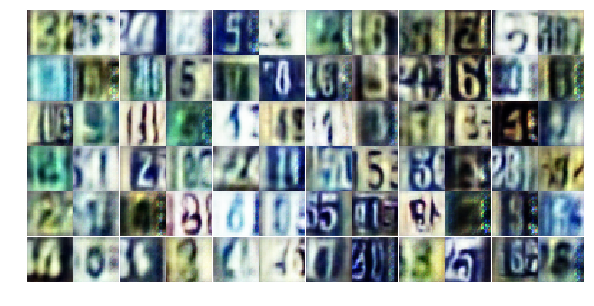

Epoch 21/25... Discriminator Loss: 0.7844... Generator Loss: 0.9570
Epoch 21/25... Discriminator Loss: 1.8493... Generator Loss: 0.3313
Epoch 21/25... Discriminator Loss: 0.5287... Generator Loss: 1.2558
Epoch 21/25... Discriminator Loss: 0.3476... Generator Loss: 1.7499
Epoch 21/25... Discriminator Loss: 0.7492... Generator Loss: 0.9854
Epoch 21/25... Discriminator Loss: 0.6930... Generator Loss: 0.9645
Epoch 21/25... Discriminator Loss: 0.7404... Generator Loss: 0.8910
Epoch 21/25... Discriminator Loss: 0.5657... Generator Loss: 1.2881
Epoch 21/25... Discriminator Loss: 0.7947... Generator Loss: 0.9385
Epoch 21/25... Discriminator Loss: 1.5226... Generator Loss: 0.3588


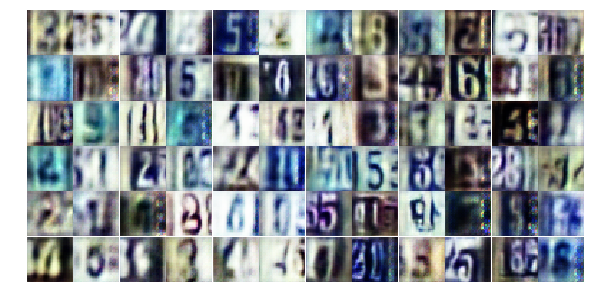

Epoch 21/25... Discriminator Loss: 0.4233... Generator Loss: 1.5330
Epoch 21/25... Discriminator Loss: 0.8572... Generator Loss: 0.8399
Epoch 21/25... Discriminator Loss: 2.0988... Generator Loss: 0.2914
Epoch 21/25... Discriminator Loss: 0.6805... Generator Loss: 1.4742
Epoch 21/25... Discriminator Loss: 0.5628... Generator Loss: 1.2756
Epoch 21/25... Discriminator Loss: 1.3673... Generator Loss: 0.5026
Epoch 21/25... Discriminator Loss: 0.7774... Generator Loss: 0.9881
Epoch 21/25... Discriminator Loss: 0.4033... Generator Loss: 1.6087
Epoch 21/25... Discriminator Loss: 0.8848... Generator Loss: 4.6309
Epoch 21/25... Discriminator Loss: 0.9701... Generator Loss: 0.8982


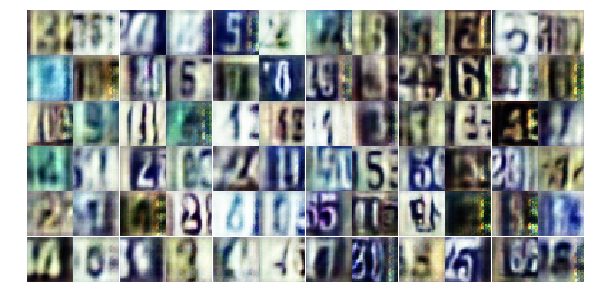

Epoch 21/25... Discriminator Loss: 0.8023... Generator Loss: 0.8944
Epoch 21/25... Discriminator Loss: 0.3706... Generator Loss: 1.6006
Epoch 21/25... Discriminator Loss: 1.1071... Generator Loss: 0.5687
Epoch 21/25... Discriminator Loss: 0.8308... Generator Loss: 0.8702
Epoch 21/25... Discriminator Loss: 0.6860... Generator Loss: 1.0987
Epoch 21/25... Discriminator Loss: 1.2997... Generator Loss: 0.4736
Epoch 21/25... Discriminator Loss: 0.5984... Generator Loss: 1.2116
Epoch 21/25... Discriminator Loss: 0.7502... Generator Loss: 0.9952
Epoch 21/25... Discriminator Loss: 1.0752... Generator Loss: 0.6050
Epoch 21/25... Discriminator Loss: 0.8265... Generator Loss: 0.8960


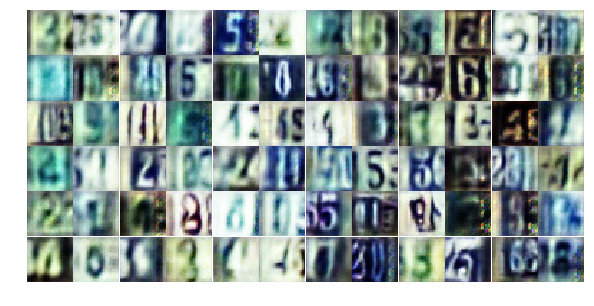

Epoch 21/25... Discriminator Loss: 1.2907... Generator Loss: 0.5956
Epoch 21/25... Discriminator Loss: 0.9235... Generator Loss: 0.7772
Epoch 21/25... Discriminator Loss: 1.2894... Generator Loss: 0.4619
Epoch 21/25... Discriminator Loss: 0.6408... Generator Loss: 1.1132
Epoch 21/25... Discriminator Loss: 0.4935... Generator Loss: 1.3367
Epoch 21/25... Discriminator Loss: 1.2135... Generator Loss: 0.5086
Epoch 21/25... Discriminator Loss: 1.4006... Generator Loss: 0.4315
Epoch 21/25... Discriminator Loss: 2.6726... Generator Loss: 0.1240
Epoch 21/25... Discriminator Loss: 1.0232... Generator Loss: 0.6528
Epoch 21/25... Discriminator Loss: 0.1923... Generator Loss: 3.3886


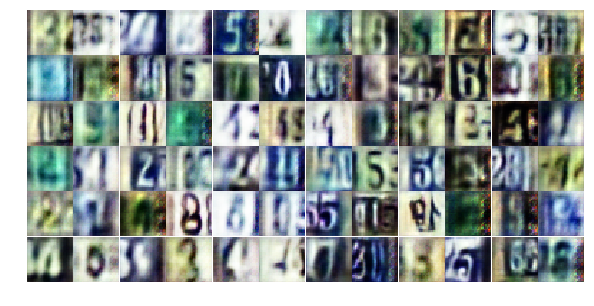

Epoch 21/25... Discriminator Loss: 1.2198... Generator Loss: 0.5132
Epoch 21/25... Discriminator Loss: 0.9221... Generator Loss: 0.7595
Epoch 21/25... Discriminator Loss: 0.5533... Generator Loss: 1.4110
Epoch 21/25... Discriminator Loss: 0.9557... Generator Loss: 0.7044
Epoch 21/25... Discriminator Loss: 0.3608... Generator Loss: 1.5489
Epoch 21/25... Discriminator Loss: 0.5655... Generator Loss: 1.6895
Epoch 21/25... Discriminator Loss: 1.0410... Generator Loss: 0.6519
Epoch 21/25... Discriminator Loss: 0.7671... Generator Loss: 1.1566
Epoch 21/25... Discriminator Loss: 1.1949... Generator Loss: 0.6304
Epoch 21/25... Discriminator Loss: 0.9349... Generator Loss: 0.7231


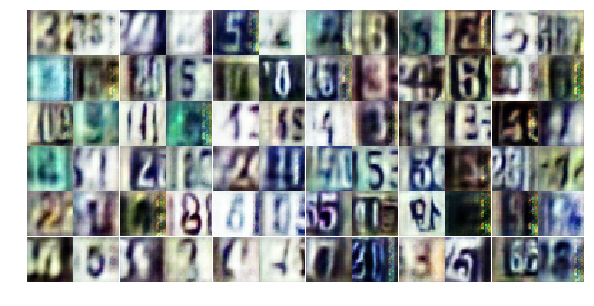

Epoch 21/25... Discriminator Loss: 0.4703... Generator Loss: 2.0676
Epoch 21/25... Discriminator Loss: 0.7998... Generator Loss: 0.8619
Epoch 21/25... Discriminator Loss: 0.7942... Generator Loss: 1.0293
Epoch 22/25... Discriminator Loss: 0.5779... Generator Loss: 1.4685
Epoch 22/25... Discriminator Loss: 0.7811... Generator Loss: 1.0932
Epoch 22/25... Discriminator Loss: 0.8429... Generator Loss: 0.8169
Epoch 22/25... Discriminator Loss: 0.8467... Generator Loss: 0.7739
Epoch 22/25... Discriminator Loss: 0.4336... Generator Loss: 1.3770
Epoch 22/25... Discriminator Loss: 0.7563... Generator Loss: 0.9205
Epoch 22/25... Discriminator Loss: 0.8675... Generator Loss: 0.8362


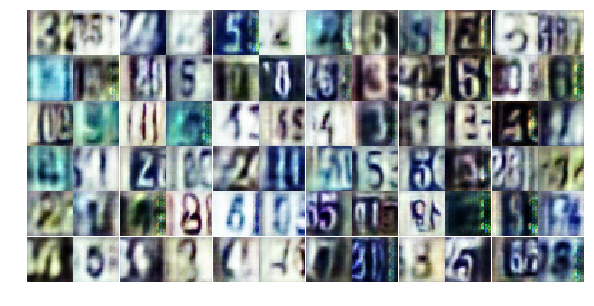

Epoch 22/25... Discriminator Loss: 0.6780... Generator Loss: 1.4062
Epoch 22/25... Discriminator Loss: 0.7968... Generator Loss: 1.0156
Epoch 22/25... Discriminator Loss: 1.1904... Generator Loss: 0.5967
Epoch 22/25... Discriminator Loss: 0.8674... Generator Loss: 0.8007
Epoch 22/25... Discriminator Loss: 0.7179... Generator Loss: 1.2884
Epoch 22/25... Discriminator Loss: 0.7633... Generator Loss: 0.8659
Epoch 22/25... Discriminator Loss: 0.7962... Generator Loss: 0.8469
Epoch 22/25... Discriminator Loss: 0.4642... Generator Loss: 1.6156
Epoch 22/25... Discriminator Loss: 1.1868... Generator Loss: 0.5786
Epoch 22/25... Discriminator Loss: 1.8208... Generator Loss: 0.2520


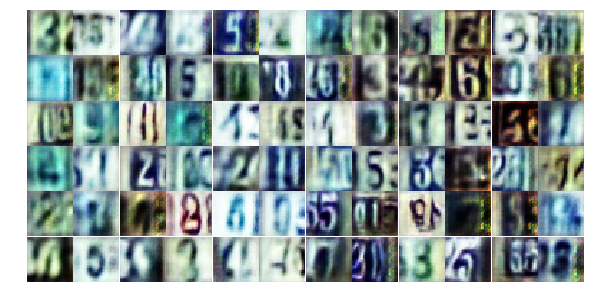

Epoch 22/25... Discriminator Loss: 0.3884... Generator Loss: 1.9865
Epoch 22/25... Discriminator Loss: 0.6685... Generator Loss: 1.0094
Epoch 22/25... Discriminator Loss: 0.9223... Generator Loss: 0.8125
Epoch 22/25... Discriminator Loss: 0.5162... Generator Loss: 1.3297
Epoch 22/25... Discriminator Loss: 0.4549... Generator Loss: 1.6395
Epoch 22/25... Discriminator Loss: 1.3917... Generator Loss: 0.4600
Epoch 22/25... Discriminator Loss: 0.5785... Generator Loss: 1.2367
Epoch 22/25... Discriminator Loss: 0.4384... Generator Loss: 1.7310
Epoch 22/25... Discriminator Loss: 0.5002... Generator Loss: 1.4324
Epoch 22/25... Discriminator Loss: 0.7630... Generator Loss: 1.1519


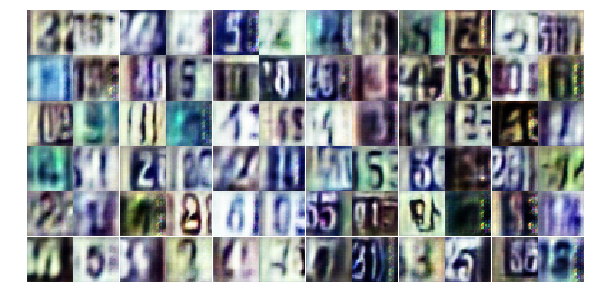

Epoch 22/25... Discriminator Loss: 0.4383... Generator Loss: 1.5102
Epoch 22/25... Discriminator Loss: 0.6711... Generator Loss: 1.1107
Epoch 22/25... Discriminator Loss: 1.3117... Generator Loss: 3.9402
Epoch 22/25... Discriminator Loss: 0.6550... Generator Loss: 1.1821
Epoch 22/25... Discriminator Loss: 0.6525... Generator Loss: 1.2214
Epoch 22/25... Discriminator Loss: 1.3338... Generator Loss: 0.4697
Epoch 22/25... Discriminator Loss: 1.1668... Generator Loss: 0.5264
Epoch 22/25... Discriminator Loss: 0.7336... Generator Loss: 2.2333
Epoch 22/25... Discriminator Loss: 0.7897... Generator Loss: 0.9597
Epoch 22/25... Discriminator Loss: 1.3882... Generator Loss: 0.4436


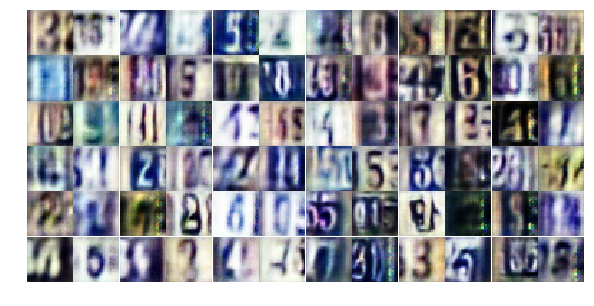

Epoch 22/25... Discriminator Loss: 0.6990... Generator Loss: 1.5921
Epoch 22/25... Discriminator Loss: 0.5038... Generator Loss: 1.2822
Epoch 22/25... Discriminator Loss: 0.4545... Generator Loss: 1.3447
Epoch 22/25... Discriminator Loss: 0.9904... Generator Loss: 0.7540
Epoch 22/25... Discriminator Loss: 0.4871... Generator Loss: 1.5163
Epoch 22/25... Discriminator Loss: 0.3900... Generator Loss: 1.4722
Epoch 22/25... Discriminator Loss: 0.5077... Generator Loss: 1.5088
Epoch 22/25... Discriminator Loss: 0.7956... Generator Loss: 1.0575
Epoch 22/25... Discriminator Loss: 1.1828... Generator Loss: 0.6310
Epoch 22/25... Discriminator Loss: 0.6595... Generator Loss: 1.1043


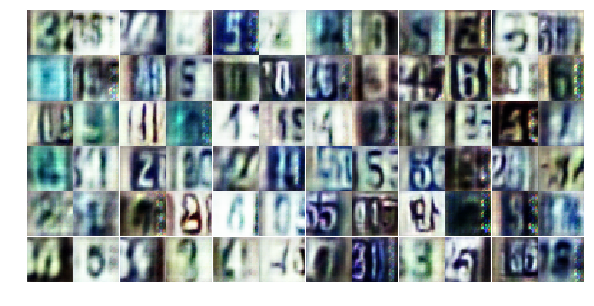

Epoch 22/25... Discriminator Loss: 1.5014... Generator Loss: 0.4438
Epoch 22/25... Discriminator Loss: 0.7536... Generator Loss: 0.9388
Epoch 22/25... Discriminator Loss: 1.1125... Generator Loss: 0.6040
Epoch 22/25... Discriminator Loss: 0.7323... Generator Loss: 1.0580
Epoch 22/25... Discriminator Loss: 0.4522... Generator Loss: 1.5912
Epoch 22/25... Discriminator Loss: 0.8283... Generator Loss: 0.9288
Epoch 22/25... Discriminator Loss: 1.9927... Generator Loss: 0.2039
Epoch 22/25... Discriminator Loss: 0.4780... Generator Loss: 1.4166
Epoch 22/25... Discriminator Loss: 1.6273... Generator Loss: 3.0401
Epoch 22/25... Discriminator Loss: 1.4270... Generator Loss: 0.4763


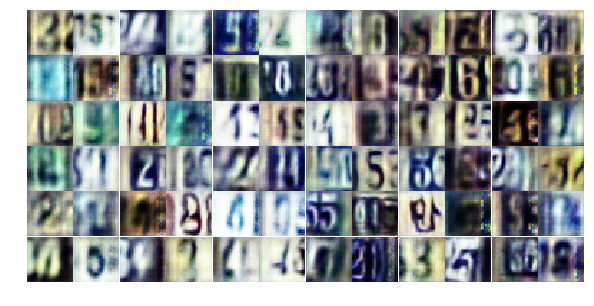

Epoch 23/25... Discriminator Loss: 0.6051... Generator Loss: 1.4258
Epoch 23/25... Discriminator Loss: 0.7189... Generator Loss: 1.0052
Epoch 23/25... Discriminator Loss: 1.1863... Generator Loss: 0.5977
Epoch 23/25... Discriminator Loss: 0.8193... Generator Loss: 1.0006
Epoch 23/25... Discriminator Loss: 1.0039... Generator Loss: 0.7170
Epoch 23/25... Discriminator Loss: 1.1651... Generator Loss: 0.6102
Epoch 23/25... Discriminator Loss: 1.0317... Generator Loss: 0.8346
Epoch 23/25... Discriminator Loss: 0.7182... Generator Loss: 1.1030
Epoch 23/25... Discriminator Loss: 0.8834... Generator Loss: 0.7727
Epoch 23/25... Discriminator Loss: 0.5066... Generator Loss: 1.3945


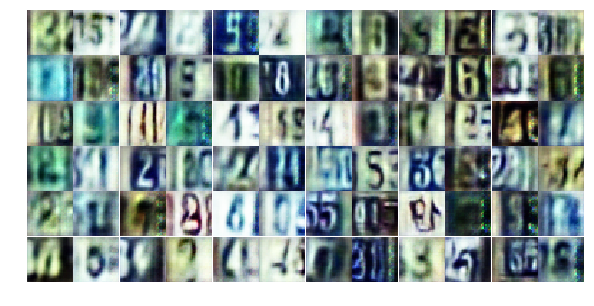

Epoch 23/25... Discriminator Loss: 0.5571... Generator Loss: 1.2799
Epoch 23/25... Discriminator Loss: 0.9230... Generator Loss: 0.7274
Epoch 23/25... Discriminator Loss: 0.7450... Generator Loss: 1.0355
Epoch 23/25... Discriminator Loss: 0.7105... Generator Loss: 1.0531
Epoch 23/25... Discriminator Loss: 0.3690... Generator Loss: 1.8605
Epoch 23/25... Discriminator Loss: 1.0417... Generator Loss: 0.7013
Epoch 23/25... Discriminator Loss: 0.8441... Generator Loss: 0.9498
Epoch 23/25... Discriminator Loss: 0.8674... Generator Loss: 0.8681
Epoch 23/25... Discriminator Loss: 0.6640... Generator Loss: 1.0687
Epoch 23/25... Discriminator Loss: 0.6839... Generator Loss: 1.1319


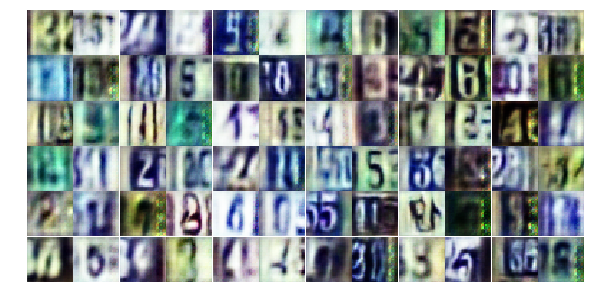

Epoch 23/25... Discriminator Loss: 0.8561... Generator Loss: 0.8554
Epoch 23/25... Discriminator Loss: 0.6905... Generator Loss: 1.0529
Epoch 23/25... Discriminator Loss: 1.8984... Generator Loss: 0.2812
Epoch 23/25... Discriminator Loss: 0.8484... Generator Loss: 0.8143
Epoch 23/25... Discriminator Loss: 0.5258... Generator Loss: 1.3660
Epoch 23/25... Discriminator Loss: 0.6517... Generator Loss: 2.6611
Epoch 23/25... Discriminator Loss: 0.7401... Generator Loss: 0.9508
Epoch 23/25... Discriminator Loss: 1.1150... Generator Loss: 0.7357
Epoch 23/25... Discriminator Loss: 0.4089... Generator Loss: 1.6992
Epoch 23/25... Discriminator Loss: 0.7865... Generator Loss: 2.0157


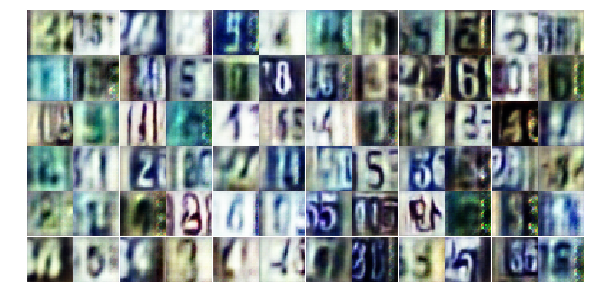

Epoch 23/25... Discriminator Loss: 0.7706... Generator Loss: 0.8899
Epoch 23/25... Discriminator Loss: 1.0376... Generator Loss: 0.6911
Epoch 23/25... Discriminator Loss: 0.8861... Generator Loss: 0.8022
Epoch 23/25... Discriminator Loss: 0.8617... Generator Loss: 0.8334
Epoch 23/25... Discriminator Loss: 0.5416... Generator Loss: 2.6855
Epoch 23/25... Discriminator Loss: 1.0049... Generator Loss: 0.7322
Epoch 23/25... Discriminator Loss: 0.8590... Generator Loss: 1.6103
Epoch 23/25... Discriminator Loss: 0.8759... Generator Loss: 0.8114
Epoch 23/25... Discriminator Loss: 0.2948... Generator Loss: 2.2478
Epoch 23/25... Discriminator Loss: 0.4159... Generator Loss: 1.7211


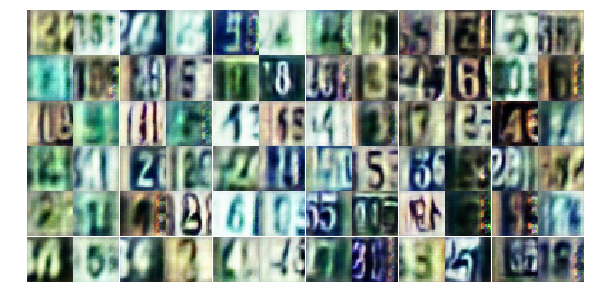

Epoch 23/25... Discriminator Loss: 0.8830... Generator Loss: 0.9224
Epoch 23/25... Discriminator Loss: 0.4199... Generator Loss: 1.7094
Epoch 23/25... Discriminator Loss: 1.1291... Generator Loss: 0.6137
Epoch 23/25... Discriminator Loss: 0.8191... Generator Loss: 0.9448
Epoch 23/25... Discriminator Loss: 1.2207... Generator Loss: 0.7061
Epoch 23/25... Discriminator Loss: 1.0864... Generator Loss: 0.6641
Epoch 23/25... Discriminator Loss: 0.7610... Generator Loss: 0.9775
Epoch 23/25... Discriminator Loss: 1.7456... Generator Loss: 0.2954
Epoch 23/25... Discriminator Loss: 0.4909... Generator Loss: 1.4388
Epoch 23/25... Discriminator Loss: 0.5870... Generator Loss: 1.5844


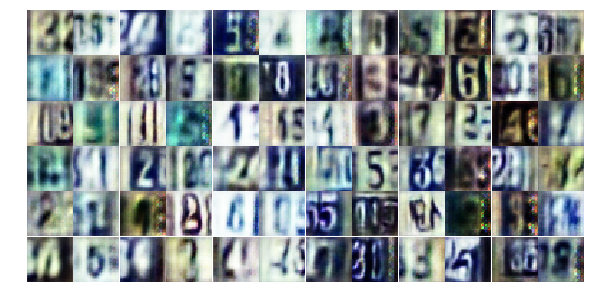

Epoch 23/25... Discriminator Loss: 0.7899... Generator Loss: 0.8569
Epoch 23/25... Discriminator Loss: 1.2062... Generator Loss: 0.6257
Epoch 23/25... Discriminator Loss: 0.8985... Generator Loss: 0.7608
Epoch 23/25... Discriminator Loss: 0.2988... Generator Loss: 1.8994
Epoch 23/25... Discriminator Loss: 1.9271... Generator Loss: 0.3013
Epoch 23/25... Discriminator Loss: 0.6403... Generator Loss: 1.3677
Epoch 23/25... Discriminator Loss: 0.8578... Generator Loss: 0.8815
Epoch 24/25... Discriminator Loss: 0.7914... Generator Loss: 0.8983
Epoch 24/25... Discriminator Loss: 1.0722... Generator Loss: 0.6347
Epoch 24/25... Discriminator Loss: 1.6590... Generator Loss: 0.3071


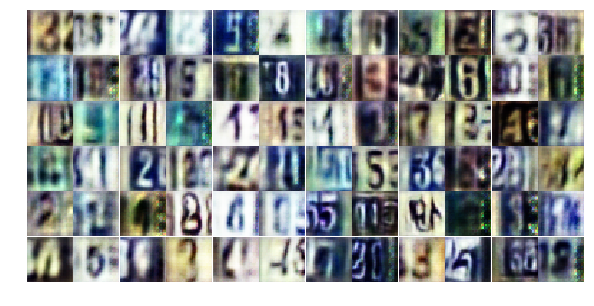

Epoch 24/25... Discriminator Loss: 0.5510... Generator Loss: 1.6147
Epoch 24/25... Discriminator Loss: 0.7183... Generator Loss: 0.9511
Epoch 24/25... Discriminator Loss: 1.0285... Generator Loss: 0.6430
Epoch 24/25... Discriminator Loss: 0.6867... Generator Loss: 2.0821
Epoch 24/25... Discriminator Loss: 0.8778... Generator Loss: 0.8585
Epoch 24/25... Discriminator Loss: 0.4980... Generator Loss: 1.4547
Epoch 24/25... Discriminator Loss: 0.8616... Generator Loss: 0.9280
Epoch 24/25... Discriminator Loss: 1.2247... Generator Loss: 0.5177
Epoch 24/25... Discriminator Loss: 0.6301... Generator Loss: 1.1748
Epoch 24/25... Discriminator Loss: 0.3927... Generator Loss: 1.8409


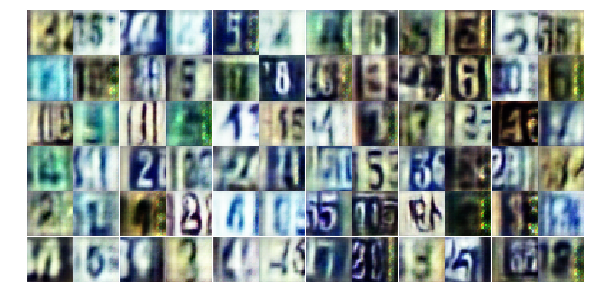

Epoch 24/25... Discriminator Loss: 1.1700... Generator Loss: 0.5637
Epoch 24/25... Discriminator Loss: 1.2107... Generator Loss: 0.4953
Epoch 24/25... Discriminator Loss: 1.3038... Generator Loss: 0.5785
Epoch 24/25... Discriminator Loss: 0.7401... Generator Loss: 0.8773
Epoch 24/25... Discriminator Loss: 0.4762... Generator Loss: 1.5490
Epoch 24/25... Discriminator Loss: 0.9941... Generator Loss: 0.7415
Epoch 24/25... Discriminator Loss: 0.6097... Generator Loss: 1.1702
Epoch 24/25... Discriminator Loss: 1.5484... Generator Loss: 0.3253
Epoch 24/25... Discriminator Loss: 0.5471... Generator Loss: 1.5797
Epoch 24/25... Discriminator Loss: 1.4908... Generator Loss: 0.4314


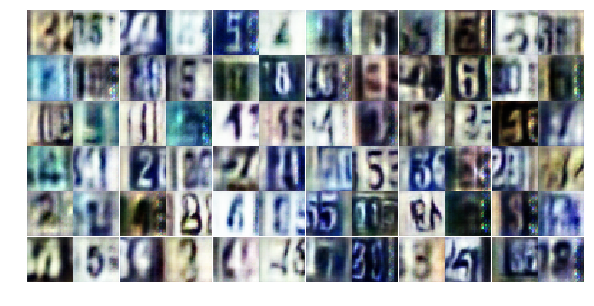

Epoch 24/25... Discriminator Loss: 0.5435... Generator Loss: 1.4624
Epoch 24/25... Discriminator Loss: 0.4312... Generator Loss: 1.4314
Epoch 24/25... Discriminator Loss: 0.4907... Generator Loss: 1.6108
Epoch 24/25... Discriminator Loss: 1.6796... Generator Loss: 0.3704
Epoch 24/25... Discriminator Loss: 0.4236... Generator Loss: 1.6047
Epoch 24/25... Discriminator Loss: 0.5247... Generator Loss: 1.5466
Epoch 24/25... Discriminator Loss: 0.6067... Generator Loss: 1.2318
Epoch 24/25... Discriminator Loss: 0.5778... Generator Loss: 1.2171
Epoch 24/25... Discriminator Loss: 1.0994... Generator Loss: 0.7576
Epoch 24/25... Discriminator Loss: 0.9449... Generator Loss: 0.7685


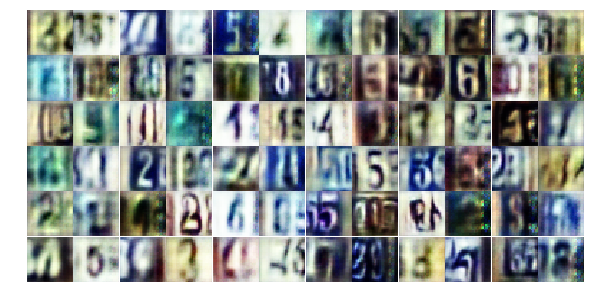

Epoch 24/25... Discriminator Loss: 0.7005... Generator Loss: 0.9360
Epoch 24/25... Discriminator Loss: 0.7156... Generator Loss: 0.9686
Epoch 24/25... Discriminator Loss: 0.7963... Generator Loss: 0.9107
Epoch 24/25... Discriminator Loss: 2.0789... Generator Loss: 0.2210
Epoch 24/25... Discriminator Loss: 1.1228... Generator Loss: 0.6427
Epoch 24/25... Discriminator Loss: 0.9205... Generator Loss: 0.7823
Epoch 24/25... Discriminator Loss: 0.8709... Generator Loss: 0.9437
Epoch 24/25... Discriminator Loss: 0.6009... Generator Loss: 1.2814
Epoch 24/25... Discriminator Loss: 1.0029... Generator Loss: 1.6476
Epoch 24/25... Discriminator Loss: 0.9110... Generator Loss: 3.2610


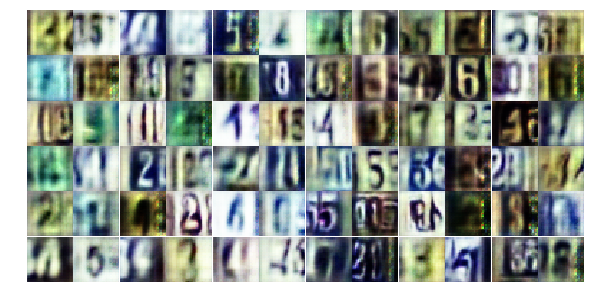

Epoch 24/25... Discriminator Loss: 0.7876... Generator Loss: 0.9483
Epoch 24/25... Discriminator Loss: 1.1699... Generator Loss: 0.6188
Epoch 24/25... Discriminator Loss: 1.2943... Generator Loss: 0.4987
Epoch 24/25... Discriminator Loss: 1.7809... Generator Loss: 0.2597
Epoch 24/25... Discriminator Loss: 1.0450... Generator Loss: 0.6576
Epoch 24/25... Discriminator Loss: 0.6778... Generator Loss: 1.0981
Epoch 24/25... Discriminator Loss: 1.1645... Generator Loss: 0.5183
Epoch 24/25... Discriminator Loss: 0.5516... Generator Loss: 1.1905
Epoch 24/25... Discriminator Loss: 0.7583... Generator Loss: 1.3005
Epoch 24/25... Discriminator Loss: 0.9746... Generator Loss: 0.8461


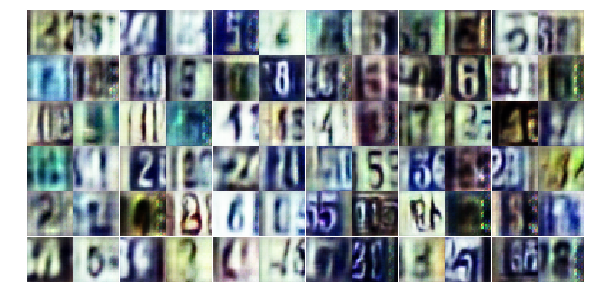

Epoch 24/25... Discriminator Loss: 1.5279... Generator Loss: 0.3977
Epoch 24/25... Discriminator Loss: 1.2020... Generator Loss: 0.4990
Epoch 24/25... Discriminator Loss: 0.7759... Generator Loss: 0.9805
Epoch 24/25... Discriminator Loss: 0.6443... Generator Loss: 1.1773
Epoch 24/25... Discriminator Loss: 1.1815... Generator Loss: 0.5806
Epoch 25/25... Discriminator Loss: 0.5288... Generator Loss: 1.4873
Epoch 25/25... Discriminator Loss: 0.4240... Generator Loss: 1.9041
Epoch 25/25... Discriminator Loss: 1.3756... Generator Loss: 0.4457
Epoch 25/25... Discriminator Loss: 0.7155... Generator Loss: 1.0561
Epoch 25/25... Discriminator Loss: 1.0980... Generator Loss: 0.6384


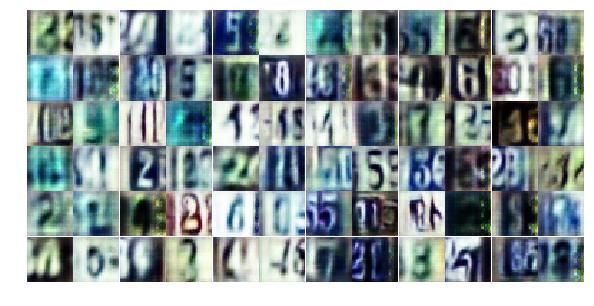

Epoch 25/25... Discriminator Loss: 1.1467... Generator Loss: 0.6445
Epoch 25/25... Discriminator Loss: 1.2271... Generator Loss: 0.5740
Epoch 25/25... Discriminator Loss: 0.6569... Generator Loss: 1.1090
Epoch 25/25... Discriminator Loss: 0.7798... Generator Loss: 0.9682
Epoch 25/25... Discriminator Loss: 1.3298... Generator Loss: 3.5253
Epoch 25/25... Discriminator Loss: 1.1303... Generator Loss: 0.5607
Epoch 25/25... Discriminator Loss: 0.5742... Generator Loss: 1.3124
Epoch 25/25... Discriminator Loss: 1.2467... Generator Loss: 0.7897
Epoch 25/25... Discriminator Loss: 0.6588... Generator Loss: 1.0125
Epoch 25/25... Discriminator Loss: 0.8653... Generator Loss: 0.8297


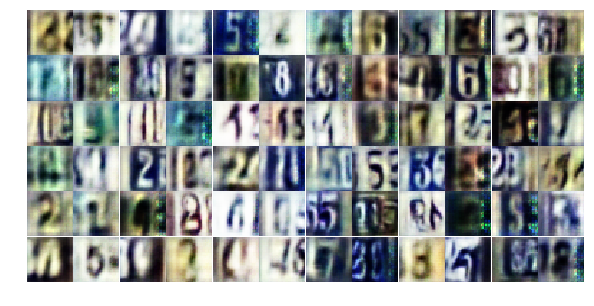

Epoch 25/25... Discriminator Loss: 0.5421... Generator Loss: 1.5418
Epoch 25/25... Discriminator Loss: 0.5421... Generator Loss: 1.2754
Epoch 25/25... Discriminator Loss: 0.5807... Generator Loss: 1.2460
Epoch 25/25... Discriminator Loss: 0.9937... Generator Loss: 0.7010
Epoch 25/25... Discriminator Loss: 0.7386... Generator Loss: 0.9312
Epoch 25/25... Discriminator Loss: 0.5074... Generator Loss: 1.8141
Epoch 25/25... Discriminator Loss: 1.2005... Generator Loss: 0.6062
Epoch 25/25... Discriminator Loss: 1.2282... Generator Loss: 0.5967
Epoch 25/25... Discriminator Loss: 0.6423... Generator Loss: 1.2026
Epoch 25/25... Discriminator Loss: 1.0479... Generator Loss: 0.6964


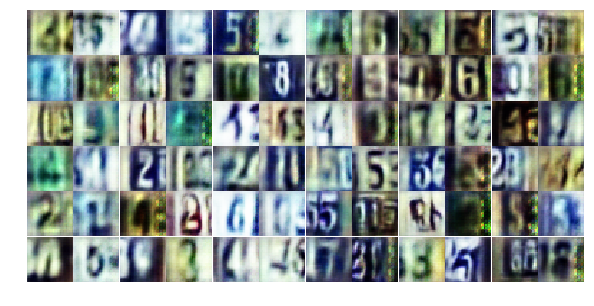

Epoch 25/25... Discriminator Loss: 1.5176... Generator Loss: 0.4730
Epoch 25/25... Discriminator Loss: 0.5699... Generator Loss: 1.4501
Epoch 25/25... Discriminator Loss: 1.2148... Generator Loss: 0.6768
Epoch 25/25... Discriminator Loss: 0.4859... Generator Loss: 1.6398
Epoch 25/25... Discriminator Loss: 0.4420... Generator Loss: 1.5393
Epoch 25/25... Discriminator Loss: 0.5991... Generator Loss: 1.1178
Epoch 25/25... Discriminator Loss: 1.1618... Generator Loss: 0.6259
Epoch 25/25... Discriminator Loss: 0.8553... Generator Loss: 0.8380
Epoch 25/25... Discriminator Loss: 1.1457... Generator Loss: 0.6799
Epoch 25/25... Discriminator Loss: 0.3510... Generator Loss: 1.6250


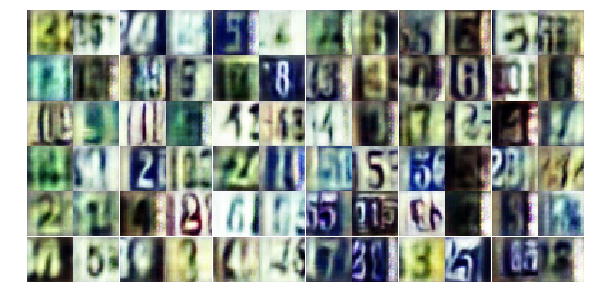

Epoch 25/25... Discriminator Loss: 0.7204... Generator Loss: 0.9920
Epoch 25/25... Discriminator Loss: 0.3393... Generator Loss: 1.8793
Epoch 25/25... Discriminator Loss: 0.6416... Generator Loss: 1.1874
Epoch 25/25... Discriminator Loss: 0.9737... Generator Loss: 0.7079
Epoch 25/25... Discriminator Loss: 1.9672... Generator Loss: 0.3492
Epoch 25/25... Discriminator Loss: 0.7322... Generator Loss: 1.0321
Epoch 25/25... Discriminator Loss: 0.6086... Generator Loss: 1.2181
Epoch 25/25... Discriminator Loss: 0.7746... Generator Loss: 0.9935
Epoch 25/25... Discriminator Loss: 1.8145... Generator Loss: 0.4058
Epoch 25/25... Discriminator Loss: 2.9683... Generator Loss: 2.0227


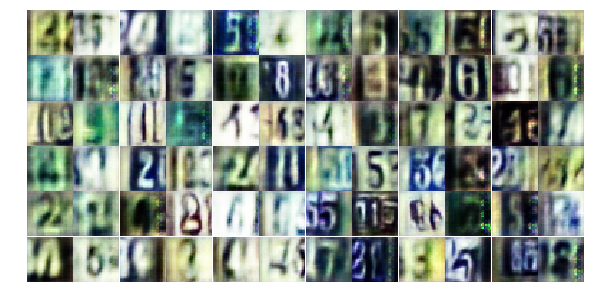

Epoch 25/25... Discriminator Loss: 4.5389... Generator Loss: 5.5965
Epoch 25/25... Discriminator Loss: 0.8087... Generator Loss: 1.4664
Epoch 25/25... Discriminator Loss: 0.6102... Generator Loss: 1.3412
Epoch 25/25... Discriminator Loss: 0.9162... Generator Loss: 0.8600
Epoch 25/25... Discriminator Loss: 1.3326... Generator Loss: 0.4682
Epoch 25/25... Discriminator Loss: 0.5311... Generator Loss: 1.3612
Epoch 25/25... Discriminator Loss: 1.4984... Generator Loss: 0.3677
Epoch 25/25... Discriminator Loss: 0.9712... Generator Loss: 0.7875
Epoch 25/25... Discriminator Loss: 0.5663... Generator Loss: 1.6454
Epoch 25/25... Discriminator Loss: 0.8981... Generator Loss: 0.8544


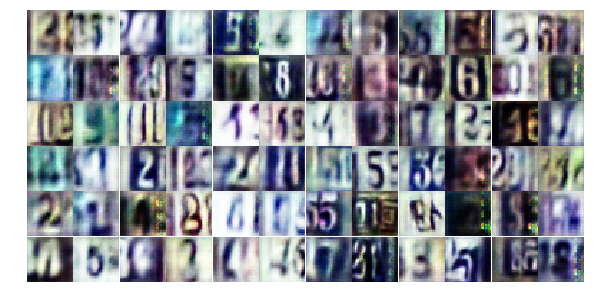

Epoch 25/25... Discriminator Loss: 0.4931... Generator Loss: 1.4902
Epoch 25/25... Discriminator Loss: 1.8410... Generator Loss: 0.2974


In [19]:
# Load the data and train the network here
dataset = Dataset(trainset, testset)
losses, samples = train(net, dataset, epochs, batch_size, figsize=(10,5))

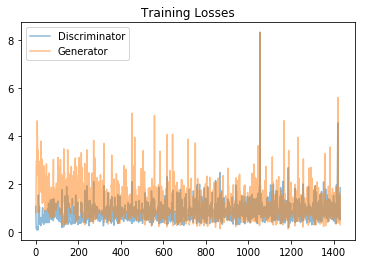

In [20]:
fig, ax = plt.subplots()
losses = np.array(losses)
plt.plot(losses.T[0], label='Discriminator', alpha=0.5)
plt.plot(losses.T[1], label='Generator', alpha=0.5)
plt.title("Training Losses")
plt.legend()

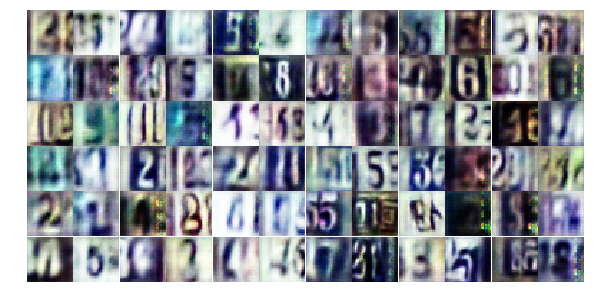

In [21]:
_ = view_samples(-1, samples, 6, 12, figsize=(10,5))